In [1]:
import healpy
from jax_healpy import pixelfunc as jhp
import numpy as np
import jax
import jax.numpy as jnp
import optax
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree
jax.config.update("jax_enable_x64", True)

JAX is not using 64-bit precision. This will dramatically affect numerical precision at even moderate L.


In [5]:
def rot_m(ang, vec):
    """Return 3x3 matrix defined by rotation by 'ang' around the
    axis 'vec', according to the right-hand rule.  Both can be vectors,
    returning a vector of rotation matrices.  Rotation matrix will have a
    scaling of |vec| (i.e. normalize |vec|=1 for a pure rotation)."""
    c = jnp.cos(ang); s = jnp.sin(ang); C = 1-c
    x,y,z = vec[...,0], vec[...,1], vec[...,2]
    xs,ys,zs = x*s, y*s, z*s
    xC,yC,zC = x*C, y*C, z*C
    xyC,yzC,zxC = x*yC, y*zC, z*xC
    rm = jnp.array([[x*xC+c, xyC-zs, zxC+ys],
                   [xyC+zs, y*yC+c, yzC-xs],
                   [zxC-ys, yzC+xs, z*zC+c]], dtype=jnp.double)
    if rm.ndim > 2:
        axes = list(range(rm.ndim))
        return rm.transpose(axes[-1:] + axes[:-1])
    else:
        return rm

# def xyz2thphi(xyz):
#     """Convert xyz vectors (x,y,z along first axis) into angles theta
#     (from z axis), phi (counter-clockwise around z, 0 at x axis)."""
#     x,y,z = xyz
#     phi = jnp.arctan2(y, x)
#     th = jnp.arctan2(jnp.sqrt(x**2+y**2),z)
#     return jnp.array([th,phi], dtype=jnp.double)



def xyz2thphi(xyz, *, dtype=jnp.float64, return_mask=False, masked_fill=0.0):
    """
    Convert xyz vectors (x,y,z along first axis) into angles:
      theta (from +z), phi (counter-clockwise around +z, 0 at +x).

    - Accepts regular arrays or np.ma.MaskedArray.
    - If masked input is given (mask taken from x), masked elements are
      treated as `masked_fill` during the computation (default 0.0),
      which matches the original `.filled(0)` behavior.
    - Returns a JAX array shaped (2, ...): [theta, phi].
    - If `return_mask=True`, also returns a boolean mask shaped (2, ...),
      equal to [x.mask, x.mask] when a mask exists, else all False.
    """
    x, y, z = xyz

    # Detect masked arrays and normalize inputs
    x_is_ma = isinstance(x, np.ma.MaskedArray)
    if x_is_ma:
        # Use x's mask like the original function
        in_mask = jnp.asarray(getattr(x, "mask", False))
        # Compute with masked values filled as zeros (or masked_fill)
        x = np.ma.filled(x, masked_fill)
        y = np.ma.filled(y, masked_fill)
        z = np.ma.filled(z, masked_fill)
    else:
        in_mask = None

    # Convert to JAX arrays
    x = jnp.asarray(x)
    y = jnp.asarray(y)
    z = jnp.asarray(z)

    # More stable than sqrt(x**2 + y**2)
    r   = jnp.hypot(x, y)
    phi = jnp.arctan2(y, x)
    th  = jnp.arctan2(r, z)

    out = jnp.stack([th, phi]).astype(dtype)

    if return_mask:
        if in_mask is None:
            mask = jnp.zeros_like(x, dtype=bool)
        else:
            mask = jnp.asarray(in_mask, dtype=bool)
        # Propagate the mask to both rows: [x.mask, x.mask]
        mask = jnp.broadcast_to(mask, x.shape)
        mask = jnp.stack([mask, mask])
        return out, mask

    return out

dtype_r = jnp.float64
DEFAULT_NSIDE = 32
DEFAULT_NPIX = healpy.nside2npix(DEFAULT_NSIDE)
px = jnp.arange(DEFAULT_NPIX)
th, phi = healpy.pix2ang(DEFAULT_NSIDE, px)
DEFAULT_BEAM_TH = jnp.cos(th)**2 * jnp.cos(phi)**2
DEFAULT_BEAM_PHI = jnp.cos(th)**2 * jnp.sin(phi)**2

In [3]:
dtype_r = jnp.float64
DEFAULT_NSIDE = 32
DEFAULT_NPIX = healpy.nside2npix(DEFAULT_NSIDE)
px = jnp.arange(DEFAULT_NPIX)
th, phi = healpy.pix2ang(DEFAULT_NSIDE, px)
DEFAULT_BEAM_TH = jnp.cos(th)**2 * jnp.cos(phi)**2
DEFAULT_BEAM_PHI = jnp.cos(th)**2 * jnp.sin(phi)**2


class RotatingAntenna:
    def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI):
        self.nside = healpy.npix2nside(beam_th.size)
        self.pwr_beam_th = beam_th
        self.pwr_beam_phi = beam_phi
        self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)
        self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)

    def rotation(self, az, el): #XXX original, not sure if right
        R_az = rot_m(az, self.az_axis)
        R_el = rot_m(el, self.el_axis)
        return R_el @ R_az


    # def r_hat(self, th, phi): # XXX testing pole safety
    #     s = jnp.sin(th)
    #     return jnp.stack([jnp.cos(phi)*s, jnp.sin(phi)*s, jnp.cos(th)], axis=-1)

    # def phi_hat(self, th, phi):
    #     r = self.r_hat(th, phi)
    #     z = self.az_axis.astype(r.dtype)
    #     v = jnp.cross(z, r)  # tangent toward +phi
    #     n = jnp.linalg.norm(v, axis=-1, keepdims=True)
    #     eps = jnp.finfo(r.dtype).eps
    #     return v / jnp.clip(n, a_min=eps)  # safe near poles

    # def th_hat(self, th, phi):
    #     r = self.r_hat(th, phi)
    #     p = self.phi_hat(th, phi)
    #     return jnp.cross(p, r)  # XXX testing pole safety

    

    def r_hat(self, th, phi): # XXX original
        shape = th.shape
        r_hat = jnp.empty(shape + (3,), dtype=dtype_r)
        # r_hat[..., 2] = jnp.cos(th)
        r_hat = r_hat.at[..., 2].set(jnp.cos(th))
        xy = jnp.sin(th)
        # r_hat[..., 0] = jnp.cos(phi) * xy
        # r_hat[..., 1] = jnp.sin(phi) * xy
        r_hat = r_hat.at[..., 0].set(jnp.cos(phi) * xy)
        r_hat = r_hat.at[..., 1].set(jnp.sin(phi) * xy)
        return r_hat
        
    def phi_hat(self, th, phi):
        r_hat = self.r_hat(th, phi)
        phi_hat = jnp.cross(jnp.array([0, 0, 1]), r_hat)
        phi_hat /= jnp.linalg.norm(phi_hat, axis=-1, keepdims=True)
        return phi_hat

    def th_hat(self, th, phi):
        r_hat = self.r_hat(th, phi)
        phi_hat = self.phi_hat(th, phi)
        # return jnp.cross(r_hat, phi_hat)
        return jnp.cross(phi_hat, r_hat) # XXX original

    # def ang2pix(self, th, phi):
        # return healpy.ang2pix(self.nside, th, phi)
    def ang2pix(self, th, phi):
        return jhp.ang2pix(self.nside, th, phi)
    
    def sample_beam_th(self, th, phi):
        px = self.ang2pix(th, phi)
        return self.pwr_beam_th[px]
        
    def sample_beam_phi(self, th, phi):
        px = self.ang2pix(th, phi)
        return self.pwr_beam_phi[px]
    
    def power_transmitter_jax_pure(self, tx_ant, rot_m, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        # Same geometry as before
        E_tx_rot = tx_ant.E_rotated(rot_m)
        # E_tx_rot     = tx_ant.E_farfield(rot_m, th_tx, phi_tx)   # <-- NEW
        th_hat   = self.th_hat(th_tx, phi_tx)
        phi_hat  = self.phi_hat(th_tx, phi_tx)
    
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
    
        # px may be a traced scalar — make sure it’s an int and use dynamic indexing
        px = jax.lax.convert_element_type(px, jnp.int64)
        g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
        g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
    
        P_rx_th  = g_th  * (E_tx_th  ** 2)
        P_rx_phi = g_phi * (E_tx_phi ** 2)
        # P_rx_th  = g_th  * (jnp.abs(E_tx_th ) ** 2)
        # P_rx_phi = g_phi * (jnp.abs(E_tx_phi) ** 2)
        return P_rx_th + P_rx_phi        

class TransmitterAntenna:
    def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0, 0, -1], dtype=dtype_r)):
        self.E1 = E1
        self.E2 = E2
        self.heading_top = heading_top
        self.ax1_top = jnp.array([1, 0, 0], dtype=dtype_r)
        self.ax2_top = jnp.array([0, 1, 0], dtype=dtype_r)
        # self.ax1_top = jnp.array([1/2, jnp.sqrt(3)/2, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([-jnp.sqrt(3)/2, 1/2, 0], dtype=dtype_r)
        # self.ax1_top = jnp.array([jnp.sqrt(3)/2, 1/2, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([-1/2, jnp.sqrt(3)/2, 0], dtype=dtype_r)

    def E_top(self):
        return self.E1 * self.ax1_top + self.E2 * self.ax2_top

    def E_rotated(self, ant_rot_m):
        irot_m = jnp.linalg.inv(ant_rot_m)
        return irot_m @ self.E_top()

    def heading_rotated(self, ant_rot_m):
        irot_m = jnp.linalg.inv(ant_rot_m)
        return irot_m @ self.heading_top
        
    def heading_thphi(self, ant_rot_m):
        heading_rot = self.heading_rotated(ant_rot_m)
        return xyz2thphi(heading_rot)


In [4]:
dtype_r = jnp.float64
DEFAULT_NSIDE = 32
DEFAULT_NPIX = healpy.nside2npix(DEFAULT_NSIDE)
px = jnp.arange(DEFAULT_NPIX)
th, phi = healpy.pix2ang(DEFAULT_NSIDE, px)
DEFAULT_BEAM_TH = jnp.cos(th)**2 * jnp.cos(phi)**2
DEFAULT_BEAM_PHI = jnp.cos(th)**2 * jnp.sin(phi)**2

def wrap_pm_pi(a):
    return (a + jnp.pi) % (2*jnp.pi) - jnp.pi
def _tangent_basis_from_r(r): # XXX added
    # r: (..., 3)
    r = r / jnp.linalg.norm(r, axis=-1, keepdims=True)            # unit direction
    z = jnp.array([0.0, 0.0, 1.0], dtype=r.dtype)
    x = jnp.array([1.0, 0.0, 0.0], dtype=r.dtype)

    # If r is not near ±z, use z as the reference; otherwise use x to avoid a zero cross.
    use_z = (jnp.abs(r[..., 2]) < 0.9)[..., None]                 # boolean mask with a broadcastable last dim
    ref = jnp.where(use_z, z, x)                                  # (..., 3)

    phi_hat = jnp.cross(ref, r)
    phi_hat = phi_hat / jnp.linalg.norm(phi_hat, axis=-1, keepdims=True)
    th_hat  = jnp.cross(r, phi_hat)                               # ensures right-handed (φ̂ × r̂ = θ̂)
    return th_hat, phi_hat # XXX added

class RotatingAntenna:
    def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI):
    # def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI, az_zero=-jnp.pi, el_zero=-jnp.pi,
                 # az_sign=+1.0,  el_sign=+1.0):
        self.nside = healpy.npix2nside(beam_th.size)
        self.pwr_beam_th = beam_th
        self.pwr_beam_phi = beam_phi
        self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)
        self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)
        npix = healpy.nside2npix(self.nside)
        th_pix_np, phi_pix_np = healpy.pix2ang(self.nside, np.arange(npix))
        self.pix_th  = jnp.asarray(th_pix_np,  dtype=dtype_r)
        self.pix_phi = jnp.asarray(phi_pix_np, dtype=dtype_r)
        # self.az_zero = az_zero
        # self.el_zero = el_zero
        # self.az_sign = az_sign
        # self.el_sign = el_sign

    def rotation(self, az, el): #XXX original, not sure if right
        R_az = rot_m(az, self.az_axis)
        R_el = rot_m(el, self.el_axis)
        return R_el @ R_az
    # def rotation(self, az, el): # XXX testing, i think changes make more sense
    #     R_az = rot_m(az, self.az_axis)
    #     el_axis_body = R_az@self.el_axis
    #     R_el_body = rot_m(el, el_axis_body)
    #     # R_el = rot_m(el, self.el_axis)
    #     return R_el_body@R_az

    # def rotation(self, az_mech, el_mech): # XXX testing if starting point matters
    #     # Re-zero and fix direction according to your experiment’s convention
    #     az = self.az_sign * wrap_pm_pi(az_mech - self.az_zero)  # az=−π → 0
    #     el = self.el_sign * (el_mech - self.el_zero)            # el=−π (at +Z) → 0, el=0 (at −Z) → +π

    #     # Intrinsic sequence: AZ first (about world z), then EL about the az-carried elevation axis
    #     R_az = rot_m(az, self.az_axis)
    #     el_axis_body = R_az @ self.el_axis        # elevation axis rides on the az stage
    #     R_el = rot_m(el, el_axis_body)
    #     return R_el @ R_az
    def r_hat(self, th, phi): # XXX added
        s = jnp.sin(th); c = jnp.cos(th)
        return jnp.stack([jnp.cos(phi)*s, jnp.sin(phi)*s, c], axis=-1)
    
    def phi_hat(self, th, phi):
        # direction of increasing φ at fixed θ (no θ dependence)
        return jnp.stack([-jnp.sin(phi), jnp.cos(phi), jnp.zeros_like(phi)], axis=-1)
    
    def th_hat(self, th, phi):
        # direction of increasing θ at fixed φ
        s = jnp.sin(th); c = jnp.cos(th)
        return jnp.stack([c*jnp.cos(phi), c*jnp.sin(phi), -s], axis=-1) # XXX added
    # def r_hat(self, th, phi): # XXX testing pole safety
    #     s = jnp.sin(th)
    #     return jnp.stack([jnp.cos(phi)*s, jnp.sin(phi)*s, jnp.cos(th)], axis=-1)

    # def phi_hat(self, th, phi):
    #     r = self.r_hat(th, phi)
    #     z = self.az_axis.astype(r.dtype)
    #     v = jnp.cross(z, r)  # tangent toward +phi
    #     n = jnp.linalg.norm(v, axis=-1, keepdims=True)
    #     eps = jnp.finfo(r.dtype).eps
    #     return v / jnp.clip(n, a_min=eps)  # safe near poles

    # def th_hat(self, th, phi):
    #     r = self.r_hat(th, phi)
    #     p = self.phi_hat(th, phi)
    #     return jnp.cross(p, r)  # XXX testing pole safety
    

    # def r_hat(self, th, phi): # XXX original
    #     shape = th.shape
    #     r_hat = jnp.empty(shape + (3,), dtype=dtype_r)
    #     # r_hat[..., 2] = jnp.cos(th)
    #     r_hat = r_hat.at[..., 2].set(jnp.cos(th))
    #     xy = jnp.sin(th)
    #     # r_hat[..., 0] = jnp.cos(phi) * xy
    #     # r_hat[..., 1] = jnp.sin(phi) * xy
    #     r_hat = r_hat.at[..., 0].set(jnp.cos(phi) * xy)
    #     r_hat = r_hat.at[..., 1].set(jnp.sin(phi) * xy)
    #     return r_hat
        
    # def phi_hat(self, th, phi):
    #     r_hat = self.r_hat(th, phi)
    #     phi_hat = jnp.cross(jnp.array([0, 0, 1]), r_hat)
    #     phi_hat /= jnp.linalg.norm(phi_hat, axis=-1, keepdims=True)
    #     return phi_hat

    # def th_hat(self, th, phi):
    #     r_hat = self.r_hat(th, phi)
    #     phi_hat = self.phi_hat(th, phi)
    #     # return jnp.cross(r_hat, phi_hat)
    #     return jnp.cross(phi_hat, r_hat) # XXX original

    # def ang2pix(self, th, phi):
        # return healpy.ang2pix(self.nside, th, phi)
    def ang2pix(self, th, phi):
        phi = (phi + 2*jnp.pi) % (2*jnp.pi) # XXX added
        return jhp.ang2pix(self.nside, th, phi)
    
    def sample_beam_th(self, th, phi):
        px = self.ang2pix(th, phi)
        return self.pwr_beam_th[px]
        
    def sample_beam_phi(self, th, phi):
        px = self.ang2pix(th, phi)
        return self.pwr_beam_phi[px]

    def power_transmitter(self, tx_ant, az, el):
        rot_m = self.rotation(az, el)
        th_tx, phi_tx = tx_ant.heading_thphi(rot_m)
        E_tx_rot = tx_ant.E_rotated(rot_m)
        px = self.ang2pix(th_tx, phi_tx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        P_rx_th = self.pwr_beam_th[px] * E_tx_th**2
        P_rx_phi = self.pwr_beam_phi[px] * E_tx_phi**2
        P_rx = P_rx_th + P_rx_phi
        return P_rx
    
    def power_transmitter_jax(self, tx_ant, rot_m, th_tx, phi_tx, px):
        # rot_m = self.rotation(az, el)
        # th_tx, phi_tx = tx_ant.heading_thphi(rot_m)
        E_tx_rot = tx_ant.E_rotated(rot_m)
        # px = self.ang2pix(th_tx, phi_tx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        P_rx_th = self.pwr_beam_th[px] * E_tx_th**2
        P_rx_phi = self.pwr_beam_phi[px] * E_tx_phi**2
        P_rx = P_rx_th + P_rx_phi
        return P_rx
    # def power_transmitter_jax_pure(self, tx_ant, rot_m, th_tx, phi_tx, px,
    #                                pwr_beam_th, pwr_beam_phi): # XXX original
    #     # Same geometry as before
    #     E_tx_rot = tx_ant.E_rotated(rot_m)
    #     # E_tx_rot     = tx_ant.E_farfield(rot_m, th_tx, phi_tx)   # <-- NEW
    #     th_hat   = self.th_hat(th_tx, phi_tx)
    #     phi_hat  = self.phi_hat(th_tx, phi_tx)
    
    #     E_tx_th  = jnp.dot(E_tx_rot, th_hat)
    #     E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
    
    #     # px may be a traced scalar — make sure it’s an int and use dynamic indexing
    #     px = jax.lax.convert_element_type(px, jnp.int64)
    #     g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
    #     g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
    
    #     P_rx_th  = g_th  * (E_tx_th  ** 2)
    #     P_rx_phi = g_phi * (E_tx_phi ** 2)
    #     # P_rx_th  = g_th  * (jnp.abs(E_tx_th ) ** 2)
    #     # P_rx_phi = g_phi * (jnp.abs(E_tx_phi) ** 2)
    #     return P_rx_th + P_rx_phi        # XXX original

    def power_transmitter_jax_pure(self, tx_ant, rot_m, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        """
        Assumes `px` was computed from (th_tx, phi_tx) in the WORLD frame.
        We therefore project E onto the pixel's canonical WORLD-frame basis
        that healpy uses for that pixel, so the basis matches the gains.
        """
    
        # 1) Use the pixel's canonical angles (same convention as your beam maps)
        th_can  = jnp.take(self.pix_th,  px)                          # (...,)
        phi_can = jnp.take(self.pix_phi, px)                          # (...,)
    
        # 2) Build the canonical WORLD-frame basis for that pixel
        th_hat_world  = self.th_hat(th_can,  phi_can)                 # (..., 3)
        phi_hat_world = self.phi_hat(th_can, phi_can)                 # (..., 3)
    
        # 3) E-field expressed in WORLD frame
        #    (Your TransmitterAntenna.E_top() is defined in the world/"top" frame.)
        E_world = tx_ant.E_top()                                      # (3,)
    
        # If you actually intended E in the antenna frame, uncomment this instead:
        # E_world = rot_m @ tx_ant.E_rotated(rot_m)  # since E_rotated returns R^T E_world
    
        # 4) Project onto that *same* basis
        E_tx_th  = jnp.einsum('...i,...i->...', E_world, th_hat_world)
        E_tx_phi = jnp.einsum('...i,...i->...', E_world, phi_hat_world)
    
        # 5) Gains from that same pixel, same basis
        g_th  = jnp.take(pwr_beam_th,  px)
        g_phi = jnp.take(pwr_beam_phi, px)
    
        return g_th * (E_tx_th ** 2) + g_phi * (E_tx_phi ** 2)



    # def power_transmitter_jax_pure(self, tx_ant, rot_m, th_tx, phi_tx, px,
    #                                pwr_beam_th, pwr_beam_phi):
    #     # E-field expressed in the antenna (beam) frame
    #     E_beam = tx_ant.E_rotated(rot_m)             # uses rot_m^{-1} internally; fine
    
    #     # World LOS -> antenna frame LOS (consistency with E_beam)
    #     r_world = self.r_hat(th_tx, phi_tx)          # (..., 3)
    #     R_T     = jnp.swapaxes(rot_m, -1, -2)        # inverse of a rotation
    #     r_beam  = jnp.einsum('...ij,...j->...i', R_T, r_world)
    #     r_beam  = r_beam / jnp.linalg.norm(r_beam, axis=-1, keepdims=True)
    
    #     # Antenna-frame angles -> pixel (wrap φ for ang2pix)
    #     x, y, z = r_beam[..., 0], r_beam[..., 1], r_beam[..., 2]
    #     phi_b   = jnp.arctan2(y, x)
    #     th_b    = jnp.arctan2(jnp.hypot(x, y), z)
    #     px2     = self.ang2pix(th_b, phi_b)          # (...,)
    
    #     # Use the pixel's canonical basis (the same one used to build the beam maps)
    #     th_can  = jnp.take(self.pix_th,  px2)
    #     phi_can = jnp.take(self.pix_phi, px2)
    
    #     th_hat  = self.th_hat(th_can,  phi_can)      # (..., 3)
    #     phi_hat = self.phi_hat(th_can, phi_can)      # (..., 3)
    
    #     # Project E onto that basis
    #     E_tx_th  = jnp.einsum('...i,...i->...', E_beam, th_hat)
    #     E_tx_phi = jnp.einsum('...i,...i->...', E_beam, phi_hat)
    
    #     # Gains from that same pixel
    #     g_th  = jnp.take(pwr_beam_th,  px2)
    #     g_phi = jnp.take(pwr_beam_phi, px2)
    
    #     return g_th * (E_tx_th ** 2) + g_phi * (E_tx_phi ** 2)


    # def power_tx_incoherent_xy(self, rot_m, th_tx, phi_tx, px,
    #                        pwr_beam_th, pwr_beam_phi,
    #                        alpha_x, alpha_y):
    #     """
    #     Incoherent mixture of x- and y-linear polarizations.
    #     Returns alpha_x * P_x + alpha_y * P_y.
    #     """
    #     irot = jnp.linalg.inv(rot_m)
    #     e_x = jnp.array([1, 0, 0], dtype=dtype_r)
    #     e_y = jnp.array([0, 1, 0], dtype=dtype_r)
    
    #     # E-fields in the RX frame for each pure-pol mode
    #     E_x = irot @ e_x
    #     E_y = irot @ e_y
    
    #     th_hat  = self.th_hat(th_tx, phi_tx)
    #     phi_hat = self.phi_hat(th_tx, phi_tx)
    
    #     px = jax.lax.convert_element_type(px, jnp.int64)
    #     g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
    #     g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
    
    #     def P_of(E):
    #         E_th  = jnp.dot(E, th_hat)
    #         E_phi = jnp.dot(E, phi_hat)
    #         return g_th * (E_th**2) + g_phi * (E_phi**2)
    
    #     P_x = P_of(E_x)
    #     P_y = P_of(E_y)
    #     return alpha_x * P_x + alpha_y * P_y


# class TransmitterAntenna:
#     def __init__(self, E1=1.0, E2=0.0,
#                  heading_top=jnp.array([0, 0, -1], dtype=dtype_r),
#                  xy_angle=0.0):
#         """
#         xy_angle: physical rotation of the dipole/polarization in the XY plane [radians].
#                   0 => aligned with +x, pi/2 => aligned with +y, etc.
#         """
#         self.E1 = E1
#         self.E2 = E2
#         self.heading_top = heading_top

#         # Unrotated basis in the top frame
#         self.ax1_top = jnp.array([1, 0, 0], dtype=dtype_r)  # "x" direction
#         self.ax2_top = jnp.array([0, 1, 0], dtype=dtype_r)  # "y" direction

#         # New: stored yaw of the TX dipole in the XY plane
#         self.xy_angle = jnp.asarray(xy_angle, dtype=dtype_r)
#         self._z_axis_top = jnp.array([0, 0, 1], dtype=dtype_r)

#     # --- helpers for the rotated in-plane basis ---
#     def _R_xy(self, angle=None):
#         ang = self.xy_angle if angle is None else jnp.asarray(angle, dtype=dtype_r)
#         return rot_m(ang, self._z_axis_top)

#     def basis_xy(self, angle=None):
#         """
#         Returns the TX's in-plane unit vectors after applying the XY rotation.
#         angle: optional override (useful for sweeps under jit). If None, uses self.xy_angle.
#         """
#         R = self._R_xy(angle)
#         ax1 = R @ self.ax1_top
#         ax2 = R @ self.ax2_top
#         return ax1, ax2

#     # --- fields and headings ---
#     def E_top(self, angle=None):
#         """
#         Polarization / dipole orientation in the top frame, with XY-plane rotation applied.
#         If E1=1, E2=0, then the dipole lies along ax1 after rotation by xy_angle.
#         """
#         ax1, ax2 = self.basis_xy(angle)
#         return self.E1 * ax1 + self.E2 * ax2

#     def E_rotated(self, ant_rot_m, xy_angle=None):
#         """
#         TX E-field expressed in the rotating antenna frame.
#         xy_angle: optional override (jax-friendly; keeps method pure for scans).
#         """
#         irot_m = jnp.linalg.inv(ant_rot_m)
#         return irot_m @ self.E_top(xy_angle)

#     def heading_rotated(self, ant_rot_m):
#         irot_m = jnp.linalg.inv(ant_rot_m)
#         return irot_m @ self.heading_top

#     def heading_thphi(self, ant_rot_m):
#         heading_rot = self.heading_rotated(ant_rot_m)
#         return xyz2thphi(heading_rot)

#     # Optional: convenience setter (avoid mutating inside jitted code)
#     def set_xy_angle(self, angle):
#         self.xy_angle = jnp.asarray(angle, dtype=dtype_r)
#     def heading_thphi(self, ant_rot_m):
#         heading_rot = self.heading_rotated(ant_rot_m)
#         return xyz2thphi(heading_rot)
#         def dipole_axis_top(self, xy_angle=None):
#             """
#             Returns a unit vector for the dipole axis in the TX-top frame.
#             If xy_angle is provided (radians), use [cos a, sin a, 0].
#             Else, infer from (E1,E2) as an in-plane orientation.
#             """
#             if xy_angle is not None:
#                 c, s = jnp.cos(xy_angle), jnp.sin(xy_angle)
#                 p_top = jnp.array([c, s, 0.0], dtype=dtype_r)
#             else:
#                 v = jnp.array([self.E1, self.E2, 0.0], dtype=dtype_r)
#                 n = jnp.linalg.norm(v)
#                 # default to +x if both E1 and E2 are zero
#                 p_top = jnp.where(n > 0, v / n, jnp.array([1.0, 0.0, 0.0], dtype=dtype_r))
#             return p_top

#     # --- NEW: far-field cartesian E at (th,phi) as seen in the RX frame ---
#     def E_farfield(self, ant_rot_m, th, phi, xy_angle=None, E0=1.0):
#         """
#         Far-field of a short dipole: E ∝ p_rx - (p_rx·r_hat) r_hat (purely transverse).
#         - ant_rot_m: RX <- TX rotation matrix you already compute
#         - th, phi  : look direction in the RX frame
#         - xy_angle : optional override for the dipole in-plane angle (radians)
#         - E0       : overall amplitude scaling
#         Returns a 3-vector in *Cartesian* coords of the RX frame.
#         """
#         # Dipole axis in RX frame
#         p_top = self.dipole_axis_top(xy_angle)
#         irot_m = jnp.linalg.inv(ant_rot_m)
#         p_rx   = irot_m @ p_top

#         # LOS unit vector in RX frame
#         st, ct = jnp.sin(th), jnp.cos(th)
#         sp, cp = jnp.sin(phi), jnp.cos(phi)
#         r_hat  = jnp.array([st * cp, st * sp, ct], dtype=dtype_r)

#         # Transverse projection (guarantees E·r_hat = 0)
#         p_dot_r = jnp.dot(p_rx, r_hat)
#         E_cart  = p_rx - p_dot_r * r_hat
#         return E0 * E_cart


class TransmitterAntenna:
    def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0, 0, -1], dtype=dtype_r)):
        self.E1 = E1
        self.E2 = E2
        self.heading_top = heading_top
        self.ax1_top = jnp.array([1, 0, 0], dtype=dtype_r)
        self.ax2_top = jnp.array([0, 1, 0], dtype=dtype_r)
        # self.ax1_top = jnp.array([1/2, jnp.sqrt(3)/2, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([-jnp.sqrt(3)/2, 1/2, 0], dtype=dtype_r)
        # self.ax1_top = jnp.array([jnp.sqrt(3)/2, 1/2, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([-1/2, jnp.sqrt(3)/2, 0], dtype=dtype_r)

    def E_top(self):
        return self.E1 * self.ax1_top + self.E2 * self.ax2_top

    def E_rotated(self, ant_rot_m):
        # irot_m = jnp.linalg.inv(ant_rot_m)
        # return irot_m @ self.E_top()
        return ant_rot_m.T @ self.E_top() # XXX added

    def heading_rotated(self, ant_rot_m):
        # irot_m = jnp.linalg.inv(ant_rot_m)
        # return irot_m @ self.heading_top
        return ant_rot_m.T @ self.heading_top # XXX added
        
    def heading_thphi(self, ant_rot_m):
        heading_rot = self.heading_rotated(ant_rot_m)
        return xyz2thphi(heading_rot)
#         # def dipole_axis_top(self, xy_angle=None):
#         #     """
#         #     Returns a unit vector for the dipole axis in the TX-top frame.
#         #     If xy_angle is provided (radians), use [cos a, sin a, 0].
#         #     Else, infer from (E1,E2) as an in-plane orientation.
#         #     """
#         #     if xy_angle is not None:
#         #         c, s = jnp.cos(xy_angle), jnp.sin(xy_angle)
#         #         p_top = jnp.array([c, s, 0.0], dtype=dtype_r)
#         #     else:
#         #         v = jnp.array([self.E1, self.E2, 0.0], dtype=dtype_r)
#         #         n = jnp.linalg.norm(v)
#         #         # default to +x if both E1 and E2 are zero
#         #         p_top = jnp.where(n > 0, v / n, jnp.array([1.0, 0.0, 0.0], dtype=dtype_r))
#         #     return p_top

#     # --- NEW: far-field cartesian E at (th,phi) as seen in the RX frame ---
#     def E_farfield(self, ant_rot_m, th, phi, xy_angle=None, E0=1.0):
#         """
#         Far-field of a short dipole: E ∝ p_rx - (p_rx·r_hat) r_hat (purely transverse).
#         - ant_rot_m: RX <- TX rotation matrix you already compute
#         - th, phi  : look direction in the RX frame
#         - xy_angle : optional override for the dipole in-plane angle (radians)
#         - E0       : overall amplitude scaling
#         Returns a 3-vector in *Cartesian* coords of the RX frame.
#         """
#         # Dipole axis in RX frame
#         p_top = self.dipole_axis_top(xy_angle)
#         irot_m = jnp.linalg.inv(ant_rot_m)
#         p_rx   = irot_m @ p_top

#         # LOS unit vector in RX frame
#         st, ct = jnp.sin(th), jnp.cos(th)
#         sp, cp = jnp.sin(phi), jnp.cos(phi)
#         r_hat  = jnp.array([st * cp, st * sp, ct], dtype=dtype_r)

#         # Transverse projection (guarantees E·r_hat = 0)
#         p_dot_r = jnp.dot(p_rx, r_hat)
#         E_cart  = p_rx - p_dot_r * r_hat
#         return E0 * E_cart

In [42]:

# import numpy as np
# import jax
# import jax.numpy as jnp
# import healpy as hp

# # ---------- Config / dtypes ----------
# dtype_r = jnp.float64  # enable x64 in your app init if needed: jax.config.update("jax_enable_x64", True)

# # ---------- Angle helpers ----------
# def wrap_0_2pi(phi):
#     """Wrap azimuth to [0, 2π)."""
#     return jnp.mod(phi, 2.0 * jnp.pi)

# # ---------- Rotation matrix (Rodrigues) ----------
# def rot_m(angle, axis):
#     """Active right-handed rotation matrix by 'angle' about 'axis' (3,)."""
#     axis = jnp.asarray(axis, dtype=dtype_r)
#     axis = axis / jnp.linalg.norm(axis)
#     x, y, z = axis
#     c, s = jnp.cos(angle), jnp.sin(angle)
#     C = 1.0 - c
#     # 3x3 Rodrigues formula
#     R = jnp.array([
#         [c + x*x*C,     x*y*C - z*s,  x*z*C + y*s],
#         [y*x*C + z*s,   c + y*y*C,    y*z*C - x*s],
#         [z*x*C - y*s,   z*y*C + x*s,  c + z*z*C   ]
#     ], dtype=dtype_r)
#     return R

# # ---------- Cartesian -> (theta, phi) with optional masked-array support ----------
# def xyz2thphi(xyz, *, dtype=None, return_mask=False, masked_fill=0.0):
#     """
#     Convert xyz vector(s) to (theta, phi) with:
#       theta: colatitude from +Z in [0, π]
#       phi:   azimuth CCW from +X in (-π, π]
#     Accepts plain arrays or np.ma.MaskedArray (mask taken from x).
#     Returns JAX array shaped (2, ...): [theta, phi]. Optionally also returns a boolean mask of same shape.
#     """
#     x, y, z = xyz

#     # Handle masked arrays like the legacy code (fill masked with 0s by default)
#     x_is_ma = isinstance(x, np.ma.MaskedArray)
#     if x_is_ma:
#         in_mask = jnp.asarray(getattr(x, "mask", False))
#         x = np.ma.filled(x, masked_fill)
#         y = np.ma.filled(y, masked_fill)
#         z = np.ma.filled(z, masked_fill)
#     else:
#         in_mask = None

#     x = jnp.asarray(x)
#     y = jnp.asarray(y)
#     z = jnp.asarray(z)

#     r_xy = jnp.hypot(x, y)        # stable sqrt(x^2 + y^2)
#     phi  = jnp.arctan2(y, x)      # (-π, π]
#     th   = jnp.arctan2(r_xy, z)   # [0, π]

#     out = jnp.stack([th, phi])
#     if dtype is not None:
#         out = out.astype(dtype)

#     if return_mask:
#         if in_mask is None:
#             mask = jnp.zeros_like(x, dtype=bool)
#         else:
#             mask = jnp.asarray(in_mask, dtype=bool)
#         mask = jnp.broadcast_to(mask, x.shape)
#         mask = jnp.stack([mask, mask])
#         return out, mask

#     return out

# # ---------- Spherical basis (pole-safe) ----------
# def r_hat_from_thphi(th, phi):
#     s = jnp.sin(th)
#     return jnp.stack([jnp.cos(phi)*s, jnp.sin(phi)*s, jnp.cos(th)], axis=-1)

# def tangent_basis_orthonormal(r):
#     """
#     Build an orthonormal (θ̂, φ̂) basis tangent to the sphere at r.
#     Switch reference axis near poles to avoid φ̂ collapse.
#     """
#     r = jnp.asarray(r, dtype=dtype_r)
#     z = jnp.array([0., 0., 1.], dtype=dtype_r)
#     x = jnp.array([1., 0., 0.], dtype=dtype_r)

#     v1 = jnp.cross(z, r)  # good away from ±z
#     n1 = jnp.linalg.norm(v1, axis=-1, keepdims=True)

#     v2 = jnp.cross(x, r)  # fallback near ±z
#     n2 = jnp.linalg.norm(v2, axis=-1, keepdims=True)

#     eps = jnp.array(1e-12, dtype=dtype_r)
#     use_v1 = (n1 > eps)
#     phi_hat = jnp.where(use_v1, v1 / jnp.maximum(n1, eps), v2 / jnp.maximum(n2, eps))

#     th_hat = jnp.cross(phi_hat, r)
#     th_hat = th_hat / jnp.maximum(jnp.linalg.norm(th_hat, axis=-1, keepdims=True), eps)
#     return th_hat, phi_hat

# # ---------- HEALPix angle -> pixel (wrap φ) ----------
# def ang2pix_hp(nside, th, phi):
#     """
#     healpy.ang2pix expects theta in [0, π], phi in [0, 2π).
#     This wrapper wraps φ and works for scalar or array inputs.
#     Note: healpy is NumPy-based; avoid calling inside a JIT region.
#     """
#     phi_wrapped = wrap_0_2pi(phi)
#     # Convert to NumPy for healpy; result returned to JAX array
#     th_np  = np.asarray(th)
#     phi_np = np.asarray(phi_wrapped)
#     px = hp.ang2pix(nside, th_np, phi_np)  # ring ordering by default
#     return jnp.asarray(px, dtype=jnp.int64)

# # ---------- JAX-safe 1D index (useful under jit) ----------
# def index1d(arr, idx):
#     """Dynamic index for traced scalars."""
#     idx = jax.lax.convert_element_type(idx, jnp.int64)
#     return jax.lax.dynamic_index_in_dim(arr, idx, axis=0, keepdims=False)

# # ===================== CLASSES =====================

# class RotatingAntenna:
#     def __init__(self, beam_th, beam_phi):
#         """
#         beam_th / beam_phi: 1D gain arrays over HEALPix pixels (same npix).
#         """
#         self.pwr_beam_th  = jnp.asarray(beam_th,  dtype=dtype_r)
#         self.pwr_beam_phi = jnp.asarray(beam_phi, dtype=dtype_r)
#         npix  = int(self.pwr_beam_th.shape[0])
#         self.nside = int(hp.npix2nside(npix))
#         self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)  # elevation/pitch axis in top frame
#         self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)  # azimuth/yaw axis in world frame

#     # --- Rotation: AZ about world Z, then EL about az-carried X ---
#     def rotation(self, az, el):
#         R_az = rot_m(az, self.az_axis)
#         el_axis_body = R_az @ self.el_axis
#         R_el = rot_m(el, el_axis_body)
#         return R_el @ R_az  # active body->world

#     # --- Spherical frame helpers ---
#     def r_hat(self, th, phi):
#         return r_hat_from_thphi(th, phi)

#     def phi_hat(self, th, phi):
#         r = self.r_hat(th, phi)
#         _, p = tangent_basis_orthonormal(r)
#         return p

#     def th_hat(self, th, phi):
#         r = self.r_hat(th, phi)
#         t, _ = tangent_basis_orthonormal(r)
#         return t

#     # --- HEALPix sampling ---
#     def ang2pix(self, th, phi):
#         return ang2pix_hp(self.nside, th, phi)

#     def sample_beam_th(self, th, phi):
#         px = self.ang2pix(th, phi)
#         return index1d(self.pwr_beam_th, px)

#     def sample_beam_phi(self, th, phi):
#         px = self.ang2pix(th, phi)
#         return index1d(self.pwr_beam_phi, px)

#     # --- Link budget with geometric projections ---
#     def power_transmitter(self, tx_ant, az, el):
#         R = self.rotation(az, el)
#         th_tx, phi_tx = tx_ant.heading_thphi(R)  # scalars (θ, φ)
#         E_tx_rot = tx_ant.E_rotated(R)           # (3,)

#         px = self.ang2pix(th_tx, phi_tx)
#         g_th  = index1d(self.pwr_beam_th,  px)
#         g_phi = index1d(self.pwr_beam_phi, px)

#         th_hat  = self.th_hat(th_tx,  phi_tx)    # (3,)
#         phi_hat = self.phi_hat(th_tx, phi_tx)    # (3,)

#         E_tx_th  = jnp.einsum('i,i->', E_tx_rot, th_hat)
#         E_tx_phi = jnp.einsum('i,i->', E_tx_rot, phi_hat)

#         P_rx_th  = g_th  * (E_tx_th  ** 2)
#         P_rx_phi = g_phi * (E_tx_phi ** 2)
#         return P_rx_th + P_rx_phi

#     # Versions useful under jit when scanning az/el externally
#     def power_transmitter_jax(self, tx_ant, R, th_tx, phi_tx, px):
#         E_tx_rot = tx_ant.E_rotated(R)
#         th_hat   = self.th_hat(th_tx,  phi_tx)
#         phi_hat  = self.phi_hat(th_tx, phi_tx)

#         E_tx_th  = jnp.einsum('i,i->', E_tx_rot, th_hat)
#         E_tx_phi = jnp.einsum('i,i->', E_tx_rot, phi_hat)

#         px = jax.lax.convert_element_type(px, jnp.int64)
#         g_th  = index1d(self.pwr_beam_th,  px)
#         g_phi = index1d(self.pwr_beam_phi, px)
#         return g_th * (E_tx_th**2) + g_phi * (E_tx_phi**2)

#     def power_transmitter_jax_pure(self, tx_ant, R, th_tx, phi_tx, px,
#                                    pwr_beam_th, pwr_beam_phi):
#         E_tx_rot = tx_ant.E_rotated(R)
#         th_hat   = self.th_hat(th_tx,  phi_tx)
#         phi_hat  = self.phi_hat(th_tx, phi_tx)

#         E_tx_th  = jnp.einsum('i,i->', E_tx_rot, th_hat)
#         E_tx_phi = jnp.einsum('i,i->', E_tx_rot, phi_hat)

#         px = jax.lax.convert_element_type(px, jnp.int64)
#         g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
#         g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
#         return g_th * (E_tx_th**2) + g_phi * (E_tx_phi**2)

# class TransmitterAntenna:
#     def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0, 0, -1], dtype=dtype_r)):
#         self.E1 = dtype_r.type(E1)
#         self.E2 = dtype_r.type(E2)
#         self.heading_top = jnp.asarray(heading_top, dtype=dtype_r)
#         self.ax1_top = jnp.array([1, 0, 0], dtype=dtype_r)
#         self.ax2_top = jnp.array([0, 1, 0], dtype=dtype_r)

#     def E_top(self):
#         return self.E1 * self.ax1_top + self.E2 * self.ax2_top  # (3,)

#     def E_rotated(self, ant_rot_m):
#         # Active rotation: body->world
#         return ant_rot_m @ self.E_top()

#     def heading_rotated(self, ant_rot_m):
#         return ant_rot_m @ self.heading_top

#     def heading_thphi(self, ant_rot_m):
#         heading_rot = self.heading_rotated(ant_rot_m)  # (3,)
#         th, phi = xyz2thphi(heading_rot, dtype=dtype_r)
#         return th, phi


In [146]:
rot_m(jnp.deg2rad(60), jnp.array([1, 0, 0]))@jnp.array([0, 1, 0])

Array([0.       , 0.5      , 0.8660254], dtype=float64)

In [441]:
freq_path = 'Freq_17187495Hz.csv'
# freq_path = 'Freq_13671870Hz.csv'
# freq_path = 'Freq_23828120Hz.csv'
total_theta = np.loadtxt('/home/dominiv/eigsep/data/july2025/beam_results/Gain_Theta/' + freq_path, delimiter=',', skiprows=1)
total_phi = np.loadtxt('/home/dominiv/eigsep/data/july2025/beam_results/Gain_Phi/' + freq_path, delimiter=',', skiprows=1)

theta_sim = total_theta[:, 1]
phi_sim = total_theta[:, 0]

sim_map_th = total_theta[:, 2]
sim_map_ph = total_phi[:, 2]

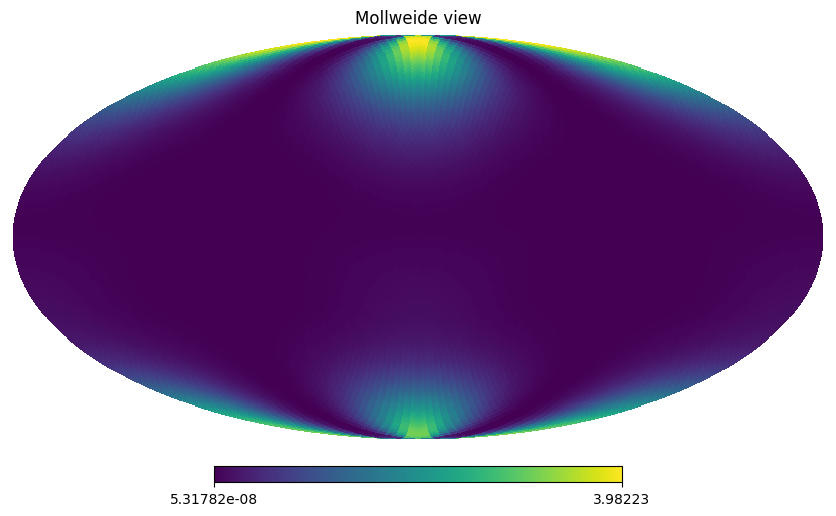

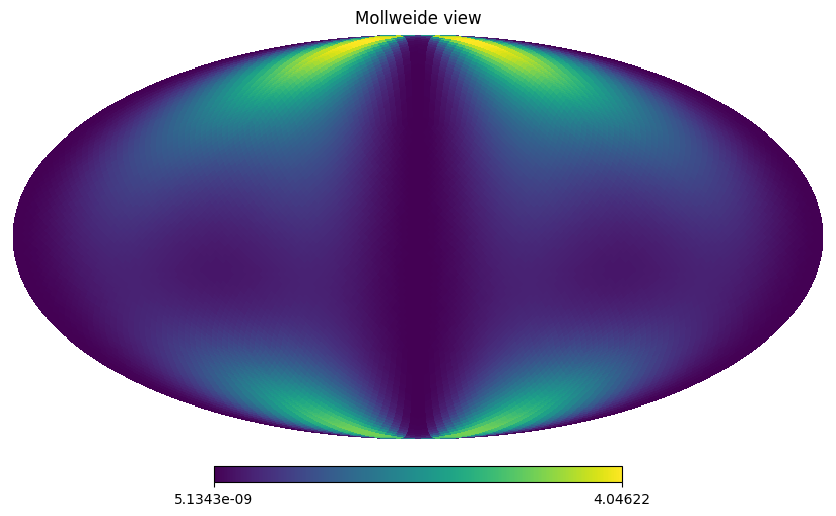

In [442]:
theta_chat = jnp.deg2rad(np.clip(theta_sim, 0.0, 180.0))        # -> [0, pi]
phi_chat   = jnp.deg2rad((phi_sim + 360.0) % 360.0)     

NSIDE = DEFAULT_NSIDE  # or pick another; 74 is close for ~65k samples
NPIX = DEFAULT_NPIX
pix = healpy.ang2pix(NSIDE, theta_chat, phi_chat, nest=False, lonlat=False)

counts = jnp.bincount(pix, minlength=NPIX)

def hfss_map(weight):
    sums   = jnp.bincount(pix, weights=weight, minlength=NPIX)
    m = np.full(NPIX, healpy.UNSEEN, dtype=float)   # RING-ordered map
    mask = counts > 0
    m[mask] = sums[mask] / counts[mask]
    return m


m_th = hfss_map(sim_map_th)
m_phi = hfss_map(sim_map_ph)
healpy.mollview(m_th)
healpy.mollview(m_phi)

In [6]:
def power_transmitter_jax_pure(self, tx_ant, rot_m, th_tx, phi_tx, px,
                               pwr_beam_th, pwr_beam_phi):
    # Geometry is unchanged
    E_tx_rot = tx_ant.E_rotated(rot_m)
    th_hat   = self.th_hat(th_tx, phi_tx)
    phi_hat  = self.phi_hat(th_tx, phi_tx)

    E_tx_th  = jnp.dot(E_tx_rot, th_hat)
    E_tx_phi = jnp.dot(E_tx_rot, phi_hat)

    # Robust dynamic indexing when px is traced
    # px = jax.lax.convert_element_type(px, jnp.int32)
    px = jax.lax.convert_element_type(px, jnp.int64)
    g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
    g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)

    return g_th * (E_tx_th ** 2) + g_phi * (E_tx_phi ** 2)

# Attach to your class if you prefer method style:
# RXClass.power_transmitter_jax_pure = power_transmitter_jax_pure


# ---------------------------------------------------------------------------
# 2) Precompute coords outside of jit (your original version kept)
#    Returns: (rs, th_txs, phi_txs, pxs) with pxs as int32
# ---------------------------------------------------------------------------
def px_th_ph(rx, tx, az, el):
    n = el.shape[0]
    # pxs    = jnp.zeros(n, dtype=jnp.int32)
    pxs    = jnp.zeros(n, dtype=jnp.int64)
    th_txs = jnp.zeros(n)
    phi_txs= jnp.zeros(n)
    rs     = jnp.zeros((n, 3, 3))
    for i in range(n):
        r = rx.rotation(az[i], el[i])
        th_tx, phi_tx = tx.heading_thphi(r)
        px = rx.ang2pix(th_tx, phi_tx)
        pxs     = pxs.at[i].set(px)
        th_txs  = th_txs.at[i].set(th_tx)
        phi_txs = phi_txs.at[i].set(phi_tx)
        rs      = rs.at[i].set(r)
    # print('Finished Calculating Coords')
    return rs, th_txs, phi_txs, pxs

# same forward you already use
def predict_power_with_gains(rx, tx_const, r, th_tx, phi_tx, gth, gphi):
    E_tx_rot = tx_const.E_rotated(r)
    th_hat   = rx.th_hat(th_tx, phi_tx)
    phi_hat  = rx.phi_hat(th_tx, phi_tx)
    E_th  = jnp.dot(E_tx_rot, th_hat)
    E_phi = jnp.dot(E_tx_rot, phi_hat)
    return gth * (E_th**2) + gphi * (E_phi**2)

def simulate_powers_vmap(rx, tx, az, el, E1, E2, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None: pwr_beam_th = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi

    # Precompute geometry for all samples (your helper)
    rs, th_txs, phi_txs, pxs = px_th_ph(rx, tx, az, el)  # pxs should already be int32

    tx_ant = TransmitterAntenna(E1=E1, E2=E2)
    

    def _forward(r, th_tx, phi_tx, px):
        return rx.power_transmitter_jax_pure(
            tx_ant, r, th_tx, phi_tx, px,
            pwr_beam_th=pwr_beam_th,
            pwr_beam_phi=pwr_beam_phi
        )

    # Vectorize over the sample dimension
    P = jax.vmap(_forward)(rs, th_txs, phi_txs, pxs)     # shape: (N,)
    return P, pxs

def power_sim(pwr_beam_th, pwr_beam_phi, E_tx_th, E_tx_phi):
    return pwr_beam_th * (E_tx_th ** 2) + pwr_beam_phi * (E_tx_phi ** 2)

In [8]:
from datetime import datetime, timezone
from zoneinfo import ZoneInfo
import os
mtn_tzone = ZoneInfo("America/Denver")

t_start = datetime(2025, 7, 20, 13, 11, 51, 774738, tzinfo=mtn_tzone)
t_stop =  datetime(2025, 7, 20, 14, 35, 41, 181442, tzinfo=mtn_tzone)
def unix_time_to_local(unix_times):
    local_times = np.array([datetime.fromtimestamp(ts, tz=timezone.utc).astimezone(mtn_tzone) for ts in unix_times])
    return local_times


In [9]:
npz_file = 'ant/all_ant_2.npz'
# dtype_r = np.float32
dtype_c = np.complex64
if not os.path.exists(npz_file):
    data = {}
    times = []
    for f in files:
        print(f)
        hdr = read_header(f)

# def rot_m(ang, vec, *, normalize=True, keep_batch_last=False, dtype=None, eps=1e-12):
#     """Axis–angle rotation matrix via Rodrigues' formula.
#     ang: (...,) radians
#     vec: (..., 3) axis vector; normalized if normalize=True
#     Returns: (..., 3, 3) unless keep_batch_last=True, in which case (3,3,...) like NumPy.
#     """
#     if dtype is not None:
#         ang = ang.astype(dtype)
#         vec = vec.astype(dtype)

#     if normalize:
#         n = jnp.linalg.norm(vec, axis=-1, keepdims=True)
#         # avoid divide-by-zero; fall back to identity when axis is ~0
#         k = jnp.where(n > eps, vec / n, jnp.array([0.0,0.0,1.0], dtype=vec.dtype))
#     else:
#         k = vec

#     x, y, z = k[..., 0], k[..., 1], k[..., 2]
#     c = jnp.cos(ang); s = jnp.sin(ang); C = 1.0 - c
#     xs, ys, zs  = x*s,   y*s,   z*s
#     xC, yC, zC  = x*C,   y*C,   z*C
#     xyC, yzC, zxC = x*yC, y*zC, z*xC

#     R = jnp.stack([
#         jnp.stack([x*xC + c,   xyC - zs,     zxC + ys], axis=-1),
#         jnp.stack([xyC + zs,   y*yC + c,     yzC - xs], axis=-1),
#         jnp.stack([zxC - ys,   yzC + xs,     z*zC + c], axis=-1),
#     ], axis=-2)

#     if normalize and jnp.ndim(ang) == 0 and jnp.all(jnp.linalg.norm(vec, axis=-1) <= eps):
#         R = jnp.eye(3, dtype=R.dtype)

#     if keep_batch_last:  # mimic your original transpose behavior for 1D batch
#         if R.ndim > 2:
#             return jnp.moveaxis(R, (-2,-1), (0,1))  # (3,3,...) form
#     return R  # (...,3,3)

        if unix_time_to_local(hdr['times'][-1:]) < t_start:
            continue
        if unix_time_to_local(hdr['times'][:1]) > t_stop:
            continue
        dat, hdr, meta = io.read_hdf5(f)
        times.append(hdr['times'])
        for k in dat.keys():
            _d = dat[k]
            data[k] = data.get(k, []) + [_d]
    for k, v in data.items():
        data[k] = np.concatenate(v, dtype=dtype_r if len(k) == 1 else dtype_c)
    times = np.concatenate(times)
    local_times = unix_time_to_local(times)
    np.savez(npz_file, times=times, local_times=local_times, freqs=freqs, **data)
else:
    npz = np.load(npz_file, allow_pickle=True)
    data = {k: npz[k] for k in npz.files}
    times = data.pop('times')
    local_times = data.pop('local_times')
    freqs = data.pop('freqs')

In [10]:
chs = np.arange(16, 1024, 16)
k_1 = '2'
reduced = data[k_1][:, chs]
reduced = data[k_1][:,chs] - 0.5 * (data[k_1][:,chs-1] + data[k_1][:,chs+1])

In [2050]:
freqs[::16][ch]

136.71875

In [427]:
# f_ind = 35
f_ind = 44
# f_ind = 61
ch = f_ind
AZ_STEPS = 72  # with endpoint=True
period = 68.78
#t_start = 1753038750 # s utc
t_start = 1753038750 + period/2 # s utc
# t_start = times[0] + period/2 # s utc
t_cut = [(1753039060, 1753039181), (1753042808, 1753042834), (1753043111, 1753043119)]  # junk data
i_start = np.searchsorted(times, t_start)
norm = 1 / np.mean(reduced[:i_start], axis=0, keepdims=True)
norm[:,:4] = 0
t_stop = t_start + AZ_STEPS * period
i_stop = np.searchsorted(times, t_stop)

valid = np.ones(times.shape, dtype=bool)
valid = np.where(reduced[:,52] * norm[:,52] < 1e-4, False, ~np.isnan(reduced[:,52]))
for ti, tj in t_cut:
    i, j = np.searchsorted(times, ti), np.searchsorted(times, tj)
    valid[i:j] = False
    
valid[1:-1] = np.logical_and(valid[1:-1], np.logical_and(valid[:-2], valid[2:]))
sl = slice(i_start, i_stop)
_times = times[sl].copy()
_times -= _times[0]
# optional for strictly data-driven double-period folding
#_times_rnd = np.floor(_times / (2 * period))
#_times_mod = _times - _times_rnd * (2 * period)
val = valid[sl]
print(freqs[::16][ch])

171.875


In [376]:
### XXX Original, leave as is
import aipy
class BeamFit:
    def __init__(self, times, az_steps=AZ_STEPS, lmax=5):
        self.az_steps = az_steps
        self.times = times
        self.lmax = lmax
        self._el_ax = self._ant_pvec = np.array([1, 0, 0], dtype=dtype_r)
        self._az_ax = np.array([0, 0, 1], dtype=dtype_r)
        self.prms = {}
        self.ant_pvec = self.polresp = self.A_Ylm = self.A = None

    def _set_timing_params(self, prms):
        keys = {'t_off', 'el_off', 't_az_step', 'period'}
        for k in keys:
            if k in prms and prms[k] != self.prms.get(k, None):
                self.prms[k] = prms[k]
                self.az_deg = self.el_deg = self.ant_pvec = self.A_Ylm = self.A = None

    def _set_pol_params(self, prms):
        keys = {'prz', 'px', 'py'}
        for k in keys:
            if k in prms and prms[k] != self.prms.get(k, None):
                self.prms[k] = prms[k]
                self.gnd_pvecs = self.polresp = self.A = None

    def set_params(self, prms):
        self._set_timing_params(prms)
        self._set_pol_params(prms)
        
    def build_az_el(self):
        '''Build az/el coordinates.'''
        if self.ant_pvec is not None:
            return
        az, el, inds = [], [], []
        t_off, el_off, t_az_step, period = self.prms['t_off'], self.prms['el_off'], self.prms['t_az_step'], self.prms['period']
        i = 0
        t_i = self.times[0] + t_off
        for cnt, _az in enumerate(np.linspace(-180, 180, self.az_steps, endpoint=True)):
            t_f = t_i + period
            while i < self.times.size and self.times[i] < t_f - t_az_step:
                az.append(_az)
                if cnt % 2 == 0:
                    el.append(-180 + 360 * (self.times[i] - t_i) / (period - t_az_step))
                else:
                    el.append( 180 - 360 * (self.times[i] - t_i) / (period - t_az_step))
                inds.append(i)
                i += 1
            while i < self.times.size and self.times[i] < t_f:
                az.append(_az + (360 / (self.az_steps - 1)) * (self.times[i] - (t_f - t_az_step))/t_az_step)
                el.append(el[-1])
                inds.append(i)
                i += 1
            t_i = t_f
        self.az_deg = np.array(az)
        self.el_deg = np.array(el) + el_off
        self.inds = np.array(inds)
        rot_az = aipy.coord.rot_m(np.deg2rad(self.az_deg), self._az_ax)
        rot_el = aipy.coord.rot_m(np.deg2rad(self.el_deg), self._el_ax)
        self.ant_pvec = np.einsum('pab,pbc,c->pa', rot_el, rot_az, self._ant_pvec)

    


    
    def build_pol_resp(self):
        self.build_az_el()
        if self.polresp is not None:
            return
        pvec = np.array([[self.prms['px'], 0, 0], [0, self.prms['py'], 0]], dtype=dtype_r)
        rot_m = aipy.coord.rot_m(np.deg2rad(self.prms['prz']), np.array([0, 0, 1])).astype(dtype_r)
        self.gnd_pvecs = np.dot(rot_m, pvec.T).T
        if self.gnd_pvecs.ndim == 1:
            self.gnd_pvecs = self.gnd_pvecs[None, :]
        resp = np.dot(self.ant_pvec, self.gnd_pvecs.T)
        self.polresp = np.sum(np.abs(resp)**2, axis=-1)

    def build_A_Ylm(self):
        self.build_az_el()
        if self.A_Ylm is not None:
            return
        phi = np.deg2rad(self.az_deg)
        theta = np.deg2rad(self.el_deg)
        theta = np.mod(theta, 2*np.pi)
        theta = np.where(theta > np.pi, 2*np.pi - theta, theta)
        phi = np.mod(phi, 2*np.pi)
    
        N = theta.size
        P = (self.lmax + 1)**2
        A = np.empty((N, P), dtype=dtype_r)
    
        # Keep track of which column corresponds to which (l,m,kind)
        # kind ∈ {'m0','c','s'} for m=0, cos-like, sin-like
        self._meta = []
        col = 0
        for ell in range(self.lmax + 1):
            # m = 0 term (purely real)
            Y_l0 = sph_harm(0, ell, phi, theta).real
            #Y_l0 *= gen_pol_resp(az_deg, el_deg, gnd_pvecs)
            A[:, col] = Y_l0
            self._meta.append((ell, 0, 'm0'))
            col += 1
    
            # m > 0 terms: sqrt(2)*Re and sqrt(2)*Im
            for m in range(1, ell + 1):
                Y_lm = sph_harm(m, ell, phi, theta)  # complex
                #Y_lm *= gen_pol_resp(az_deg, el_deg, gnd_pvecs)
                A[:, col] = SQRT2 * Y_lm.real
                A[:, col+1] = SQRT2 * Y_lm.imag
                self._meta.append((ell, m, 'c'))
                self._meta.append((ell, m, 's'))
                col += 2
    
        assert col == P
        self.A_Ylm = A

    def build_A(self):
        self.build_pol_resp()
        self.build_A_Ylm()
        if self.A is not None:
            return
        self.A = self.A_Ylm * self.polresp[:, None]

    def _realcoeff_to_alm(self, coeff):
        """
        Convert real-basis coeffficients (matching design-matrix columns) into a
        healpy alm array (complex, m>=0). For a real sky, alms obey:
          a_{l,-m} = (-1)^m a_{l m}^*
        We only fill m>=0 as healpy expects.
        """
        alm = np.zeros(Alm.getsize(self.lmax), dtype=dtype_c)
        for k, (ell, m, kind) in enumerate(self._meta):
            if m == 0 and kind == 'm0':
                alm[Alm.getidx(self.lmax, ell, 0)] = coeff[k]
            elif kind in ('c'):
                c = coeff[k]
                s = coeff[k + 1]
                a_lm = (c - 1j * s) / SQRT2
                alm[Alm.getidx(self.lmax, ell, m)] = a_lm
        return alm

    def fit_alms(self, ymeas, w=None, reg=None, rcond=1e-10):
        self.build_A()
    
        # Apply weights (as sqrt weights on rows)
        ymeas = ymeas[self.inds]
        if w is None:
            w = np.ones_like(ymeas)
        else:
            w = w[self.inds]
        sqrtw = np.sqrt(w)
        Aw = self.A * sqrtw[:, None]
        yw = ymeas * sqrtw
    
        # Optional ridge regularization: stack sqrt(reg)*I
        if reg is not None and reg > 0:
            P = self.A.shape[1]
            Aw = np.vstack([Aw, np.sqrt(reg) * np.eye(P)])
            yw = np.concatenate([yw, np.zeros(P)])
    
        coeff = np.linalg.lstsq(Aw[self.inds], yw[self.inds], rcond=rcond)[0]
        yhat = self.A @ coeff
        chisq = np.sum(w * (ymeas[self.inds] - yhat[self.inds])**2)
        alm = self._realcoeff_to_alm(coeff)
        return alm, chisq, yhat

In [12]:
### XXX Edit
import aipy
class BeamFit:
    def __init__(self, times, az_steps=AZ_STEPS, lmax=5):
        self.az_steps = az_steps
        self.times = times
        self.lmax = lmax
        self._el_ax = self._ant_pvec = np.array([1, 0, 0], dtype=dtype_r)
        self._az_ax = np.array([0, 0, -1], dtype=dtype_r)
        self.prms = {}
        self.ant_pvec = self.polresp = self.A_Ylm = self.A = None

    def _set_timing_params(self, prms):
        keys = {'t_off', 'el_off', 't_az_step', 'period'}
        for k in keys:
            if k in prms and prms[k] != self.prms.get(k, None):
                self.prms[k] = prms[k]
                self.az_deg = self.el_deg = self.ant_pvec = self.A_Ylm = self.A = None

    def _set_pol_params(self, prms):
        keys = {'prz', 'px', 'py'}
        for k in keys:
            if k in prms and prms[k] != self.prms.get(k, None):
                self.prms[k] = prms[k]
                self.gnd_pvecs = self.polresp = self.A = None

    def set_params(self, prms):
        self._set_timing_params(prms)
        self._set_pol_params(prms)
        
    def build_az_el(self):
        '''Build az/el coordinates.'''
        if self.ant_pvec is not None:
            return
        az, el, inds = [], [], []
        t_off, el_off, t_az_step, period = self.prms['t_off'], self.prms['el_off'], self.prms['t_az_step'], self.prms['period']
        i = 0
        t_i = self.times[0] + t_off
        for cnt, _az in enumerate(np.linspace(-180, 180, self.az_steps, endpoint=True)):
            t_f = t_i + period
            while i < self.times.size and self.times[i] < t_f - t_az_step:
                az.append(_az)
                if cnt % 2 == 0:
                    el.append(-180 + 360 * (self.times[i] - t_i) / (period - t_az_step))
                else:
                    el.append( 180 - 360 * (self.times[i] - t_i) / (period - t_az_step))
                inds.append(i)
                i += 1
            while i < self.times.size and self.times[i] < t_f:
                az.append(_az + (360 / (self.az_steps - 1)) * (self.times[i] - (t_f - t_az_step))/t_az_step)
                el.append(el[-1])
                inds.append(i)
                i += 1
            t_i = t_f
        self.az_deg = np.array(az)
        self.el_deg = np.array(el) + el_off
        self.inds = np.array(inds)
        rot_az = aipy.coord.rot_m(np.deg2rad(self.az_deg), self._az_ax)
        rot_el = aipy.coord.rot_m(np.deg2rad(self.el_deg), self._el_ax)
        self.ant_pvec = np.einsum('pab,pbc,c->pa', rot_el, rot_az, self._ant_pvec)

    


    
    def build_pol_resp(self):
        self.build_az_el()
        if self.polresp is not None:
            return
        pvec = np.array([[self.prms['px'], 0, 0], [0, self.prms['py'], 0]], dtype=dtype_r)
        rot_m = aipy.coord.rot_m(np.deg2rad(self.prms['prz']), np.array([0, 0, 1])).astype(dtype_r)
        self.gnd_pvecs = np.dot(rot_m, pvec.T).T
        if self.gnd_pvecs.ndim == 1:
            self.gnd_pvecs = self.gnd_pvecs[None, :]
        resp = np.dot(self.ant_pvec, self.gnd_pvecs.T)
        self.polresp = np.sum(np.abs(resp)**2, axis=-1)

    def build_A_Ylm(self):
        self.build_az_el()
        if self.A_Ylm is not None:
            return
        phi = np.deg2rad(self.az_deg)
        theta = np.deg2rad(self.el_deg)
        theta = np.mod(theta, 2*np.pi)
        theta = np.where(theta > np.pi, 2*np.pi - theta, theta)
        phi = np.mod(phi, 2*np.pi)
    
        N = theta.size
        P = (self.lmax + 1)**2
        A = np.empty((N, P), dtype=dtype_r)
    
        # Keep track of which column corresponds to which (l,m,kind)
        # kind ∈ {'m0','c','s'} for m=0, cos-like, sin-like
        self._meta = []
        col = 0
        for ell in range(self.lmax + 1):
            # m = 0 term (purely real)
            Y_l0 = sph_harm(0, ell, phi, theta).real
            #Y_l0 *= gen_pol_resp(az_deg, el_deg, gnd_pvecs)
            A[:, col] = Y_l0
            self._meta.append((ell, 0, 'm0'))
            col += 1
    
            # m > 0 terms: sqrt(2)*Re and sqrt(2)*Im
            for m in range(1, ell + 1):
                Y_lm = sph_harm(m, ell, phi, theta)  # complex
                #Y_lm *= gen_pol_resp(az_deg, el_deg, gnd_pvecs)
                A[:, col] = SQRT2 * Y_lm.real
                A[:, col+1] = SQRT2 * Y_lm.imag
                self._meta.append((ell, m, 'c'))
                self._meta.append((ell, m, 's'))
                col += 2
    
        assert col == P
        self.A_Ylm = A

    def build_A(self):
        self.build_pol_resp()
        self.build_A_Ylm()
        if self.A is not None:
            return
        self.A = self.A_Ylm * self.polresp[:, None]

    def _realcoeff_to_alm(self, coeff):
        """
        Convert real-basis coeffficients (matching design-matrix columns) into a
        healpy alm array (complex, m>=0). For a real sky, alms obey:
          a_{l,-m} = (-1)^m a_{l m}^*
        We only fill m>=0 as healpy expects.
        """
        alm = np.zeros(Alm.getsize(self.lmax), dtype=dtype_c)
        for k, (ell, m, kind) in enumerate(self._meta):
            if m == 0 and kind == 'm0':
                alm[Alm.getidx(self.lmax, ell, 0)] = coeff[k]
            elif kind in ('c'):
                c = coeff[k]
                s = coeff[k + 1]
                a_lm = (c - 1j * s) / SQRT2
                alm[Alm.getidx(self.lmax, ell, m)] = a_lm
        return alm

    def fit_alms(self, ymeas, w=None, reg=None, rcond=1e-10):
        self.build_A()
    
        # Apply weights (as sqrt weights on rows)
        ymeas = ymeas[self.inds]
        if w is None:
            w = np.ones_like(ymeas)
        else:
            w = w[self.inds]
        sqrtw = np.sqrt(w)
        Aw = self.A * sqrtw[:, None]
        yw = ymeas * sqrtw
    
        # Optional ridge regularization: stack sqrt(reg)*I
        if reg is not None and reg > 0:
            P = self.A.shape[1]
            Aw = np.vstack([Aw, np.sqrt(reg) * np.eye(P)])
            yw = np.concatenate([yw, np.zeros(P)])
    
        coeff = np.linalg.lstsq(Aw[self.inds], yw[self.inds], rcond=rcond)[0]
        yhat = self.A @ coeff
        chisq = np.sum(w * (ymeas[self.inds] - yhat[self.inds])**2)
        alm = self._realcoeff_to_alm(coeff)
        return alm, chisq, yhat

In [428]:
# t_az_step = 1.0
t_az_step = 1.7
prms = dict(
    t_az_step = t_az_step, # XXX degenerate with beam width, need empirical measurement
    t_off = -2.4 + t_az_step/2,
    # t_off = -2.0 + t_az_step/2,
    el_off = -4.0,  # shift for pol_ang=62 on ch=44, seems to work for the rest. XXX degenerate with t_off?
    # el_off = -8.5,  # shift for pol_ang=62 on ch=44, seems to work for the rest. XXX degenerate with t_off?
    # az_off is unnecessary given fitting of polarization angle
    prz = 0.0,
    px = 1.0,
    py = 0.0,
    period = period,
)

# # force a rebuild
# fitter.ant_pvec = None
# fitter.az_deg = None
# fitter.el_deg = None
# fitter.A_Ylm = None
# fitter.A = None
# fitter.build_az_el()

fitter = BeamFit(_times[val])
fitter.set_params(prms)
fitter.build_az_el()

In [429]:
rot = reduced[:, ch][sl][val][fitter.inds] * norm[:, ch]
outfile = 'figures/'

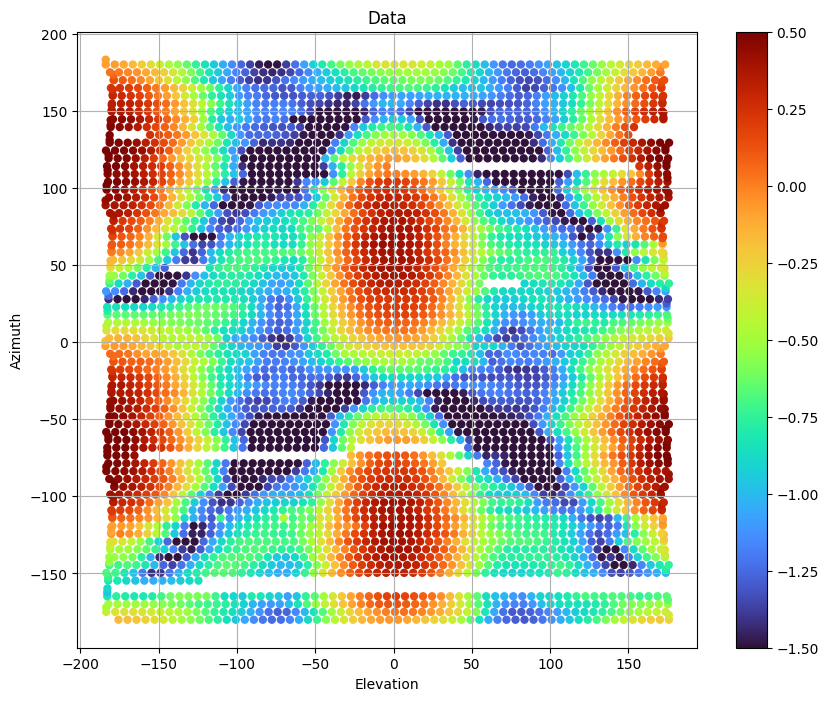

In [430]:
plt.figure(figsize=(10,8))
# _ = plt.scatter(el_use, az_use, c=np.log10(rot_use), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=np.log10(rot), s=25, cmap='turbo', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.az_deg[fitter.inds], fitter.el_deg[fitter.inds], c=np.log10(rot), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.xlabel('Elevation')
_ = plt.ylabel('Azimuth')
_ = plt.grid()
_ = plt.title('Data')
_ = plt.colorbar()
# _ = plt.xlim(-180, 0)
# _ = plt.savefig(outfile + 'Data')

moved 2002 of 4409 points (45.4%).


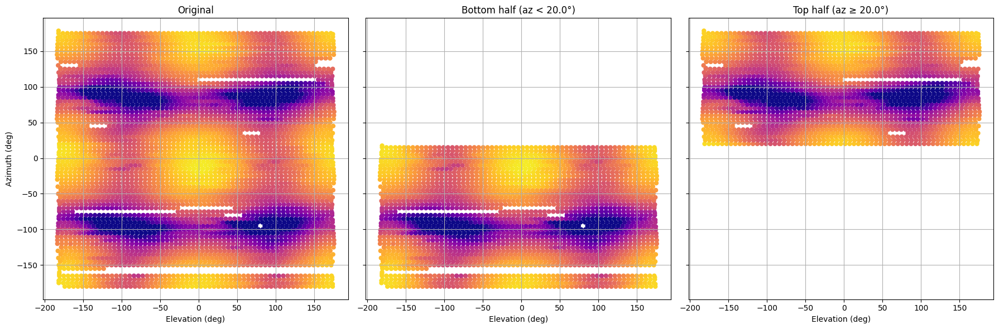

In [116]:
import numpy as np
import matplotlib.pyplot as plt

# --- helpers from earlier ---
def wrap_pm180(a_deg):
    return (a_deg + 180.0) % 360.0 - 180.0

def fold_after_az_deg(az_deg, el_deg, fold_at_deg=20.0, delta_deg=200.0, mirror=True):
    """
    For points with az >= fold_at_deg, move them by -delta_deg in az, and optionally mirror el.
    Returns (az_fold, el_fold, moved_mask).
    """
    az = np.asarray(az_deg, float).copy()
    el = np.asarray(el_deg, float).copy()
    moved = az >= fold_at_deg

    az[moved] = wrap_pm180(az[moved] - delta_deg)
    if mirror:
        el[moved] = -el[moved]
    return az, el, moved

# --- your inputs (DEGREES) ---
az_raw = np.asarray(fitter.az_deg[fitter.inds], float)
el_raw = np.asarray(fitter.el_deg[fitter.inds], float)
P_raw  = np.log10(rot)  # color array

# fold params (tune to what you measured)
az0 = 20.0   # crossover az (deg) where later half starts revisiting
daz = 200.0  # how far later the duplicates show (deg)
mirror = True

# (optional) make a folded view to check alignment visually (not used in halves)
az_fold, el_fold, moved = fold_after_az_deg(az_raw, el_raw, fold_at_deg=az0, delta_deg=daz, mirror=mirror)
print(f"moved {moved.sum()} of {moved.size} points ({100*moved.mean():.1f}%).")

# masks for halves by az
bottom_mask = az_raw < az0     # "bottom half" (lower az band in your scatter)
top_mask    = ~bottom_mask     # "top half"

# consistent color range (use your previous limits)
vmin, vmax = -1.5, 0.5

# --- three-panel figure: original, bottom half, top half ---
fig, ax = plt.subplots(1, 3, figsize=(18, 6), sharex=True, sharey=True)

# 1) Original
sc0 = ax[0].scatter(el_raw, az_raw, c=P_raw, s=25, cmap='plasma', vmin=vmin, vmax=vmax)
ax[0].set_title("Original")
ax[0].set_xlabel("Elevation (deg)")
ax[0].set_ylabel("Azimuth (deg)")
ax[0].grid(True)

# 2) Bottom half (az < az0)
sc1 = ax[1].scatter(el_raw[bottom_mask], az_raw[bottom_mask],
                    c=P_raw[bottom_mask], s=25, cmap='plasma', vmin=vmin, vmax=vmax)
ax[1].set_title(f"Bottom half (az < {az0}°)")
ax[1].set_xlabel("Elevation (deg)")
ax[1].grid(True)

# 3) Top half (az ≥ az0)
sc2 = ax[2].scatter(el_raw[top_mask], az_raw[top_mask],
                    c=P_raw[top_mask], s=25, cmap='plasma', vmin=vmin, vmax=vmax)
ax[2].set_title(f"Top half (az ≥ {az0}°)")
ax[2].set_xlabel("Elevation (deg)")
ax[2].grid(True)

# single shared colorbar
# cbar = fig.colorbar(sc2, ax=ax.ravel().tolist())
cbar.set_label("log10 Power")

plt.tight_layout()
plt.show()


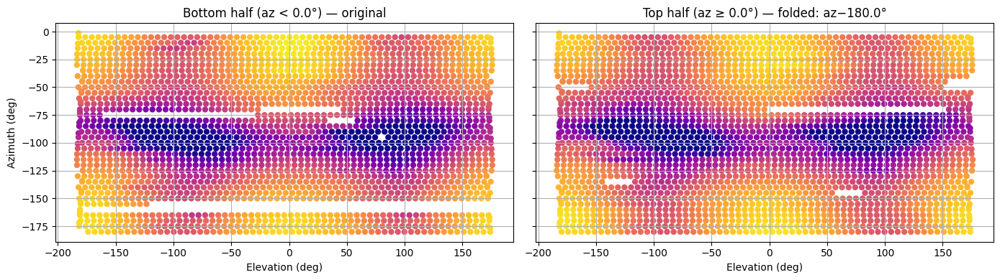

Bottom points: 2151  |  Top points: 2258  |  Top folded: True (mirror_el=False)


In [130]:
import numpy as np
import matplotlib.pyplot as plt

def wrap_pm180(a_deg):
    return (a_deg + 180.0) % 360.0 - 180.0

def plot_bottom_vs_top(
    az_deg, el_deg, power,
    cutoff_deg=20.0,      # where the “second half” begins (your overlap start)
    shift_deg=200.0,      # how far later the duplicates appear
    flip_top=True,        # fold the top half before plotting on the right
    mirror_el=True,       # if flipping: also mirror elevation (el -> -el)
    vmin=-1.5, vmax=0.5, cmap='plasma'
):
    az = np.asarray(az_deg, float)
    el = np.asarray(el_deg, float)
    P  = np.asarray(power, float)

    # halves by AZ
    top_mask    = az >= cutoff_deg
    bottom_mask = ~top_mask

    # left (bottom half, original)
    az_left, el_left, P_left = az[bottom_mask], el[bottom_mask], P[bottom_mask]

    # right (top half: either original or folded)
    az_right, el_right, P_right = az[top_mask].copy(), el[top_mask].copy(), P[top_mask].copy()
    if flip_top:
        az_right = wrap_pm180(az_right - shift_deg)
        if mirror_el:
            el_right = -el_right

    # figure
    fig, ax = plt.subplots(1, 2, figsize=(14, 4), sharex=True, sharey=True)

    sc0 = ax[0].scatter(el_left,  az_left,  c=P_left,  s=25, cmap=cmap, vmin=vmin, vmax=vmax)
    ax[0].set_title(f"Bottom half (az < {cutoff_deg}°) — original")
    ax[0].set_xlabel("Elevation (deg)")
    ax[0].set_ylabel("Azimuth (deg)")
    ax[0].grid(True)

    title_right = f"Top half (az ≥ {cutoff_deg}°) — "
    title_right += "folded: az−{}°{}".format(
        shift_deg, " & el→−el" if mirror_el and flip_top else ""
    ) if flip_top else "original"
    sc1 = ax[1].scatter(el_right, az_right, c=P_right, s=25, cmap=cmap, vmin=vmin, vmax=vmax)
    ax[1].set_title(title_right)
    ax[1].set_xlabel("Elevation (deg)")
    ax[1].grid(True)

    # cbar = fig.colorbar(sc1, ax=ax.ravel().tolist())
    cbar.set_label("log10 Power")
    plt.tight_layout()
    plt.show()

    print(f"Bottom points: {bottom_mask.sum()}  |  Top points: {top_mask.sum()}  "
          f"|  Top folded: {flip_top} (mirror_el={mirror_el})")

# --- usage with your variables ---
az_raw = fitter.az_deg[fitter.inds]
el_raw = fitter.el_deg[fitter.inds]
P_raw  = np.log10(rot)

# side-by-side: bottom vs top (folded)
plot_bottom_vs_top(az_raw, el_raw, P_raw, cutoff_deg=0.0, shift_deg=180.0, flip_top=True,  mirror_el=False)

# if you want to compare bottom vs top *without* folding, set flip_top=False
# plot_bottom_vs_top(az_raw, el_raw, P_raw, cutoff_deg=20.0, shift_deg=200.0, flip_top=False)


In [111]:
print(f"moved {moved.sum()} of {moved.size} points ({100*moved.mean():.1f}%).")

moved 2002 of 4409 points (45.4%).


(array([], dtype=int64),)

In [253]:
az_ang_ind = np.unique(fitter.az_deg[fitter.inds])
# az_ang_ind = np.unique(fitter.az_deg[fitter.inds])
idx = np.flatnonzero(fitter.az_deg[fitter.inds] == az_ang_ind[0])
idx

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61])

In [255]:
u, counts = np.unique(fitter.az_deg[fitter.inds], return_counts=True)
dup_vals = u[counts > 1]                       # values that appear >1 time
dup_idx  = np.flatnonzero(np.isin(fitter.az_deg[fitter.inds], dup_vals))  # indices of all those values

In [259]:

idx = np.flatnonzero(fitter.az_deg[fitter.inds] == dup_vals[0])
idx

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61])

In [280]:
fitter.az_deg[fitter.inds][-67], idx

(174.92957746478874,
 array([ 63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,
         76,  77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,
         89,  90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101,
        102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114,
        115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125]))

az_ispos[0]=-98.87323943661971, 98.87323943661971


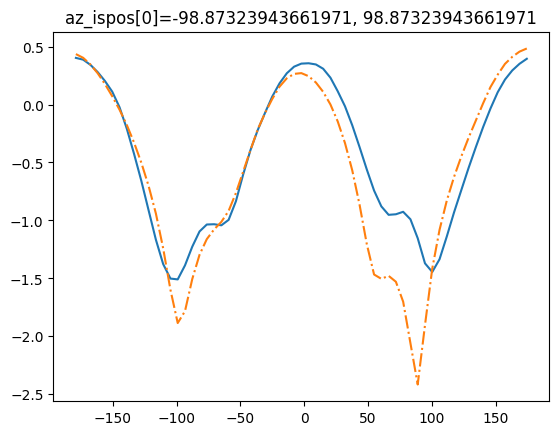

In [379]:
check = 15

idx = np.flatnonzero(fitter.az_deg[fitter.inds] == dup_vals[check])
# idx = np.flatnonzero(fitter.az_deg[fitter.inds] == az_ang_ind[check])
# az_ang = fitter.az_deg[fitter.inds][np.where(fitter.az_deg[fitter.inds]==az_ang_ind[check])]
# az_ang_ = fitter.az_deg[fitter.inds][np.where(fitter.az_deg[fitter.inds]==az_ang_ind[-check])]
# az_ispos = np.where(fitter.az_deg[fitter.inds]== idx)
az_ispos = fitter.az_deg[fitter.inds][idx]
other = np.where(fitter.az_deg[fitter.inds] == -az_ispos[0])
# az_isneg = fitter.az_deg[fitter.inds][-idx -10]
az_isneg = fitter.az_deg[fitter.inds][other]
el_const = fitter.el_deg[fitter.inds][idx]
# az_isneg = np.where(fitter.az_deg[fitter.inds]==-idx)
print(f'{az_ispos[0]=}, {az_isneg[0]}')

plt.figure()
plt.plot(el_const, np.log10(rot[idx]))
plt.plot(el_const, np.log10(rot[other]), ls='-.')
plt.title(f'{az_ispos[0]=}, {az_isneg[0]}')
plt.show()

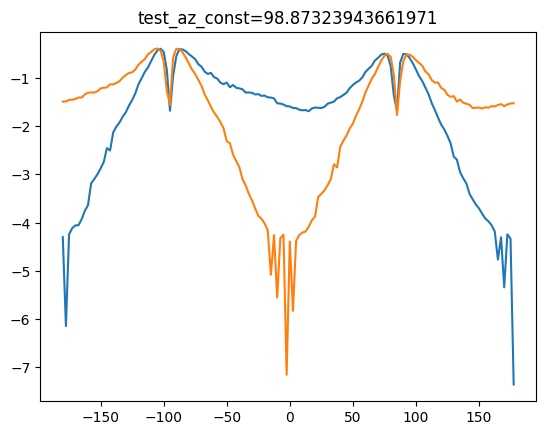

In [622]:
test_n = 360
# test_bound = 180
test_bound = test_n//2
# test_bound = 72
# test_1half = np.linspace(-test_bound, 0, test_n, endpoint=True)
# test_2half = np.linspace(0, test_bound,  test_n, endpoint=True)
test_1half = np.linspace(-test_bound, 0, 72, endpoint=False)
test_2half = np.linspace(0, test_bound,  72, endpoint=False)
# test_2half = np.linspace(test_bound, 0, test_n, endpoint=True)
test_el = np.concatenate((test_1half, test_2half))
test_az = np.ones_like(test_el)
txe1 = 0.9#.3 # .4
txe2 = 0.1#.7 # .6 looks close actually, when plotted over time
rx_true = RotatingAntenna(beam_th=m_th/jnp.max(m_th), beam_phi=m_phi/jnp.max(m_phi))
# rx_true = RotatingAntenna()
# rx_true._theta_flip_to_data = True   # <- enable the convention used by your (az, el) scatter

# tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([-1, -.1, -1]))
# coord = jnp.array([0.2,10.0,-1])
coord = jnp.array([-1.5,10.0,-1])
# coord = jnp.array([-0.015151515151515138,0.03535353535353539,-1])
tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=coord)

def test_sim(el, az):
    test_p = jnp.log10(simulate_powers_vmap(rx=rx_true, tx=tx_true, 
                         az=np.deg2rad(az), el=np.deg2rad(el), 
                         E1=txe1, E2=txe2)[0])
    return test_p



# test_p = jnp.log10(simulate_powers_vmap(rx=rx_true, tx=tx_true, 
                     # az=np.deg2rad(test_az), el=np.deg2rad(test_el), 
                     # E1=txe1, E2=txe2)[0])
# test_az_const = 98
test_az_const = az_isneg[0]
test_p1 = test_sim(test_el, (test_az) * -test_az_const)
test_p2 = test_sim(test_el, (test_az) *  test_az_const)

# test_az, test_el = fold_for_plot(test_az, test_el)    

plt.figure()
plt.plot(test_el, test_p1)
plt.plot(test_el, test_p2)
# plt.plot(test_el, test_p1 * (1/np.mean(test_p1, axis=0)))
# plt.plot(test_el, test_p2 * (1/np.mean(test_p2, axis=0)))
plt.title(f'{test_az_const=}')
plt.show()

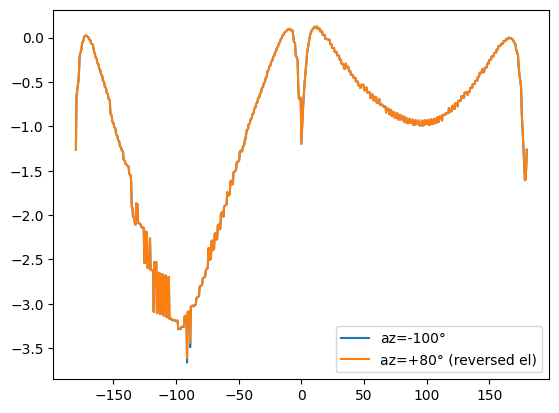

In [571]:
az1 = test_az * -100
az2 = az1 + 180.0   # -> +80°

p1 = test_sim(test_el, az1)
p2 = test_sim(test_el, az2)

plt.plot(test_el, p1, label="az=-100°")
plt.plot(test_el, p2, label="az=+80° (reversed el)")
plt.legend()

In [120]:
# (-0.015151515151515138, 0.03535353535353539, Array(0.02818529, dtype=float64)) best x and ys allowing both

In [841]:
rotator = healpy.Rotator(rot=(0, 180, 0))
rot_th = rotator.rotate_map_pixel(m_th)
rot_ph = rotator.rotate_map_pixel(m_phi)

In [98]:
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
def heading_from_meters(x_m, y_m, z_rx=97.0, z_tx=0.5):
    v = jnp.array([x_m, y_m, z_tx - z_rx], dtype=dtype_r)
    return v / jnp.linalg.norm(v)
def heading_to_meters(hx, hy, hz, z_rx=97.0, z_tx=0.5):
    dz = z_tx - z_rx
    return (hx / hz) * dz, (hy / hz) * dz  # (x_m, y_m)

In [477]:
# XXX txe1=.4 and txe2=.2 resulted in .189 loss value for 136.6 MHz!
# XXX txe1=.6, txe2=.4, coord=(0,0,-1), flip=False, m_th/min(m_th) and m_ph/min(m_ph) makes loss .162
txe1 = 0.0#.3 # .4
txe2 = 1.0#.7 # .6 looks close actually, when plotted over time
rx_true = RotatingAntenna(beam_th=m_th, beam_phi=m_phi)
# rx_true = RotatingAntenna(beam_th=rot_th, beam_phi=rot_ph)
# rx_true = RotatingAntenna(beam_th=m_th/jnp.min(m_th), beam_phi=m_phi/jnp.min(m_phi))
# rx_true = RotatingAntenna(beam_th=m_th/jnp.max(m_th), beam_phi=m_phi/jnp.max(m_phi))
# el_correction = -jnp.deg2rad(85.5)
# az_correction = -jnp.deg2rad(175.5)
# el_correction = -jnp.deg2rad(5.0)
# az_correction = -jnp.deg2rad(5)
el_correction = -jnp.deg2rad(0.0)
az_correction = jnp.deg2rad(0)
# el_correction = 0
# az_correction = 0

az_inds = np.deg2rad(fitter.az_deg[fitter.inds]) + az_correction#+ np.pi
el_inds = np.deg2rad(fitter.el_deg[fitter.inds]) + el_correction
# az_inds = -wrap(np.deg2rad(fitter.az_deg[fitter.inds]) + az_correction)#+ np.pi
# el_inds = -wrap(np.deg2rad(fitter.el_deg[fitter.inds]) + el_correction)


# rx_true = RotatingAntenna()
# rx_true._theta_flip_to_data = True   # <- enable the convention used by your (az, el) scatter
rx_true._theta_flip_to_data = False   # <- enable the convention used by your (az, el) scatter

# tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([-1, -.1, -1]))
# coord = jnp.array([-2.5,-10.0,-1]) # XXX Very interesting coord
# coord = jnp.array([-30.0,10.0,-1]) # XXX Almost recreates 171MHz features!
# coord = jnp.array([-30.0,-10.0,-1]) 
coord = jnp.array([-0.0, 0.0, -1])
# coord = heading_from_meters(2895, 965, z_rx=97, z_tx=0.5) # 2600 in x gives the best loss
# coord = heading_from_meters(2600, 900, z_rx=100, z_tx=0.0)
# coord = heading_from_meters(20, 20, z_rx=97, z_tx=0.5)
# coord = heading_from_meters(20, 1.5, z_rx=40, z_tx=0.5)
# coord = heading_from_meters(1, 1.5, z_rx=97, z_tx=0.0)
# coord = jnp.array([-0.015151515151515138,0.03535353535353539,-1])
# coord = coord / jnp.linalg.norm(coord)  
tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=coord)


sim_p, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=az_inds, el=el_inds, E1=txe1, E2=txe2)
# sim_p, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=az_use, el=el_use, E1=txe1, E2=txe2)
sim_norm = 1 / np.mean(sim_p, axis=0)

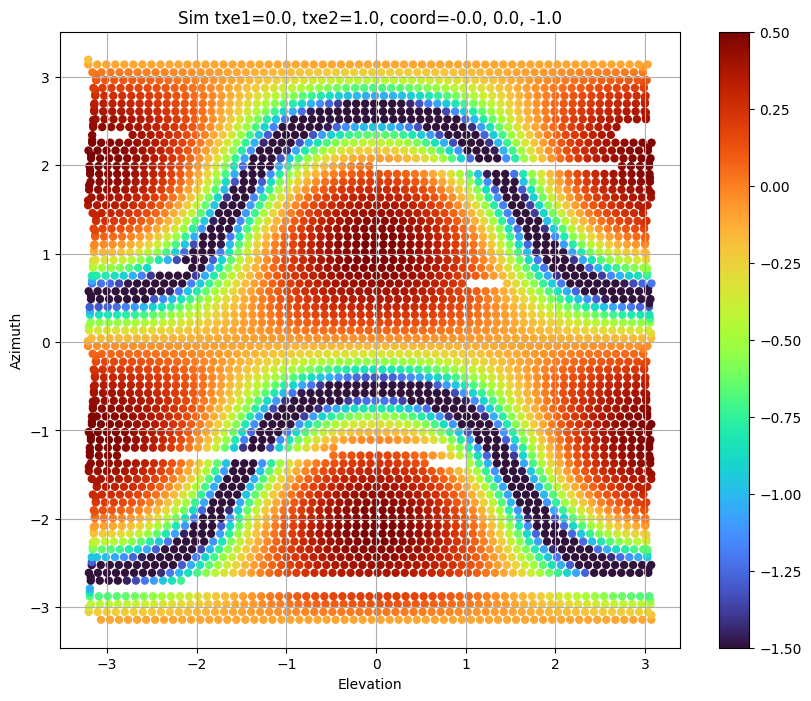

In [478]:

plt.figure(figsize=(10,8))
# _ = plt.scatter(el_use, az_use, c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.scatter(el_inds, az_inds, c=np.log10(sim_p*sim_norm), s=25, cmap='turbo', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds, az_inds, c=(sim_p*sim_norm), s=25, cmap='turbo')#, vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds, az_inds, c=np.log10(sim_p), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds[right], az_inds[right], c=np.log10(sim_p * sim_norm)[right], s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=np.log10(filled), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.az_deg[fitter.inds], fitter.el_deg[fitter.inds], c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.xlabel('Elevation')
_ = plt.ylabel('Azimuth')
_ = plt.grid()
_ = plt.title(f'Sim {txe1=}, {txe2=}, coord={coord[0]}, {coord[1]}, {coord[2]}')
_ = plt.colorbar()
# _ = plt.xlim(-np.pi, 0)
# _ = plt.show()
# _ = plt.savefig(outfile + f'plot{cnt}')
# _ = plt.savefig('Ideal')

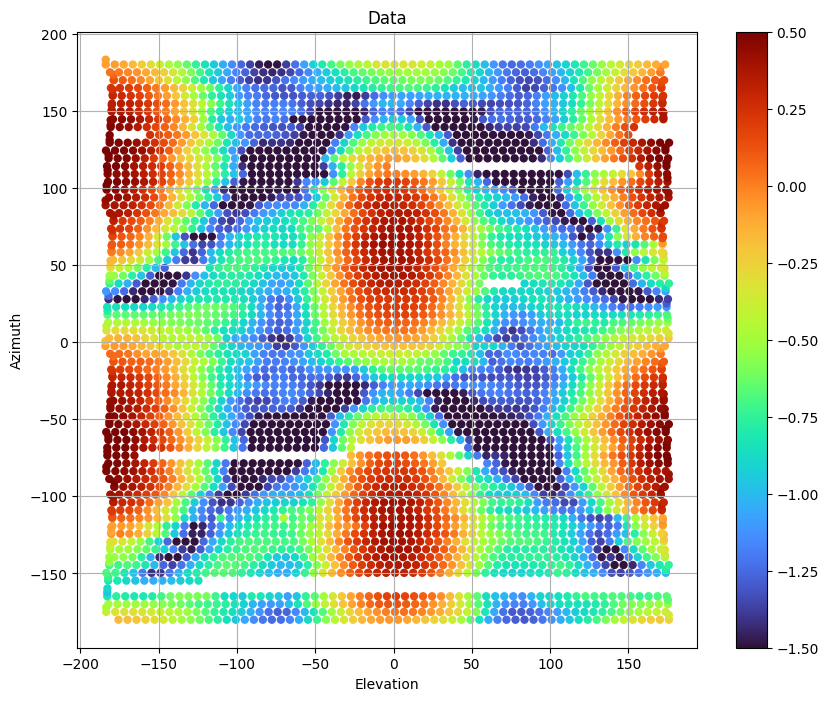

In [449]:
plt.figure(figsize=(10,8))
# _ = plt.scatter(el_use, az_use, c=np.log10(rot_use), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds, az_inds, c=np.log10(rot), s=25, cmap='turbo', vmax=0.5, vmin=-1.5)
_ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=np.log10(rot), s=25, cmap='turbo', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=(rot), s=25, cmap='turbo')#, vmax=0.5, vmin=-1.5)
_ = plt.xlabel('Elevation')
_ = plt.ylabel('Azimuth')
_ = plt.grid()
_ = plt.title('Data')
_ = plt.colorbar()

0.15396831911665418


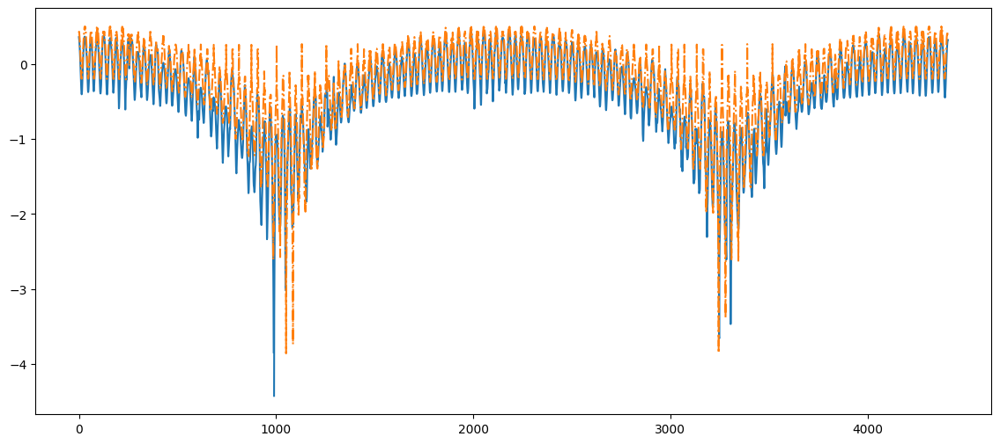

In [425]:
sim_p_norm = sim_p * sim_norm
print(np.mean(((rot) - (sim_p_norm))**2))
difference = ((rot - sim_p_norm) / rot) * 100
plt.figure(figsize=(14, 6))
plt.plot(np.log10(rot))
plt.plot(np.log10(sim_p_norm), ls='-.')
# plt.plot((difference))
# plt.xlim(0, 1150)
plt.show()

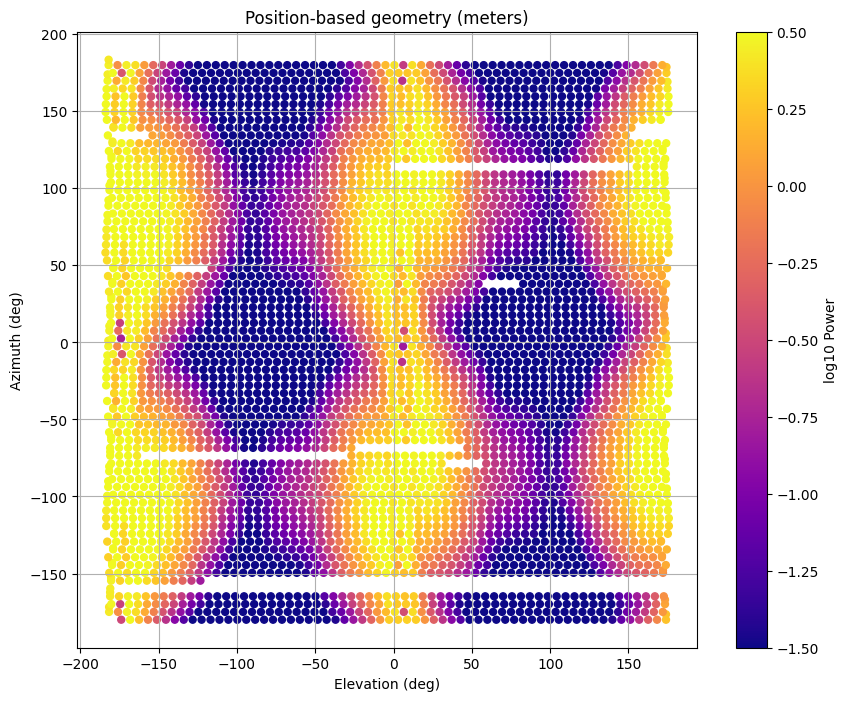

In [805]:


def power_from_positions(
    rx, tx, az, el,
    tx_pos_world,                 # [x, y, z] in meters
    pivot_world,                  # RX pivot position, e.g. [0,0,97]
    r_pc_body,                    # phase-center offset in body coords, e.g. [0.5,0,0]
    include_range=False,          # set True to apply (1/d^2); False to isolate geometry
    ref_dist=1.0
):
    # Rotation (your existing order)
    R = rx.rotation(az, el)

    # RX phase-center position (meters)
    x_rx = pivot_world + (R @ r_pc_body)

    # Vector to TX in world; distance & unit direction
    v_w = tx_pos_world - x_rx
    d   = jnp.linalg.norm(v_w)
    u_w = v_w / d

    # Express that direction in RX body frame, then to (θ,φ)
    u_b      = R.T @ u_w
    th, phi  = xyz2thphi(u_b)
    th_hp    = jnp.where(rx._theta_flip_to_data, jnp.pi - th, th)  # if your beams are nadir-referenced
    phi_hp   = jnp.mod(phi, 2*jnp.pi)

    # Beam lookup at that (θ,φ)
    px       = rx.ang2pix(th, phi)              # same as using th_hp/phi_hp because ang2pix does both
    g_th     = rx.pwr_beam_th[px]
    g_phi    = rx.pwr_beam_phi[px]

    # Local basis (body frame) and TX E in body frame (your code)
    th_hat   = rx.th_hat(th, phi)
    phi_hat  = rx.phi_hat(th, phi)
    E_tx_b   = tx.E_rotated(R)                  # polarization vector in RX body frame

    E_th     = jnp.dot(E_tx_b, th_hat)
    E_phi    = jnp.dot(E_tx_b, phi_hat)
    P        = g_th*(E_th**2) + g_phi*(E_phi**2)

    if include_range:
        P = P * (ref_dist**2) / (d**2)          # optional 1/R^2

    return P

# Vectorized over arrays of az/el (radians)
v_power_from_positions = jax.vmap(
    lambda a, e, tx_pos, pivot, r_pc: power_from_positions(
        rx_true, tx_true, a, e, tx_pos, pivot, r_pc,
        include_range=False  # start with False to isolate geometry
    ),
    in_axes=(0, 0, None, None, None)
)

# Geometry
pivot_world = jnp.array([0.0, 0.0, 100.0])   # RX pivot
r_pc_body   = jnp.array([0.5, 0.0, 0.0])    # 50 cm offset (along your +X body)
tx_pos      = jnp.array([-10, 10, 0.0])    # e.g., x_m=30.0, y_m=10.0, z_m=0.5

# Your motor angles (radians)
az = az_inds
el = el_inds

# Run
P_pos = v_power_from_positions(az, el, tx_pos, pivot_world, r_pc_body)

# Plot like before (degrees on axes if you prefer)
plt.figure(figsize=(10,8))
plt.scatter(np.rad2deg(el), np.rad2deg(az), c=np.log10(np.asarray(P_pos / np.mean(P_pos, axis=0))), s=25, cmap='plasma', vmin=-1.5, vmax=0.5)
# plt.scatter(np.rad2deg(el), np.rad2deg(az), c=np.log10(np.asarray(P_pos)), s=25, cmap='plasma')#, vmin=-1.5, vmax=0.5)
plt.xlabel('Elevation (deg)'); plt.ylabel('Azimuth (deg)'); plt.grid(True); plt.colorbar(label='log10 Power')
plt.title('Position-based geometry (meters)');
plt.show()


In [143]:


def audit_axes(rx, tx, delta_deg=5.0):
    d = np.deg2rad(delta_deg)
    # baseline
    R0 = rx.rotation(0.0, 0.0)
    th0, ph0 = tx.heading_thphi(R0)

    # pure +EL step
    R_el = rx.rotation(0.0, +d)
    th_el, ph_el = tx.heading_thphi(R_el)

    # pure +AZ step
    R_az = rx.rotation(+d, 0.0)
    th_az, ph_az = tx.heading_thphi(R_az)

    # convert to “sky elevation” and wrap φ for human eyes
    def sky(th, ph):
        el_sky = (np.pi/2) - float(th)
        phi    = (float(ph) + np.pi)%(2*np.pi) - np.pi
        return el_sky, phi

    el0,  phi0  = sky(th0,  ph0)
    el1,  phi1  = sky(th_el,ph_el)
    el2,  phi2  = sky(th_az,ph_az)

    print("Baseline: EL_sky, φ =", np.rad2deg(el0), np.rad2deg(phi0))
    print("+EL step: ΔEL_sky, Δφ =", np.rad2deg(el1-el0), np.rad2deg(phi1-phi0))
    print("+AZ step: ΔEL_sky, Δφ =", np.rad2deg(el2-el0), np.rad2deg(phi2-phi0))


import itertools, numpy as np, jax, jax.numpy as jnp
from copy import deepcopy

def build_rotation_variant(az_axis_base, el_axis_base, swap, flip_az, flip_el, order):
    az_axis = az_axis_base.copy()
    el_axis = el_axis_base.copy()
    if swap:
        az_axis, el_axis = el_axis, az_axis
    if flip_az:
        az_axis = -az_axis
    if flip_el:
        el_axis = -el_axis

    def rotation(az, el):
        R_az = rot_m(az, az_axis)
        R_el = rot_m(el, el_axis)
        return (R_el @ R_az) if (order == "el@az") else (R_az @ R_el)
    return rotation, az_axis, el_axis

def simulate_with_rotation(rx, tx, az, el, rotation_fn):
    # JAX-friendly: compute R inside vmap, then use your pure kernel
    def one(a, e):
        R = rotation_fn(a, e)
        th, ph = tx.heading_thphi(R)
        px = rx.ang2pix(th, ph)
        # same kernel you already use (pure, with beams passed explicitly if you want)
        return rx.power_transmitter_jax_pure(tx, R, th, ph, px, rx.pwr_beam_th, rx.pwr_beam_phi)
    return jax.vmap(one)(az, el)

def score_variant(P_sim, P_meas):
    x = np.asarray(P_sim).ravel(); y = np.asarray(P_meas).ravel()
    # mask NaNs etc.
    m = np.isfinite(x) & np.isfinite(y)
    if m.sum() < 10: return -np.inf
    x = (x[m] - x[m].mean())/x[m].std()
    y = (y[m] - y[m].mean())/y[m].std()
    return float(np.dot(x, y) / len(x))  # Pearson r

def find_best_axes(rx, tx, az, el, P_meas):
    base_az = np.array([0,0,1.0], dtype=rx.az_axis.dtype)
    base_el = np.array([1.0,0,0], dtype=rx.el_axis.dtype)

    best = None
    for swap, flip_az, flip_el, order in itertools.product([False,True],[False,True],[False,True],["el@az","az@el"]):
        rot_fn, az_ax, el_ax = build_rotation_variant(base_az, base_el, swap, flip_az, flip_el, order)
        try:
            P_sim = simulate_with_rotation(rx, tx, az, el, rot_fn)
            s = score_variant(P_sim, P_meas)
        except Exception as e:
            s = -np.inf
        tag = dict(swap=swap, flip_az=flip_az, flip_el=flip_el, order=order)
        if (best is None) or (s > best["score"]):
            best = dict(score=s, tag=tag, az_axis=az_ax, el_axis=el_ax)
    return best

# Use your actual arrays (radians) and measured power "rot" (or whatever)
az = az_inds
el = el_inds
P_meas = np.asarray(rot)  # same shape as az/el indices

best = find_best_axes(rx_true, tx_true, az, el, P_meas)
print("Best:", best["tag"], "score:", best["score"])
print("Chosen az_axis:", best["az_axis"], "el_axis:", best["el_axis"])

import numpy as np
import jax.numpy as jnp

def _wrap_pm_pi(a):
    return (a + np.pi) % (2*np.pi) - np.pi

def _ang_diff(a1, a0):
    return _wrap_pm_pi(a1 - a0)

def audit_axes_robust(rx, tx, ddeg=5.0):
    d = jnp.deg2rad(ddeg)

    # Temporarily set a safe off-pole heading for the audit (restore afterwards)
    orig_heading = np.array(tx.heading_top)
    try:
        probe = np.array([0.3, 0.2, -0.93], float)  # off-pole, not aligned with axes
        probe /= np.linalg.norm(probe)
        object.__setattr__(tx, "heading_top", jnp.asarray(probe, rx.pwr_beam_th.dtype))

        def sky(th, ph):
            el_sky = (np.pi/2) - float(th)
            phi    = _wrap_pm_pi(float(ph))
            return el_sky, phi

        R0 = rx.rotation(0.0, 0.0)
        th0, ph0 = tx.heading_thphi(R0)
        el0, phi0 = sky(th0, ph0)

        Rel = rx.rotation(0.0, +d)   # +EL
        th1, ph1 = tx.heading_thphi(Rel)
        el1, phi1 = sky(th1, ph1)

        Raz = rx.rotation(+d, 0.0)   # +AZ
        th2, ph2 = tx.heading_thphi(Raz)
        el2, phi2 = sky(th2, ph2)

        dEL_el  = np.rad2deg(el1 - el0)
        dPHI_el = np.rad2deg(_ang_diff(phi1, phi0))

        dEL_az  = np.rad2deg(el2 - el0)
        dPHI_az = np.rad2deg(_ang_diff(phi2, phi0))

        print(f"+EL step: ΔEL_sky ≈ {dEL_el:.2f}°, Δφ ≈ {dPHI_el:.2f}°")
        print(f"+AZ step: ΔEL_sky ≈ {dEL_az:.2f}°, Δφ ≈ {dPHI_az:.2f}°")
    finally:
        object.__setattr__(tx, "heading_top", jnp.asarray(orig_heading, rx.pwr_beam_th.dtype))


audit_axes_robust(rx_true, tx_true)

Best: {'swap': False, 'flip_az': False, 'flip_el': True, 'order': 'el@az'} score: 0.9485623392138547
Chosen az_axis: [0. 0. 1.] el_axis: [-1. -0. -0.]
+EL step: ΔEL_sky ≈ -2.33°, Δφ ≈ -12.19°
+AZ step: ΔEL_sky ≈ 0.00°, Δφ ≈ -5.00°


In [144]:
# Confirm a 5° rotation about +X really moves the look direction by ~5°
d = np.deg2rad(5.0)

R0  = rx_true.rotation(0.0, 0.0)
Rel = rx_true.rotation(0.0, d)

# Get body-frame spherical angles then convert to unit vectors on the sphere
th0, ph0 = tx_true.heading_thphi(R0)
th1, ph1 = tx_true.heading_thphi(Rel)

# Unit vectors in body frame (use your spherical basis)
r0 = _sph_basis(th0, ph0)[0]
r1 = _sph_basis(th1, ph1)[0]

# Angle between them (in degrees)
arc = np.degrees(np.arccos(np.clip(np.dot(np.asarray(r0), np.asarray(r1)), -1, 1)))
print("Arc length for +EL 5° rotation:", arc, "deg")  # should be ~5


Arc length for +EL 5° rotation: 4.999999999999992 deg


In [145]:
def best_offsets(az_rad, el_rad, P_sim, P_meas, az_range=(-10,10), el_range=(-10,10), step=0.5):
    azd = np.rad2deg(az_rad).copy()
    eld = np.rad2deg(el_rad).copy()
    best = (-np.inf, 0.0, 0.0)
    for AZ0 in np.arange(az_range[0], az_range[1]+step, step):
        azp = ((azd + AZ0 + 180) % 360) - 180
        for EL0 in np.arange(el_range[0], el_range[1]+step, step):
            elp = eld + EL0
            x = np.asarray(P_sim).ravel(); y = np.asarray(P_meas).ravel()
            m = np.isfinite(x) & np.isfinite(y)
            if m.sum() < 10: continue
            xr = (x[m]-x[m].mean())/x[m].std()
            yr = (y[m]-y[m].mean())/y[m].std()
            r  = float(np.dot(xr, yr)/len(xr))
            if r > best[0]: best = (r, AZ0, EL0)
    return best  # (score, AZ0, EL0)

# Example call:
score, AZ0, EL0 = best_offsets(az_inds, el_inds, sim_p, rot)
print("Best offsets:", AZ0, EL0, "deg (score:", score, ")")


Best offsets: -10.0 -10.0 deg (score: 0.9485514745949113 )


In [578]:
### XXX Something

import jax
import jax.numpy as jnp
import healpy  # only used to infer nside from beam length

# assumes: rot_m, xyz2thphi, jhp, dtype_r, DEFAULT_BEAM_TH, DEFAULT_BEAM_PHI defined

@jax.tree_util.register_pytree_node_class
class RotatingAntenna:
    def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI):
        self.pwr_beam_th  = jnp.asarray(beam_th)
        self.pwr_beam_phi = jnp.asarray(beam_phi)
        self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)
        self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)
        self.nside   = healpy.npix2nside(int(jnp.size(beam_th)))

    # JAX pytree
    def tree_flatten(self):
        leaves = (self.pwr_beam_th, self.pwr_beam_phi, self.el_axis, self.az_axis)
        aux    = (self.nside,)
        return leaves, aux

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        (nside,) = aux
        pwr_beam_th, pwr_beam_phi, el_axis, az_axis = leaves
        obj = cls(pwr_beam_th, pwr_beam_phi)
        object.__setattr__(obj, "nside", int(nside))
        object.__setattr__(obj, "el_axis", el_axis)
        object.__setattr__(obj, "az_axis", az_axis)
        return obj

    # rotation (your original order)
    def rotation(self, az, el):
        R_az = rot_m(az, self.az_axis)
        R_el = rot_m(el, self.el_axis)
        return R_el @ R_az

    # spherical unit vectors (your originals)
    def r_hat(self, th, phi):
        s = jnp.sin(th)
        return jnp.stack([jnp.cos(phi)*s, jnp.sin(phi)*s, jnp.cos(th)], axis=-1)

    def phi_hat(self, th, phi):
        r = self.r_hat(th, phi)
        z = self.az_axis.astype(r.dtype)
        v = jnp.cross(z, r)
        n = jnp.linalg.norm(v, axis=-1, keepdims=True)
        eps = jnp.finfo(r.dtype).eps
        return v / jnp.clip(n, a_min=eps)

    def th_hat(self, th, phi):
        r = self.r_hat(th, phi)
        p = self.phi_hat(th, phi)
        return jnp.cross(p, r)

    def ang2pix(self, th, phi):
        return jhp.ang2pix(self.nside, th, jnp.mod(phi, 2*jnp.pi)).astype(jnp.int32)

    def power_transmitter(self, tx_ant, az, el):
        R = self.rotation(az, el)
        th_tx, phi_tx = tx_ant.heading_thphi(R)
        E_tx_rot = tx_ant.E_rotated(R)
        px = self.ang2pix(th_tx, phi_tx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        return self.pwr_beam_th[px]*(E_tx_th**2) + self.pwr_beam_phi[px]*(E_tx_phi**2)

    def power_transmitter_jax(self, tx_ant, rot_mx, th_tx, phi_tx, px):
        E_tx_rot = tx_ant.E_rotated(rot_mx)
        th_hat   = self.th_hat(th_tx, phi_tx)
        phi_hat  = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        return self.pwr_beam_th[px]*(E_tx_th**2) + self.pwr_beam_phi[px]*(E_tx_phi**2)

    def power_transmitter_jax_pure(self, tx_ant, rot_mx, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        E_tx_rot = tx_ant.E_rotated(rot_mx)
        th_hat   = self.th_hat(th_tx, phi_tx)
        phi_hat  = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        px = jax.lax.convert_element_type(px, jnp.int32)
        g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
        g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
        return g_th*(E_tx_th**2) + g_phi*(E_tx_phi**2)


@jax.tree_util.register_pytree_node_class
class TransmitterAntenna:
    def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0,0,-1], dtype=dtype_r)):
        self.E1 = jnp.asarray(E1)
        self.E2 = jnp.asarray(E2)
        self.heading_top = jnp.asarray(heading_top, dtype=dtype_r)
        self.ax1_top = jnp.array([1,0,0], dtype=dtype_r)
        self.ax2_top = jnp.array([0,1,0], dtype=dtype_r)

    def tree_flatten(self):
        return (self.E1, self.E2, self.heading_top, self.ax1_top, self.ax2_top), ()
    @classmethod
    def tree_unflatten(cls, aux, leaves):
        E1, E2, heading_top, ax1_top, ax2_top = leaves
        obj = cls(E1=E1, E2=E2, heading_top=heading_top)
        object.__setattr__(obj, "ax1_top", ax1_top)
        object.__setattr__(obj, "ax2_top", ax2_top)
        return obj

    def E_top(self):
        return self.E1*self.ax1_top + self.E2*self.ax2_top

    def E_rotated(self, R):
        return R.T @ self.E_top()     # passive

    def heading_rotated(self, R):
        return R.T @ self.heading_top

    def heading_thphi(self, R):
        v = self.heading_rotated(R)
        th, ph = xyz2thphi(v)
        return th, jnp.mod(ph, 2*jnp.pi)
def px_th_ph_vmapped(rx, tx, az, el):
    Rs = jax.vmap(rx.rotation)(az, el)
    ths, phis = jax.vmap(tx.heading_thphi)(Rs)
    pxs = jax.vmap(rx.ang2pix)(ths, phis).astype(jnp.int32)
    return Rs, ths, phis, pxs

@jax.jit
def simulate_powers_vmap(rx, tx, az, el, E1, E2, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi
    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)
    def _one(R, th, ph, px):
        return rx.power_transmitter_jax_pure(tx, R, th, ph, px,
                                             pwr_beam_th=pwr_beam_th,
                                             pwr_beam_phi=pwr_beam_phi)
    P = jax.vmap(_one)(Rs, ths, phis, pxs)
    return P, pxs


In [462]:
# --- Drop-in: same names/API + 3 switches to resolve convention mismatches ---
import jax
import jax.numpy as jnp
import healpy

# assumes rot_m, xyz2thphi, jhp, dtype_r, DEFAULT_BEAM_TH, DEFAULT_BEAM_PHI are defined

def _sph_basis(th, phi):
    s, c   = jnp.sin(th), jnp.cos(th)
    sp, cp = jnp.sin(phi), jnp.cos(phi)
    r_hat   = jnp.stack([cp*s,  sp*s,  c], axis=-1)
    th_hat  = jnp.stack([cp*c,  sp*c, -s], axis=-1)
    phi_hat = jnp.stack([-sp,     cp,  jnp.zeros_like(th)], axis=-1)
    return r_hat, th_hat, phi_hat

@jax.tree_util.register_pytree_node_class
class RotatingAntenna:
    def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI):
        self.pwr_beam_th  = jnp.asarray(beam_th)
        self.pwr_beam_phi = jnp.asarray(beam_phi)
        self.nside = healpy.npix2nside(int(jnp.size(beam_th)))
        self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)
        self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)
        # --- NEW toggles ---
        self._theta_flip_to_data = False          # θ' = π − θ
        self._rotation_mode = "passive"           # "passive" -> R.T@v, "active" -> R@v
        self._rot_order = "el_then_az"            # "el_then_az" or "az_then_el"

    def tree_flatten(self):
        leaves = (self.pwr_beam_th, self.pwr_beam_phi, self.el_axis, self.az_axis)
        aux = (self.nside, self._theta_flip_to_data, self._rotation_mode, self._rot_order)
        return leaves, aux

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        nside, flip, mode, order = aux
        pwr_beam_th, pwr_beam_phi, el_axis, az_axis = leaves
        obj = cls(pwr_beam_th, pwr_beam_phi)
        object.__setattr__(obj, "nside", int(nside))
        object.__setattr__(obj, "el_axis", el_axis)
        object.__setattr__(obj, "az_axis", az_axis)
        object.__setattr__(obj, "_theta_flip_to_data", bool(flip))
        object.__setattr__(obj, "_rotation_mode", str(mode))
        object.__setattr__(obj, "_rot_order", str(order))
        return obj

    # --- rotation matrix (order selectable) ---
    def rotation(self, az, el):
        Rz = rot_m(az, self.az_axis)
        Rx = rot_m(el, self.el_axis)
        return Rx @ Rz if self._rot_order == "el_then_az" else Rz @ Rx

    # --- θ convention helper ---
    def _apply_theta_conv(self, th):
        return jnp.where(self._theta_flip_to_data, jnp.pi - th, th)

    # --- spherical basis using converted θ ---
    def r_hat(self, th, phi):
        th = self._apply_theta_conv(th); r,_,_ = _sph_basis(th, phi); return r
    def th_hat(self, th, phi):
        th = self._apply_theta_conv(th); _,thh,_ = _sph_basis(th, phi); return thh
    def phi_hat(self, th, phi):
        th = self._apply_theta_conv(th); _,_,phh = _sph_basis(th, phi); return phh

    # --- HEALPix lookup using converted θ ---
    def ang2pix(self, th, phi):
        th  = self._apply_theta_conv(th)
        phi = jnp.mod(phi, 2*jnp.pi)
        return jhp.ang2pix(self.nside, th, phi).astype(jnp.int32)

    # --- power kernels (unchanged API) ---
    def power_transmitter(self, tx_ant, az, el):
        R = self.rotation(az, el)
        th_tx, phi_tx = tx_ant.heading_thphi(R, mode=self._rotation_mode)
        E_tx_rot = tx_ant.E_rotated(R, mode=self._rotation_mode)
        px = self.ang2pix(th_tx, phi_tx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        return self.pwr_beam_th[px]*(E_tx_th**2) + self.pwr_beam_phi[px]*(E_tx_phi**2)

    def power_transmitter_jax(self, tx_ant, rot_mx, th_tx, phi_tx, px):
        E_tx_rot = tx_ant.E_rotated(rot_mx, mode=self._rotation_mode)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        return self.pwr_beam_th[px]*(E_tx_th**2) + self.pwr_beam_phi[px]*(E_tx_phi**2)

    def power_transmitter_jax_pure(self, tx_ant, rot_mx, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        E_tx_rot = tx_ant.E_rotated(rot_mx, mode=self._rotation_mode)
        th_hat   = self.th_hat(th_tx, phi_tx)
        phi_hat  = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        px = jax.lax.convert_element_type(px, jnp.int32)
        g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, 0, False)
        g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, 0, False)
        return g_th*(E_tx_th**2) + g_phi*(E_tx_phi**2)

@jax.tree_util.register_pytree_node_class
class TransmitterAntenna:
    def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0,0,-1], dtype=dtype_r)):
        self.E1 = jnp.asarray(E1); self.E2 = jnp.asarray(E2)
        self.heading_top = jnp.asarray(heading_top, dtype=dtype_r)
        self.ax1_top = jnp.array([1,0,0], dtype=dtype_r)
        self.ax2_top = jnp.array([0,1,0], dtype=dtype_r)

    def tree_flatten(self):
        return (self.E1, self.E2, self.heading_top, self.ax1_top, self.ax2_top), ()
    @classmethod
    def tree_unflatten(cls, aux, leaves):
        E1,E2,heading_top,ax1_top,ax2_top = leaves
        obj = cls(E1=E1, E2=E2, heading_top=heading_top)
        object.__setattr__(obj, "ax1_top", ax1_top)
        object.__setattr__(obj, "ax2_top", ax2_top)
        return obj

    def E_top(self): return self.E1*self.ax1_top + self.E2*self.ax2_top

    # --- NEW: both rotation modes supported ---
    def E_rotated(self, R, mode="passive"):
        return (R.T @ self.E_top()) if mode == "passive" else (R @ self.E_top())

    def heading_rotated(self, R, mode="passive"):
        return (R.T @ self.heading_top) if mode == "passive" else (R @ self.heading_top)

    def heading_thphi(self, R, mode="passive"):
        v = self.heading_rotated(R, mode=mode)
        th, ph = xyz2thphi(v)
        return th, jnp.mod(ph, 2*jnp.pi)

# -------- helpers you already use --------
def px_th_ph_vmapped(rx: RotatingAntenna, tx: TransmitterAntenna, az, el):
    Rs = jax.vmap(rx.rotation)(az, el)
    ths, phis = jax.vmap(lambda R: tx.heading_thphi(R, mode=rx._rotation_mode))(Rs)
    pxs = jax.vmap(rx.ang2pix)(ths, phis).astype(jnp.int32)
    return Rs, ths, phis, pxs

@jax.jit
def simulate_powers_vmap(rx, tx, az, el, E1, E2, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi
    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)
    def _one(R, th, ph, px):
        return rx.power_transmitter_jax_pure(
            tx, R, th, ph, px, pwr_beam_th=pwr_beam_th, pwr_beam_phi=pwr_beam_phi
        )
    P = jax.vmap(_one)(Rs, ths, phis, pxs)
    return P, pxs


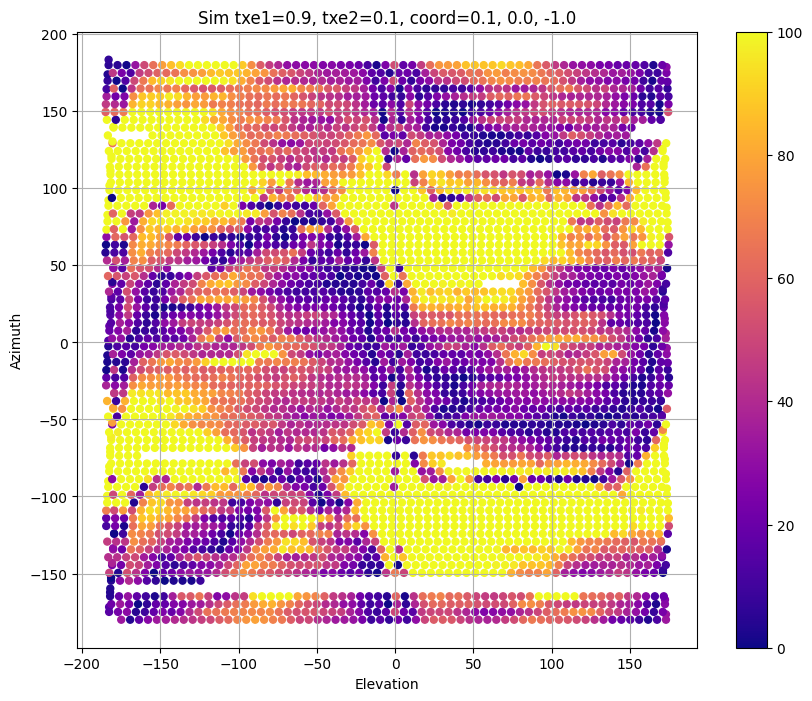

In [87]:

plt.figure(figsize=(10,8))
_ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=(np.abs(sim_p * sim_norm - rot) / rot)*100, s=25, cmap='plasma', vmax=100.0, vmin=0)
# _ = plt.scatter(fitter.az_deg[fitter.inds], fitter.el_deg[fitter.inds], c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', az=jnp.deg2rad(0)vaz=jnp.deg2rad(0)max=0.5, vmin=-1.5)
_ = plt.xlabel('Elevation')
_ = plt.ylabel('Azimuth')
_ = plt.grid()
_ = plt.title(f'Sim {txe1=}, {txe2=}, coord={coord[0]}, {coord[1]}, {coord[2]}')
_ = plt.colorbar()

In [250]:
hit_pxs.shape

(4409,)

In [120]:
values, counts = np.unique(hit_pxs, return_counts=True)

hit_twice = values[counts==2]
hit_twice.shape

(414,)

In [126]:
order = np.argsort(hit_pxs)
hit_pxs_s   = hit_pxs[order]
sim_p_s  = sim_p[order]

values, counts = np.unique(hit_pxs_s, return_counts=True)
starts = np.cumsum(np.r_[0, counts[:-1]])

mask2 = counts == 2
pixels2 = values[mask2]
i1 = order[starts[mask2]]
i2 = order[starts[mask2] + 1]

sim_p_pairs = np.stack([sim_p[i1], sim_p[i2]], axis=1)

In [21]:
N = len(hit_pxs)
order = np.lexsort((np.arange(N), hit_pxs))   # primary sort by hit_pxs, tie-break by time index
hit_pxs_s  = hit_pxs[order]

value, counts = np.unique(hit_pxs_s, return_counts=True)
starts = np.cumsum(np.r_[0, counts[:-1]])
mask2  = (counts == 2)

i_first  = order[starts[mask2]]          # earlier hit
i_second = order[starts[mask2] + 1]      # later hit
pixels2  = value[mask2]

# sim_p_pairs = np.stack([sim_p[i_first], sim_p[i_second]], axis=1)
sim_p_pairs = np.stack([sim_p[i_first], sim_p[i_second]], axis=1)
rot_pairs = np.stack([rot[i_first], rot[i_second]], axis=1)


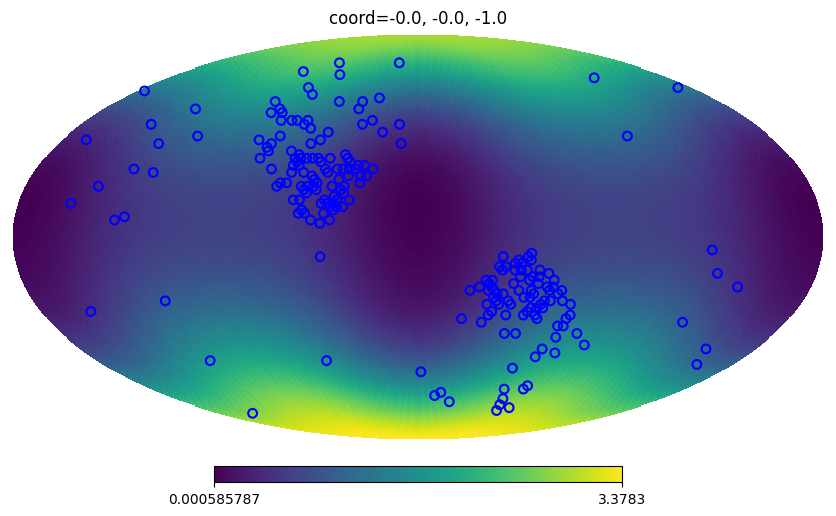

In [22]:
m_hit = m_phi + m_th

healpy.mollview(m_hit, cbar=True, title=f'coord={coord[0]}, {coord[1]}, {coord[2]}')

# lon, lat = healpy.pix2ang(DEFAULT_NSIDE, hit_pxs, nest=True, lonlat=False)
# healpy.projscatter(
#     lon, lat, lonlat=False,
#     s=40, marker='o',
#     facecolors='none', edgecolors='crimson', linewidths=1.5,
#     zorder=10
# )
lon, lat = healpy.pix2ang(DEFAULT_NSIDE, pixels2, nest=True, lonlat=False)
healpy.projscatter(
    lon, lat, lonlat=False,
    s=40, marker='o',
    facecolors='none', edgecolors='blue', linewidths=1.5,
    zorder=10
)

plt.show()


# for p in np.atleast_1d(hit_pxs):
#     # pixel boundary in Cartesian; convert to angles
#     v = healpy.boundaries(DEFAULT_NSIDE, p, nest=False, step=1000)      # shape (3, N)
#     th, ph = healpy.vec2ang(v.T)                             # radians
#     healpy.projplot(th, ph, '-', color='gold', lw=1.8, zorder=10)

# plt.show()

In [199]:
res = np.mean((sim_p_pairs[:, 1] - sim_p_pairs[:, 0])**2)
res # 0.19714316697560863

0.012474421470894342

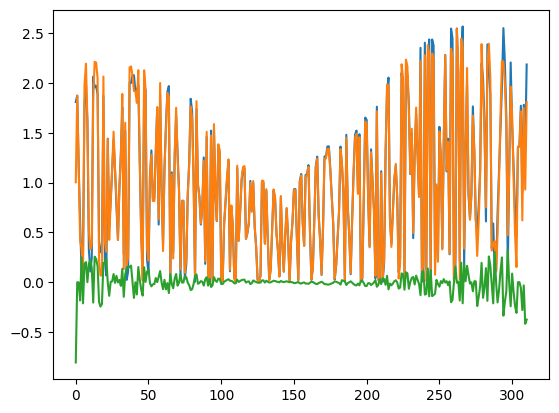

In [200]:
plt.figure()
plt.plot(sim_p_pairs[:, 0])
plt.plot(sim_p_pairs[:, 1])
plt.plot(sim_p_pairs[:, 1] - sim_p_pairs[:, 0])
plt.show()

0.1928615885045774


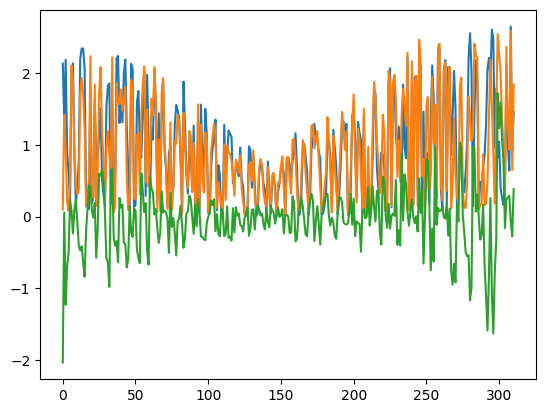

In [201]:

res = np.mean((rot_pairs[:, 1] - rot_pairs[:, 0])**2)
print(res)
plt.figure()
plt.plot(rot_pairs[:, 0])
plt.plot(rot_pairs[:, 1])
plt.plot(rot_pairs[:, 1] - rot_pairs[:, 0])
plt.show()

In [254]:
# XXX Goes Way too hard, sims in like half a second, instead of a whole minute




# ----- utils you already have -----
# rot_m(ang, axis): returns (3,3) rotation matrix (orthonormal)
# xyz2thphi(vec3): returns (th, phi)
# jhp.ang2pix(nside, th, phi): JAX-compatible ang2pix
# dtype_r: your preferred real dtype (float32 recommended)

# ========================
# RotatingAntenna (PyTree)
# ========================
@jax.tree_util.register_pytree_node_class
class RotatingAntenna:
    def __init__(self, beam_th, beam_phi):
        # store as JAX arrays
        self.pwr_beam_th  = jnp.asarray(beam_th)
        self.pwr_beam_phi = jnp.asarray(beam_phi)
        # derived stuff (shapes won't change)
        self.nside  = int(jhp.npix2nside(self.pwr_beam_th.size))
        self.el_axis = jnp.array([1., 0., 0.], dtype=self.pwr_beam_th.dtype)
        self.az_axis = jnp.array([0., 0., 1.], dtype=self.pwr_beam_th.dtype)

    # ---- PyTree protocol ----
    def tree_flatten(self):
        # Leaves: values that can change run-to-run without recompiling
        leaves = (self.pwr_beam_th, self.pwr_beam_phi, self.el_axis, self.az_axis)
        # Aux: anything reconstructed from leaves or constant metadata
        aux = (self.nside,)
        return leaves, aux

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        (nside,) = aux
        pwr_beam_th, pwr_beam_phi, el_axis, az_axis = leaves
        # Recreate, making sure attributes match
        obj = cls(pwr_beam_th, pwr_beam_phi)
        # override axes to preserve exact values
        object.__setattr__(obj, "el_axis", el_axis)
        object.__setattr__(obj, "az_axis", az_axis)
        object.__setattr__(obj, "nside", nside)
        return obj

    # ---- geometry & helpers ----
    def rotation(self, az, el):
        R_az = rot_m(az, self.az_axis)
        R_el = rot_m(el, self.el_axis)
        return R_el @ R_az

    def r_hat(self, th, phi):
        s = jnp.sin(th)
        return jnp.stack([jnp.cos(phi)*s, jnp.sin(phi)*s, jnp.cos(th)], axis=-1)

    def phi_hat(self, th, phi):
        r = self.r_hat(th, phi)
        z = self.az_axis.astype(r.dtype)
        v = jnp.cross(z, r)                # tangent toward +phi
        n = jnp.linalg.norm(v, axis=-1, keepdims=True)
        eps = jnp.finfo(r.dtype).eps
        return v / jnp.clip(n, a_min=eps)  # safe near poles

    def th_hat(self, th, phi):
        r = self.r_hat(th, phi)
        p = self.phi_hat(th, phi)
        return jnp.cross(p, r)

    def ang2pix(self, th, phi):
        # prefer int32 indices in downstream code
        return jhp.ang2pix(self.nside, th, phi).astype(jnp.int32)

    # Pure-JAX power kernel (vectorizable & jit-friendly)
    def power_transmitter_jax_pure(self, tx_ant, rot_m, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        # E field in receiver frame; rotation matrix is orthonormal => R^{-1} = R^T
        E_tx_rot = tx_ant.E_rotated(rot_m)
        th_hat   = self.th_hat(th_tx, phi_tx)
        phi_hat  = self.phi_hat(th_tx, phi_tx)

        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)

        px = jax.lax.convert_element_type(px, jnp.int32)
        g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
        g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)

        P_rx_th  = g_th  * (E_tx_th  ** 2)
        P_rx_phi = g_phi * (E_tx_phi ** 2)
        return P_rx_th + P_rx_phi

    


# ==========================
# TransmitterAntenna PyTree
# ==========================
@jax.tree_util.register_pytree_node_class
class TransmitterAntenna:
    def __init__(self,
                 E1=1.0,
                 E2=0.0,
                 heading_top=jnp.array([0., 0., -1.])):
        # store as JAX 0-d arrays (dynamic leaves)
        self.E1 = jnp.asarray(E1)
        self.E2 = jnp.asarray(E2)
        self.heading_top = jnp.asarray(heading_top)
        # fixed orthonormal axes in the "top" frame
        self.ax1_top = jnp.array([1., 0., 0.], dtype=self.heading_top.dtype)
        self.ax2_top = jnp.array([0., 1., 0.], dtype=self.heading_top.dtype)

    # ---- PyTree protocol ----
    def tree_flatten(self):
        leaves = (self.E1, self.E2, self.heading_top, self.ax1_top, self.ax2_top)
        aux = ()
        return leaves, aux

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        E1, E2, heading_top, ax1_top, ax2_top = leaves
        obj = cls(E1=E1, E2=E2, heading_top=heading_top)
        object.__setattr__(obj, "ax1_top", ax1_top)
        object.__setattr__(obj, "ax2_top", ax2_top)
        return obj

    # ---- field/heading in receiver frame ----
    def E_top(self):
        return self.E1 * self.ax1_top + self.E2 * self.ax2_top

    def E_rotated(self, R):
        # R is a rotation matrix (3x3), orthonormal => inverse is transpose
        return R.T @ self.E_top()

    def heading_rotated(self, R):
        return R.T @ self.heading_top

    def heading_thphi(self, R):
        heading_rot = self.heading_rotated(R)
        return xyz2thphi(heading_rot)


def px_th_ph_vmapped(rx, tx, az, el):
    Rs    = jax.vmap(rx.rotation)(az, el)                  # (N,3,3)
    out   = jax.vmap(tx.heading_thphi)(Rs)                 # either (N,2) or a tuple of (N,)
    # handle both cases
    if isinstance(out, tuple):
        ths, phis = out
    else:
        ths, phis = out[:, 0], out[:, 1]
    pxs   = jax.vmap(rx.ang2pix)(ths, phis).astype(jnp.int32)
    return Rs, ths, phis, pxs


@jax.jit
def simulate_powers_vmap(rx, tx, az, el, E1, E2, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None: pwr_beam_th = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi

    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)

    def _f(R, th, ph, px):
        return rx.power_transmitter_jax_pure(
            tx, R, th, ph, px,
            pwr_beam_th=pwr_beam_th, pwr_beam_phi=pwr_beam_phi
        )

    P = jax.vmap(_f)(Rs, ths, phis, pxs)  # (N,)
    return P, pxs


In [1092]:
# XXX More updated version of above, DONT EDIT
# Analytic spherical basis (stable at poles)
def _sph_basis(th, phi):
    s, c   = jnp.sin(th), jnp.cos(th)
    sp, cp = jnp.sin(phi), jnp.cos(phi)
    r_hat   = jnp.stack([cp*s,  sp*s,  c], axis=-1)
    th_hat  = jnp.stack([cp*c,  sp*c, -s], axis=-1)
    phi_hat = jnp.stack([-sp,     cp,  jnp.zeros_like(th)], axis=-1)
    return r_hat, th_hat, phi_hat


@jax.tree_util.register_pytree_node_class
class RotatingAntenna:
    def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI):
        self.pwr_beam_th  = jnp.asarray(beam_th)
        self.pwr_beam_phi = jnp.asarray(beam_phi)
        # healpy helper to get nside (static python int)
        self.nside = healpy.npix2nside(int(jnp.size(beam_th)))
        # rotation axes in your convention
        self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)
        self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)
        # NEW: per-instance switch (default off). Set True to use θ' = π − θ everywhere.
        self._theta_flip_to_data = False

    # ---- PyTree protocol (arrays as leaves; statics in aux) ----
    def tree_flatten(self):
        leaves = (self.pwr_beam_th, self.pwr_beam_phi, self.el_axis, self.az_axis)
        aux = (self.nside, self._theta_flip_to_data)
        return leaves, aux

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        nside, theta_flip = aux
        pwr_beam_th, pwr_beam_phi, el_axis, az_axis = leaves
        obj = cls(pwr_beam_th, pwr_beam_phi)
        object.__setattr__(obj, "nside", int(nside))
        object.__setattr__(obj, "el_axis", el_axis)
        object.__setattr__(obj, "az_axis", az_axis)
        object.__setattr__(obj, "_theta_flip_to_data", bool(theta_flip))
        return obj

    # ---- rotation (your original order) ----
    def rotation(self, az, el):
        R_az = rot_m(az, self.az_axis)
        R_el = rot_m(el, self.el_axis)
        return R_el @ R_az
        # return R_az @ R_el


    
    # ---- θ convention helper ----
    def _apply_theta_conv(self, th):
        # If enabled, convert simulator θ -> data θ : θ' = π − θ
        return jnp.where(self._theta_flip_to_data, (jnp.pi) - th, th)

    # ---- spherical unit vectors (use converted θ) ----
    def r_hat(self, th, phi):
        th = self._apply_theta_conv(th)
        r, _, _ = _sph_basis(th, phi)
        return r

    def th_hat(self, th, phi):
        th = self._apply_theta_conv(th)
        _, thh, _ = _sph_basis(th, phi)
        return thh

    def phi_hat(self, th, phi):
        # (phi-hat doesn’t depend on θ, but apply same conversion for consistency)
        th = self._apply_theta_conv(th)
        _, _, phh = _sph_basis(th, phi)
        return phh

    # ---- HEALPix lookup (use converted θ) ----
    def ang2pix(self, th, phi):
        th  = self._apply_theta_conv(th)
        phi = jnp.mod(phi, 2*jnp.pi)
        return jhp.ang2pix(self.nside, th, phi, lonlat=False).astype(jnp.int32)

    # ---- power kernels (unchanged API; now consistent with θ flip) ----
    def power_transmitter(self, tx_ant, az, el):
        R = self.rotation(az, el)
        th_tx, phi_tx = tx_ant.heading_thphi(R)
        E_tx_rot = tx_ant.E_rotated(R)
        px = self.ang2pix(th_tx, phi_tx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        P_rx_th  = self.pwr_beam_th[px]  * (E_tx_th**2)
        P_rx_phi = self.pwr_beam_phi[px] * (E_tx_phi**2)
        return P_rx_th + P_rx_phi

    def power_transmitter_jax(self, tx_ant, rot_mx, th_tx, phi_tx, px):
        E_tx_rot = tx_ant.E_rotated(rot_mx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        return self.pwr_beam_th[px]*(E_tx_th**2) + self.pwr_beam_phi[px]*(E_tx_phi**2)

    def power_transmitter_jax_pure(self, tx_ant, rot_mx, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        E_tx_rot = tx_ant.E_rotated(rot_mx)
        th_hat   = self.th_hat(th_tx, phi_tx)
        phi_hat  = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        px = jax.lax.convert_element_type(px, jnp.int32)
        g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
        g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
        return g_th*(E_tx_th**2) + g_phi*(E_tx_phi**2)


@jax.tree_util.register_pytree_node_class
class TransmitterAntenna:
    def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0, 0, -1], dtype=dtype_r)):
        self.E1 = jnp.asarray(E1)
        self.E2 = jnp.asarray(E2)
        self.heading_top = jnp.asarray(heading_top, dtype=dtype_r)
        self.ax1_top = jnp.array([1, 0, 0], dtype=dtype_r)
        self.ax2_top = jnp.array([0, 1, 0], dtype=dtype_r)
        # self.ax1_top = jnp.array([1/2, jnp.sqrt(3)/2, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([-jnp.sqrt(3)/2, 1/2, 0], dtype=dtype_r)

    def tree_flatten(self):
        return (self.E1, self.E2, self.heading_top, self.ax1_top, self.ax2_top), ()

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        E1, E2, heading_top, ax1_top, ax2_top = leaves
        obj = cls(E1=E1, E2=E2, heading_top=heading_top)
        object.__setattr__(obj, "ax1_top", ax1_top)
        object.__setattr__(obj, "ax2_top", ax2_top)
        return obj

    def E_top(self):
        return self.E1 * self.ax1_top + self.E2 * self.ax2_top

    def E_rotated(self, R):
        # rotation matrices: inverse == transpose
        return R.T @ self.E_top()

    def heading_rotated(self, R):
        return R.T @ self.heading_top

    def heading_thphi(self, R):
        v = self.heading_rotated(R)
        th, phi = xyz2thphi(v)
        return th, jnp.mod(phi, 2*jnp.pi)


# -------- Optional: vectorized helpers (same API you’ve been using) --------
def px_th_ph_vmapped(rx: RotatingAntenna, tx: TransmitterAntenna, az, el):
    Rs = jax.vmap(rx.rotation)(az, el)
    ths, phis = jax.vmap(tx.heading_thphi)(Rs)
    pxs = jax.vmap(rx.ang2pix)(ths, phis).astype(jnp.int32)
    return Rs, ths, phis, pxs

@jax.jit
def simulate_powers_vmap(rx, tx, az, el, E1, E2, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi
    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)
    def _one(R, th, ph, px):
        return rx.power_transmitter_jax_pure(
            tx, R, th, ph, px,
            pwr_beam_th=pwr_beam_th, pwr_beam_phi=pwr_beam_phi
        )
    P = jax.vmap(_one)(Rs, ths, phis, pxs)
    return P, pxs


In [476]:
# XXX Edits allowed
# Analytic spherical basis (stable at poles)
def _sph_basis(th, phi):
    s, c   = jnp.sin(th), jnp.cos(th)
    sp, cp = jnp.sin(phi), jnp.cos(phi)
    r_hat   = jnp.stack([cp*s,  sp*s,  c], axis=-1)
    th_hat  = jnp.stack([cp*c,  sp*c, -s], axis=-1)
    phi_hat = jnp.stack([-sp,     cp,  jnp.zeros_like(th)], axis=-1)
    return r_hat, th_hat, phi_hat


@jax.tree_util.register_pytree_node_class
class RotatingAntenna:
    def __init__(self, beam_th=DEFAULT_BEAM_TH, beam_phi=DEFAULT_BEAM_PHI):
        self.pwr_beam_th  = jnp.asarray(beam_th)
        self.pwr_beam_phi = jnp.asarray(beam_phi)
        # healpy helper to get nside (static python int)
        self.nside = healpy.npix2nside(int(jnp.size(beam_th)))
        # rotation axes in your convention
        self.el_axis = jnp.array([1, 0, 0], dtype=dtype_r)
        self.az_axis = jnp.array([0, 0, 1], dtype=dtype_r)
        # NEW: per-instance switch (default off). Set True to use θ' = π − θ everywhere.
        self._theta_flip_to_data = False
        self.pvec = jnp.array([1, 0, 0])

    # ---- PyTree protocol (arrays as leaves; statics in aux) ----
    def tree_flatten(self):
        leaves = (self.pwr_beam_th, self.pwr_beam_phi, self.el_axis, self.az_axis)
        aux = (self.nside, self._theta_flip_to_data)
        return leaves, aux

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        nside, theta_flip = aux
        pwr_beam_th, pwr_beam_phi, el_axis, az_axis = leaves
        obj = cls(pwr_beam_th, pwr_beam_phi)
        object.__setattr__(obj, "nside", int(nside))
        object.__setattr__(obj, "el_axis", el_axis)
        object.__setattr__(obj, "az_axis", az_axis)
        object.__setattr__(obj, "_theta_flip_to_data", bool(theta_flip))
        return obj

    # ---- rotation (your original order) ----
    def rotation(self, az, el):
        R_az = rot_m(az, self.az_axis)
        R_el = rot_m(el, self.el_axis)
        return R_el @ R_az
        # return R_az @ R_el


    
    # ---- θ convention helper ----
    def _apply_theta_conv(self, th):
        # If enabled, convert simulator θ -> data θ : θ' = π − θ
        return jnp.where(self._theta_flip_to_data, (jnp.pi) - th, th)

    # ---- spherical unit vectors (use converted θ) ----
    def r_hat(self, th, phi):
        th = self._apply_theta_conv(th)
        r, _, _ = _sph_basis(th, phi)
        return r

    def th_hat(self, th, phi):
        th = self._apply_theta_conv(th)
        _, thh, _ = _sph_basis(th, phi)
        return thh

    def phi_hat(self, th, phi):
        # (phi-hat doesn’t depend on θ, but apply same conversion for consistency)
        th = self._apply_theta_conv(th)
        _, _, phh = _sph_basis(th, phi)
        return phh

    # ---- HEALPix lookup (use converted θ) ----
    def ang2pix(self, th, phi):
        th  = self._apply_theta_conv(th)
        phi = jnp.mod(phi, 2*jnp.pi)
        return jhp.ang2pix(self.nside, th, phi, lonlat=False).astype(jnp.int32)

    # ---- power kernels (unchanged API; now consistent with θ flip) ----
    def power_transmitter(self, tx_ant, az, el):
        R = self.rotation(az, el)
        th_tx, phi_tx = tx_ant.heading_thphi(R)
        E_tx_rot = tx_ant.E_rotated(R)
        px = self.ang2pix(th_tx, phi_tx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        P_rx_th  = self.pwr_beam_th[px]  * (E_tx_th**2)
        P_rx_phi = self.pwr_beam_phi[px] * (E_tx_phi**2)
        return P_rx_th + P_rx_phi

    def power_transmitter_jax(self, tx_ant, rot_mx, th_tx, phi_tx, px):
        E_tx_rot = tx_ant.E_rotated(rot_mx)
        th_hat = self.th_hat(th_tx, phi_tx)
        phi_hat = self.phi_hat(th_tx, phi_tx)
        E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        return self.pwr_beam_th[px]*(E_tx_th**2) + self.pwr_beam_phi[px]*(E_tx_phi**2)

    def power_transmitter_jax_pure(self, tx_ant, rot_mx, th_tx, phi_tx, px,
                                   pwr_beam_th, pwr_beam_phi):
        E_tx_rot = tx_ant.E_rotated(rot_mx)
        return jnp.sum(jnp.abs(jnp.dot(self.pvec, E_tx_rot.T))**2)
        # th_hat   = self.th_hat(th_tx, phi_tx)
        # phi_hat  = self.phi_hat(th_tx, phi_tx)
        # E_tx_th  = jnp.dot(E_tx_rot, th_hat)
        # E_tx_phi = jnp.dot(E_tx_rot, phi_hat)
        # px = jax.lax.convert_element_type(px, jnp.int32)
        # g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
        # g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
        # return g_th*(E_tx_th**2) + g_phi*(E_tx_phi**2)


@jax.tree_util.register_pytree_node_class
class TransmitterAntenna:
    def __init__(self, E1=1.0, E2=0.0, heading_top=jnp.array([0, 0, -1], dtype=dtype_r)):
        self.E1 = jnp.asarray(E1)
        self.E2 = jnp.asarray(E2)
        self.heading_top = jnp.asarray(heading_top, dtype=dtype_r)
        # self.ax1_top = jnp.array([1, 0, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([0, 1, 0], dtype=dtype_r)
        self.ax1_top = jnp.array([ 0.8660254, -0.5      ,  0.       ])
        self.ax2_top = jnp.array([ 0.5, 0.8660254,  0.       ])
        # self.ax1_top = jnp.array([1/2, jnp.sqrt(3)/2, 0], dtype=dtype_r)
        # self.ax2_top = jnp.array([-jnp.sqrt(3)/2, 1/2, 0], dtype=dtype_r)

    def tree_flatten(self):
        return (self.E1, self.E2, self.heading_top, self.ax1_top, self.ax2_top), ()

    @classmethod
    def tree_unflatten(cls, aux, leaves):
        E1, E2, heading_top, ax1_top, ax2_top = leaves
        obj = cls(E1=E1, E2=E2, heading_top=heading_top)
        object.__setattr__(obj, "ax1_top", ax1_top)
        object.__setattr__(obj, "ax2_top", ax2_top)
        return obj

    # def E_top(self):
    #     return self.E1 * self.ax1_top + self.E2 * self.ax2_top
    def E_top(self):
        # allow complex coefficients (E1 real, E2 with phase δ)
        return self.E1 * self.ax1_top.astype(self.E1.dtype) + self.E2 * self.ax2_top.astype(self.E2.dtype)

    # def E_rotated(self, R):
    #     # rotation matrices: inverse == transpose
    #     return R.T @ self.E_top()

    # def heading_rotated(self, R):
    #     return R.T @ self.heading_top
    def E_rotated(self, R):
        # rotation matrices: inverse == transpose
        return jnp.linalg.inv(R) @ self.E_top()

    def heading_rotated(self, R):
        return jnp.linalg.inv(R) @ self.heading_top

    def heading_thphi(self, R):
        v = self.heading_rotated(R)
        th, phi = xyz2thphi(v)
        return th, jnp.mod(phi, 2*jnp.pi)



# -------- Optional: vectorized helpers (same API you’ve been using) --------
def px_th_ph_vmapped(rx: RotatingAntenna, tx: TransmitterAntenna, az, el):
    Rs = jax.vmap(rx.rotation)(az, el)
    ths, phis = jax.vmap(tx.heading_thphi)(Rs)
    pxs = jax.vmap(rx.ang2pix)(ths, phis).astype(jnp.int32)
    return Rs, ths, phis, pxs

@jax.jit
def simulate_powers_vmap(rx, tx, az, el, E1, E2, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi
    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)
    def _one(R, th, ph, px):
        return rx.power_transmitter_jax_pure(
            tx, R, th, ph, px,
            pwr_beam_th=pwr_beam_th, pwr_beam_phi=pwr_beam_phi
        )
    P = jax.vmap(_one)(Rs, ths, phis, pxs)
    return P, pxs

def power_transmitter_complex(rx, tx, R, th, phi, px, pwr_beam_th, pwr_beam_phi):
    E = tx.E_rotated(R)  # complex 3-vector
    th_hat = rx.th_hat(th, phi).astype(E.dtype)
    phi_hat = rx.phi_hat(th, phi).astype(E.dtype)
    Eth  = jnp.vdot(th_hat, E)   # conj(th_hat)·E
    Ephi = jnp.vdot(phi_hat, E)
    gth  = pwr_beam_th[px]; gphi = pwr_beam_phi[px]
    return gth * (Eth * Eth.conj()).real + gphi * (Ephi * Ephi.conj()).real


In [479]:
aipy.coord.xyz2thphi??

Signature: aipy.coord.xyz2thphi(xyz)
Source:   
def xyz2thphi(xyz):
    """Convert xyz vectors (x,y,z along first axis) into angles theta
    (from z axis), phi (counter-clockwise around z, 0 at x axis)."""
    x,y,z = xyz
    phi = np.arctan2(y, x)
    th = np.arctan2(np.sqrt(x**2+y**2),z)
    if np.ma.isMA(x):
        try:
            return np.ma.array([th.filled(0),phi.filled(0)],
                mask=[x.mask,x.mask], dtype=np.double)
        except(np.core.ma.MAError):
            return np.ma.array([th,phi], dtype=np.double)
    return np.array([th,phi], dtype=np.double)
File:      ~/venv/jupyter/lib/python3.12/site-packages/aipy/coord.py
Type:      function

In [434]:
rot_mat = aipy.coord.rot_m(np.deg2rad(-30), np.array([0,0,1]))
np.dot(rot_mat, np.array([1, 0, 0])), np.dot(rot_mat, np.array([0, 1, 0]))

(array([ 0.8660254, -0.5      ,  0.       ]),
 array([0.5      , 0.8660254, 0.       ]))

In [163]:
import jax
import jax.numpy as jnp
from functools import partial

@partial(jax.jit, static_argnames=('num_pixels',))
def loss_from_hits(hit_pxs, rot, num_pixels: int):
    # hit_pxs: (N,) int32 pixel id per time index
    # rot:     (N, ...) values to compare between the two hits per pixel
    hit_pxs = hit_pxs.astype(jnp.int32)
    N = hit_pxs.shape[0]
    t = jnp.arange(N, dtype=jnp.int32)  # time indices 0..N-1

    # Count hits per pixel (fixed length => static shape)
    counts = jnp.bincount(hit_pxs, length=num_pixels)

    # First/last time index per pixel via scatter-min/max
    BIG   = jnp.iinfo(jnp.int32).max
    SMALL = jnp.iinfo(jnp.int32).min

    i_first = jnp.full((num_pixels,), BIG,   dtype=jnp.int32)
    i_first = i_first.at[hit_pxs].min(t)     # per-pixel minimum time index

    i_second = jnp.full((num_pixels,), SMALL, dtype=jnp.int32)
    i_second = i_second.at[hit_pxs].max(t)   # per-pixel maximum time index

    # Only pixels with exactly two hits
    mask2 = (counts == 2)

    # Avoid invalid gathers by replacing indices where mask is False
    i_first_safe  = jnp.where(mask2, i_first,  jnp.int32(0))
    i_second_safe = jnp.where(mask2, i_second, jnp.int32(0))

    # Gather and compute mean squared difference
    r0 = rot[i_first_safe]
    r1 = rot[i_second_safe]
    diff2 = (r1 - r0) ** 2

    # If rot has extra dims, average them to one scalar per pixel
    if diff2.ndim > 1:
        per_px = diff2.reshape(diff2.shape[0], -1).mean(axis=1)  # (num_pixels,)
    else:
        per_px = diff2  # already (num_pixels,)

    contrib = jnp.where(mask2, per_px, 0.0)
    denom = jnp.maximum(mask2.sum(), 1)  # avoid /0 if no valid pixels
    return contrib.sum() / denom


In [16]:
# precompute once
az_rad = jnp.deg2rad(fitter.az_deg[fitter.inds])
el_rad = jnp.deg2rad(fitter.el_deg[fitter.inds])
txe1, txe2 = jnp.array(0.9), jnp.array(0.1)

xs = jnp.linspace(-.5, .5, 100)
ys = xs
res_list, res_x, res_y = [], [], []

rx_true = RotatingAntenna(beam_th=m_th, beam_phi=m_phi)  # constant across coords

for i in xs:
    for j in ys:
        coord = jnp.array([i, j, -1.0])
        tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=coord)

        # You don't need sim_p if you don't use it
        _, hit_pxs = simulate_powers_vmap(
            rx=rx_true, tx=tx_true, az=az_rad, el=el_rad, E1=txe1, E2=txe2
        )

        # New fixed-shape loss (no unique/sort needed)
        res = loss_from_hits(
            hit_pxs.astype(jnp.int32),
            rot,
            num_pixels=int(rx_true.pwr_beam_th.shape[0]),
        )

        res_list.append(res)
        res_x.append(float(i))  # note: you probably meant i/j before, not xs/ys
        res_y.append(float(j))


In [249]:
res_arr = jnp.array(res_list)
min_res_arg = jnp.argmin(res_arr)
min_x = res_x[min_res_arg]
min_y = res_y[min_res_arg]
min_res = res_arr[min_res_arg]
res_arr.shape

(10000,)

In [ ]:
# (0.020202020202020204, 0.030303030303030304, Array(0.02854898, dtype=float64)) best x and ys positive

# (-0.015151515151515152, -0.015151515151515152, Array(0.03119362, dtype=float64)) best x and ys negative
# (-0.015151515151515138, 0.03535353535353539, Array(0.02818529, dtype=float64)) best x and ys allowing both
# i dint think the polarization matters! tried txe1=.9, txe2=.1 and (.7, .3) and (.1, .9) got the same answer 

In [250]:
min_x, min_y, min_res


(-0.015151515151515138, 0.03535353535353539, Array(0.02818529, dtype=float64))

In [279]:
x_arr = jnp.array(res_x)
y_arr = jnp.array(res_y)

In [17]:


# Assuming you already have these:
# xs = jnp.linspace(0, 2, 5)
# ys = xs
# res_list  # appended in your double loop, one value per (x,y) with x outer, y inner

# reshape: your loop order is x (outer) then y (inner), so shape is (len(xs), len(ys))
res_grid_xy = np.array(res_list, dtype=float).reshape(len(xs), len(ys))

# transpose so that imshow's axes are: X (horizontal), Y (vertical)
res_grid = res_grid_xy.T  # shape (len(ys), len(xs))

# find best (min) on the original (non-transposed) grid
best_ix, best_iy = np.unravel_index(np.nanargmin(res_grid_xy), res_grid_xy.shape)
best_x = float(xs[best_ix])
best_y = float(ys[best_iy])
best_loss = float(res_grid_xy[best_ix, best_iy])
print(f"Best at x={best_x:.4f}, y={best_y:.4f}, loss={best_loss:.6g}")


Best at x=-0.0152, y=0.0354, loss=0.0281853


<Figure size 640x480 with 0 Axes>

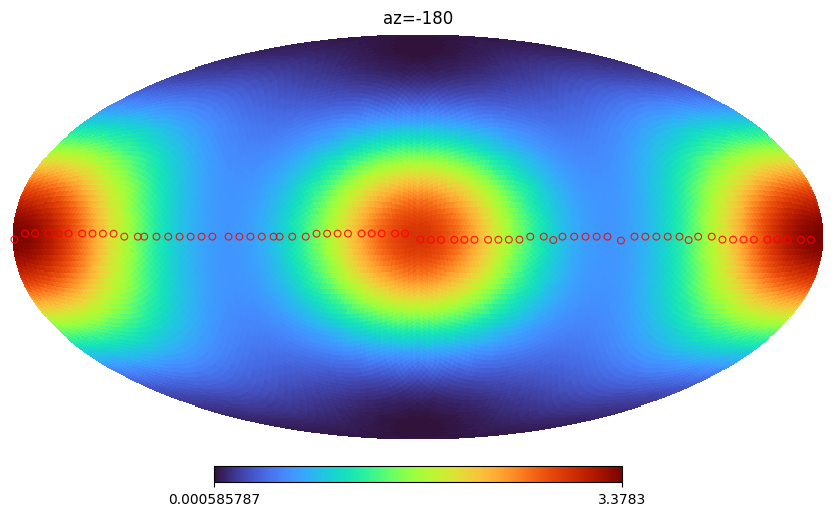

<Figure size 640x480 with 0 Axes>

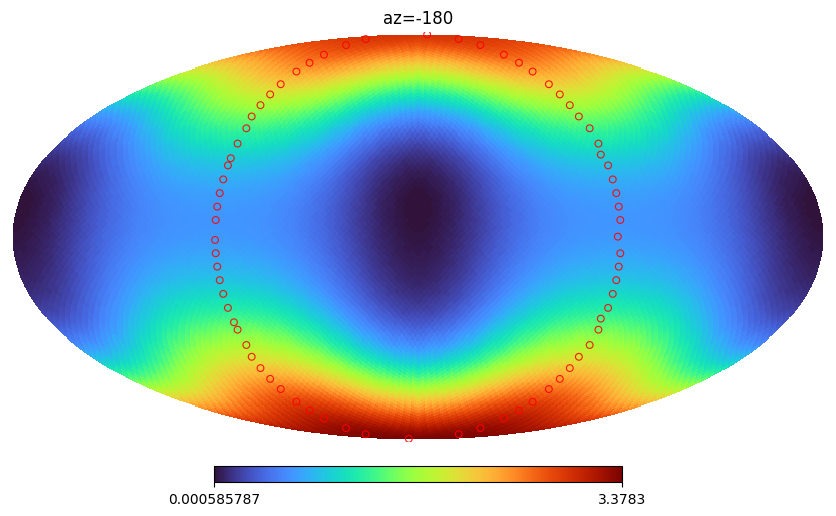

In [166]:
# az1 = test_az * -100
# az2 = az1 + 180.0 
# tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([best_x, best_y, -1]))
# _, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=az_rad, el=el_rad, E1=txe1, E2=txe2)
# tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([0.2, 0, -1]))
# _, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=np.deg2rad(test_az*-100), el=np.deg2rad(test_el), E1=txe1, E2=txe2)
hit_map = m_phi + m_th

test_n = 360
# test_n = 72
# test_bound = 90
test_bound = test_n//2
# test_bound = 72
# test_1half = np.linspace(-test_bound, 0, test_n, endpoint=True)
test_1half = np.linspace(-test_bound, 0, 36, endpoint=False)
# test_1half = np.linspace(0, test_bound, test_n, endpoint=True)
# test_2half = np.linspace(181, 260, test_n, endpoint=True)
# test_2half = np.linspace(test_bound+1, test_bound*2, test_n, endpoint=True)
# test_2half = np.linspace(1, test_bound, test_n, endpoint=False)
test_2half = np.linspace(0, test_bound, 36, endpoint=False)
test_el = np.concatenate((test_1half, test_2half))
test_az = np.ones_like(test_el)
# Inputs:
#   hit_map : 1D array, length = 12 * nside**2
#   hit_pxs     : 1D array of pixel IDs from your sim (JAX or NumPy)
nest = False  # set True if your map & indices are NESTED

pix   = np.asarray(hit_pxs, dtype=np.int64)
nside = healpy.npix2nside(hit_map.size)

def hit_marker(hmap, hpix, az_title=None, rot=(0,0,0), save=False):
    if az_title != None:
        az = az_title
    else:
        az = None
    # az = az_title[0]
    plt.figure()
    healpy.mollview(hmap, rot=rot, nest=nest, title=f"az={az}", cmap="turbo")
    pix   = np.asarray(hpix, dtype=np.int64)
    upix, counts = np.unique(pix, return_counts=True)
    theta, phi   = healpy.pix2ang(nside, upix, nest=nest)     # radians
    # lon          = np.degrees(phi)                        # [0, 360)
    # lat          = 90.0 - np.degrees(theta)               # [-90, 90]
    lon, lat = healpy.pix2ang(DEFAULT_NSIDE, upix, nest=nest, lonlat=True)
    
    sizes = 24  # e.g., 10 + 40*np.sqrt(counts / counts.max())
    healpy.projscatter(
        lon, lat, lonlat=True,
        s=sizes, marker="o",
        facecolors="none", edgecolors="red", linewidths=0.8, alpha=0.9)
    
    # plt.show()
    if save!=False:
        plt.savefig(outfile + 'trajectory/' + f'az={az}.png')
        plt.show()
    else:
        plt.show()
    

# # 1) Base map (values unchanged)
# healpy.mollview(hit_map, nest=nest, title="Hit pixels overlay")

# # 2) Overlay the unique hit pixels as red rings (size optional)
# upix, counts = np.unique(pix, return_counts=True)
# theta, phi   = healpy.pix2ang(nside, upix, nest=nest)     # radians
# # lon          = np.degrees(phi)                        # [0, 360)
# # lat          = 90.0 - np.degrees(theta)               # [-90, 90]
# lon, lat = healpy.pix2ang(DEFAULT_NSIDE, hit_pxs, nest=nest, lonlat=True)

# # Fixed-size rings (donut markers); or scale by counts if you like
# sizes = 24  # e.g., 10 + 40*np.sqrt(counts / counts.max())
# healpy.projscatter(
#     lon, lat, lonlat=True,
#     s=sizes, marker="o",
#     facecolors="none", edgecolors="red", linewidths=0.8, alpha=0.9
# )

# plt.show()


def tracer(hmap, coord, el, az, rot, az_title=None, save=False):
    tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=coord)
    _, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=np.deg2rad(az), el=np.deg2rad(el), E1=txe1, E2=txe2)
    hit_marker(hmap, hit_pxs, az_title, rot=rot, save=save)
    

# hit_marker(hit_map, hit_pxs)

# tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([0.2, 0, -1]))
# _, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=np.deg2rad(test_az*100), el=np.deg2rad(test_el), E1=txe1, E2=txe2)

# hit_marker(hit_map, hit_pxs)

az_const = -180
az_corre = 0
coord = jnp.array([-0.0, 0, -1])
# coord = jnp.array([-10.0, 30, -1])
# coord = jnp.array([-30.0,10.0,-1]) 
# coord = jnp.array([30.0, 10.0,-1]) 
# coord = heading_from_meters(2895, 965, z_rx=97, z_tx=0.5)
# coord = heading_from_meters(2, 2, z_rx=97, z_tx=0.5)

# rx_true._theta_flip_to_data = True
rx_true._theta_flip_to_data = False

tracer(hit_map, coord, test_el, (test_az*az_const ) + az_corre, rot=(0, 90, 0), az_title=az_const, save=False)
# tracer(rot_th + rot_ph, coord, test_el, (test_az*az_const ) + az_corre, rot=(0, 90, 0), az_title=az_const, save=False)
# tracer(m_phi, coord, test_el, (test_az*az_const ) + az_corre, rot=(0,0,0)  , az_title=az_const)
tracer(hit_map, coord, test_el, (test_az*az_const ) + az_corre, rot=(0,0,0), az_title=az_const)
# tracer(rot_th + rot_ph, coord, test_el, (test_az*az_const ) + az_corre, rot=(0,0,0), az_title=az_const)
# tracer(hit_map, coord, test_el, (test_az*-az_const) + az_corre)

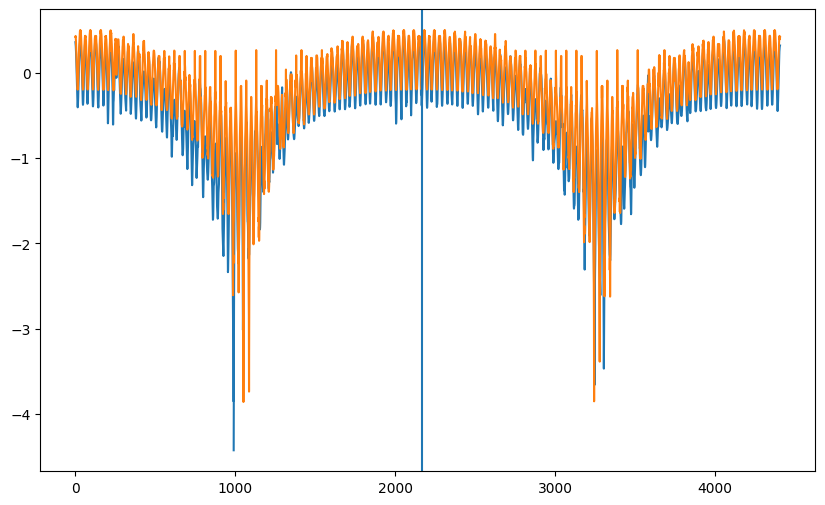

In [167]:
plt.figure(figsize=(10, 6))
plt.plot(np.log10(rot))
plt.plot(np.log10(sim_p * sim_norm))
plt.axvline((rot.shape[0] // 2) - 35)
plt.show()

In [1354]:
az_0_ind = rot.shape[0] // 2 - 35 ## from symmetry, it looks like this is the point where az hits 0 degrees on both data and sim


2169

In [200]:
def _sqrt_safe(x):
    # guard tiny negative due to numeric noise
    return jnp.sqrt(jnp.maximum(x, 0.0))

def _phase_from_delta(delta, float_dtype):
    # returns exp(1j*delta) with the right dtype for JAX
    return jnp.exp(1j * jnp.asarray(delta, dtype=float_dtype))


def power_transmitter_coherent(
    rx: RotatingAntenna,
    tx: TransmitterAntenna,
    R, th, phi, px,
    pwr_beam_th, pwr_beam_phi,
    delta_phi: float = 0.0,
):
    """
    Coherent receive model:
      P = | sqrt(G_th)*E_th + exp( i*delta_phi )*sqrt(G_phi)*E_phi |^2
    where E_th, E_phi are complex projections of the TX field.

    Args:
      delta_phi: optional relative phase (radians) applied to the phi-port
                 before summation (use this to model rx cross-phase).
    """
    # Complex E-field at the RX in world frame, rotated into RX basis
    E = tx.E_rotated(R)  # complex 3-vector (E1/E2 may be complex)

    # Unit vectors (real), cast to complex to match E
    th_hat = rx.th_hat(th, phi).astype(E.dtype)
    phi_hat = rx.phi_hat(th, phi).astype(E.dtype)

    # Complex projections onto the spherical basis at look (th,phi)
    E_th  = jnp.dot(E, th_hat)   # complex scalar
    E_phi = jnp.dot(E, phi_hat)  # complex scalar

    # Voltage gains from power patterns
    # (Use dynamic_index_in_dim if you call this inside a jit/vmap with px scalar)
    px_i = jax.lax.convert_element_type(px, jnp.int32)
    Gth  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px_i, axis=0, keepdims=False)
    Gphi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px_i, axis=0, keepdims=False)

    a_th  = _sqrt_safe(Gth).astype(E.real.dtype)
    a_phi = _sqrt_safe(Gphi).astype(E.real.dtype)

    # Optional relative phase between the two ports
    ph = _phase_from_delta(delta_phi, E.real.dtype)

    # Coherent voltage sum and detected power
    V = a_th * E_th + (a_phi * ph) * E_phi
    return (V * V.conj()).real


def power_transmitter_coherent_jax_pure(
    rx: RotatingAntenna, tx: TransmitterAntenna,
    rot_mx, th_tx, phi_tx, px,
    pwr_beam_th, pwr_beam_phi,
    delta_phi: float = 0.0,
):
    """
    JIT/vmap-friendly pure function variant of the coherent model above.
    """
    E = tx.E_rotated(rot_mx)
    th_hat  = rx.th_hat(th_tx,  phi_tx).astype(E.dtype)
    phi_hat = rx.phi_hat(th_tx, phi_tx).astype(E.dtype)

    E_th  = jnp.dot(E, th_hat)
    E_phi = jnp.dot(E, phi_hat)

    px = jax.lax.convert_element_type(px, jnp.int32)
    Gth  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
    Gphi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)

    a_th  = _sqrt_safe(Gth).astype(E.real.dtype)
    a_phi = _sqrt_safe(Gphi).astype(E.real.dtype)
    ph = _phase_from_delta(delta_phi, E.real.dtype)

    V = a_th * E_th + (a_phi * ph) * E_phi
    return (V * V.conj()).real


@jax.jit
def simulate_powers_vmap_coherent(
    rx, tx, az, el,
    pwr_beam_th=None, pwr_beam_phi=None,
    delta_phi: float = 0.0,
):
    """
    Vectorized coherent simulation across arrays of (az, el).
    """
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi

    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)

    def _one(R, th, ph, px):
        return power_transmitter_coherent_jax_pure(
            rx, tx, R, th, ph, px,
            pwr_beam_th=pwr_beam_th,
            pwr_beam_phi=pwr_beam_phi,
            delta_phi=delta_phi,
        )

    P = jax.vmap(_one)(Rs, ths, phis, pxs)
    return P, pxs


In [390]:
# Example TX: linear basis with a phase on E2 to create an arbitrary polarization
coord = [0.001, 0.0, -1]
tx_true = TransmitterAntenna(E1=1.01 + 0.52j, E2=0.5*jnp.exp(1j*0.5), heading_top=coord)

# Simulate over many az/el with coherent combining
P_coh, pxs = simulate_powers_vmap_coherent(
    rx_true, tx_true, az_inds, el_inds, delta_phi=jnp.deg2rad(0.0)
)

# Compare to your existing incoherent result if you like:
P_incoh, _ = simulate_powers_vmap(rx_true, tx_true, az_inds, el_inds, rx_true.pwr_beam_th, rx_true.pwr_beam_phi)
P_incoh_norm = 1/np.mean(P_incoh, axis=0)

0.14660531870285778


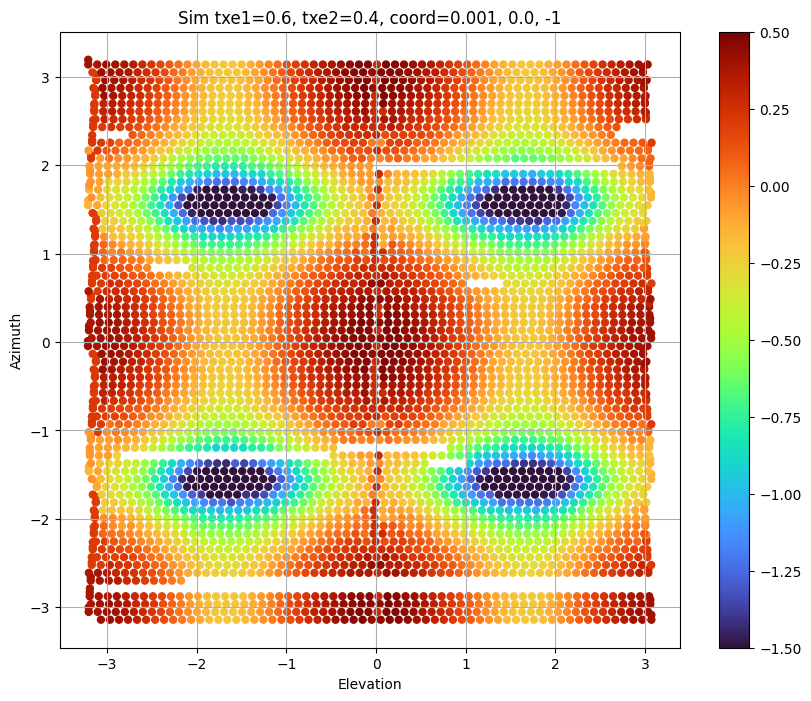

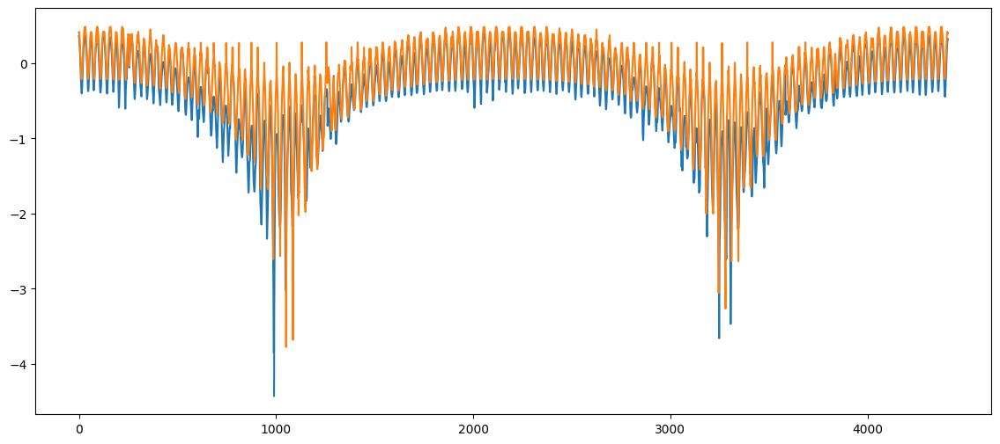

In [394]:
print(np.mean(np.abs(rot-(P_incoh*P_incoh_norm))**2))
plt.figure(figsize=(10,8))
# _ = plt.scatter(el_use, az_use, c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.scatter(el_inds, az_inds, c=np.log10(P_incoh*P_incoh_norm), s=25, cmap='turbo', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds, az_inds, c=(sim_p*sim_norm), s=25, cmap='turbo')#, vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds, az_inds, c=np.log10(sim_p), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds[right], az_inds[right], c=np.log10(sim_p * sim_norm)[right], s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=np.log10(filled), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.az_deg[fitter.inds], fitter.el_deg[fitter.inds], c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.xlabel('Elevation')
_ = plt.ylabel('Azimuth')
_ = plt.grid()
_ = plt.title(f'Sim {txe1=}, {txe2=}, coord={coord[0]}, {coord[1]}, {coord[2]}')
_ = plt.colorbar()

plt.figure(figsize=(14, 6))
plt.plot(np.log10(rot))
plt.plot(np.log10(P_incoh*P_incoh_norm))
# plt.plot(np.log10(rot - (P_incoh*P_incoh_norm)))
plt.show()

In [873]:
def heading_from_meters(x_m, y_m, z_rx=97.0, z_tx=0.5):
    v = jnp.array([x_m, y_m, z_tx - z_rx], dtype=dtype_r)
    return v / jnp.linalg.norm(v)
def heading_to_meters(hx, hy, hz, z_rx=97.0, z_tx=0.5):
    dz = z_tx - z_rx
    return (hx / hz) * dz, (hy / hz) * dz  # (x_m, y_m)


heading_from_meters(2895, 965, z_rx=97, z_tx=0.5)

Array([ 0.94820931,  0.31606977, -0.03160698], dtype=float64)

In [168]:
# P_data: your measured power samples aligned to (az_inds, el_inds)
# (If needed, z-score both arrays first; we only care about shape.)
P_data = np.asarray(rot).ravel()

for theta_flip in [False, True]:
    rx_true._theta_flip_to_data = theta_flip
    for az_sign in [1, -1]:  # +1 = as-is, -1 = flip az sense once
        P_sim, _ = simulate_powers_vmap(
            rx=rx_true, tx=tx_true,
            az=az_sign * az_inds, el=el_inds,
            E1=txe1, E2=txe2
        )
        P_sim = np.asarray(P_sim).ravel()
        # shape similarity (correlation)
        r = np.corrcoef(P_sim, P_data)[0,1]
        print(f"theta_from_down={theta_flip}, az_flipped={az_sign<0}  ->  corr={r:.3f}")


theta_from_down=False, az_flipped=False  ->  corr=0.949
theta_from_down=False, az_flipped=True  ->  corr=0.948
theta_from_down=True, az_flipped=False  ->  corr=0.909
theta_from_down=True, az_flipped=True  ->  corr=0.908


In [169]:
def quick_px_probe(rx, tx, az_deg=30, el_deg=45):
    az = jnp.deg2rad(az_deg); el = jnp.deg2rad(el_deg)
    R = rx.rotation(az, el)

    def one(v):
        tx.heading_top = jnp.asarray(v, dtype=dtype_r)
        th, phi = tx.heading_thphi(R)
        px = rx.ang2pix(th, phi)
        return float(th), float(phi), int(px), float(rx.pwr_beam_th[px]), float(rx.pwr_beam_phi[px])

    cases = {
        "+x tilt":  [ 10.0,  0.0, -97.0],
        "+y tilt":  [  0.0, 10.0, -97.0],
        "-x tilt":  [-10.0,  0.0, -97.0],
        "-y tilt":  [  0.0,-10.0, -97.0],
        "down":     [  0.0,  0.0, -97.0],
    }
    for name, v in cases.items():
        th, phi, px, gth, gph = one(v)
        print(f"{name:8s} -> th={np.degrees(th):6.1f}°, phi={np.degrees(phi)%360:6.1f}°, "
              f"px={px:6d}, g_th={gth:.3f}, g_phi={gph:.3f}")

quick_px_probe(rx_true, tx_true)

+x tilt  -> th= 134.7°, phi= 248.3°, px=  1822, g_th=10856884.618, g_phi=695356042.033
+y tilt  -> th= 140.9°, phi= 240.0°, px=  1369, g_th=29487802.250, g_phi=727019989.016
-x tilt  -> th= 134.7°, phi= 231.7°, px=  1817, g_th=29044643.983, g_phi=538542249.691
-y tilt  -> th= 129.1°, phi= 240.0°, px=  2325, g_th=10108231.571, g_phi=537179517.499
down     -> th= 135.0°, phi= 240.0°, px=  1701, g_th=20808319.666, g_phi=653681382.738


In [1146]:
def tx_with_pol(angle_rad):
    return TransmitterAntenna(E1=jnp.cos(angle_rad), E2=jnp.sin(angle_rad),
                              heading_top=coord)
angles = np.linspace(0, np.pi, 181)
best = (-1, None)
az_use = -az_inds
rx_true._theta_flip_to_data = False      # no theta flip

for a in angles:
    tx_try = TransmitterAntenna(E1=jnp.cos(a), E2=jnp.sin(a), heading_top=coord)
    P_sim, _ = simulate_powers_vmap(rx=rx_true, tx=tx_try,
                                    az=az_use, el=el_inds, E1=txe1, E2=txe2)
    r = np.corrcoef(np.asarray(P_sim).ravel(), np.asarray(P_data).ravel())[0,1]
    if r > best[0]: best = (r, a)
print("best corr", best[0], "at pol angle (deg)", np.degrees(best[1]))


best corr 0.7680133407208181 at pol angle (deg) 59.99999999999999


In [170]:
# --- helper: JAX-safe complex phasor e^{j delta} ---
def expj(delta):
    # delta: jnp.float64
    # returns: jnp.complex128
    return jnp.cos(delta).astype(jnp.complex128) + \
           jnp.asarray(1j, dtype=jnp.complex128) * jnp.sin(delta).astype(jnp.complex128)

def power_transmitter_complex(rx, tx, rot_mx, th_tx, phi_tx, px,
                              pwr_beam_th, pwr_beam_phi):
    # Complex E at RX/body frame
    E = tx.E_rotated(rot_mx)  # complex 3-vector

    # Make sure the basis is complex too (same dtype)
    th_hat  = rx.th_hat(th_tx, phi_tx).astype(E.dtype)
    phi_hat = rx.phi_hat(th_tx, phi_tx).astype(E.dtype)

    # Projections; |.|^2 via conj product
    Eth  = jnp.vdot(th_hat,  E)    # conj(th_hat) · E
    Ephi = jnp.vdot(phi_hat, E)

    gth  = pwr_beam_th[px]
    gphi = pwr_beam_phi[px]
    return gth * (Eth * Eth.conj()).real + gphi * (Ephi * Ephi.conj()).real

def simulate_powers_complex(rx, tx, az, el, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi
    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)
    def _one(R, th, ph, px):
        px = jax.lax.convert_element_type(px, jnp.int32)
        return power_transmitter_complex(rx, tx, R, th, ph, px, pwr_beam_th, pwr_beam_phi)
    return jax.vmap(_one)(Rs, ths, phis, pxs)

# Conventions we settled on:
# - keep your rotation as: return R_el @ R_az
# - no theta flip
# - flip az sense once
az_use = az_inds
el_use =  el_inds

alpha = jnp.deg2rad(60.0)  # from your best linear angle ≈60°
best = (-1.0, None)

for ddeg in np.linspace(0.0, 360.0, 181):
    delta = jnp.deg2rad(ddeg).astype(jnp.float64)

    # JAX-native complex coefficients
    E1 = jnp.cos(alpha).astype(jnp.complex128)                    # ~0.5 + 0j
    E2 = jnp.sin(alpha).astype(jnp.complex128) * expj(delta)      # ~0.866 * e^{jδ}

    txc = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)     # coord as before

    P_sim_c = simulate_powers_complex(rx_true, txc, az_use, el_use)
    r = np.corrcoef(np.asarray(P_sim_c).ravel(), np.asarray(P_data).ravel())[0,1]

    if r > best[0]:
        best = (r, float(ddeg))

print("best corr with relative phase δ:", best[0], "at δ(deg) =", best[1])


best corr with relative phase δ: 0.7735588818620105 at δ(deg) = 146.0


In [ ]:
alpha = jnp.deg2rad(60.0)           # amplitude angle you found
delta = jnp.deg2rad(158.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (jnp.sin(alpha) *
      (jnp.cos(delta) + 1j*jnp.sin(delta))).astype(jnp.complex128)
tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)  # coord within ±20 m, z≈0.5-97


In [171]:
import numpy as np
import jax
import jax.numpy as jnp

# Use your existing: px_th_ph_vmapped, RotatingAntenna, TransmitterAntenna

def expj(delta):
    # JAX-safe e^{j delta}
    return (jnp.cos(delta).astype(jnp.complex128)
            + jnp.asarray(1j, dtype=jnp.complex128) * jnp.sin(delta).astype(jnp.complex128))

def corrcoef_1d(a, b):
    a = np.asarray(a).ravel()
    b = np.asarray(b).ravel()
    m = np.isfinite(a) & np.isfinite(b)
    if not m.any(): return np.nan
    return np.corrcoef(a[m], b[m])[0, 1]

def power_transmitter_complex(rx, tx, rot_mx, th_tx, phi_tx, px,
                              pwr_beam_th, pwr_beam_phi):
    E = tx.E_rotated(rot_mx)  # complex (3,)
    th_hat  = rx.th_hat(th_tx, phi_tx).astype(E.dtype)
    phi_hat = rx.phi_hat(th_tx, phi_tx).astype(E.dtype)
    Eth  = jnp.vdot(th_hat,  E)   # conj(th_hat)·E
    Ephi = jnp.vdot(phi_hat, E)
    gth  = pwr_beam_th[px]
    gphi = pwr_beam_phi[px]
    return gth * (Eth * Eth.conj()).real + gphi * (Ephi * Ephi.conj()).real

@jax.jit
def simulate_powers_complex(rx, tx, az, el, pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi
    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)
    def _one(R, th, ph, px):
        px = jax.lax.convert_element_type(px, jnp.int32)
        return power_transmitter_complex(rx, tx, R, th, ph, px, pwr_beam_th, pwr_beam_phi)
    return jax.vmap(_one)(Rs, ths, phis, pxs)


# Measured power aligned to (az_use, el_use)
P_ref = np.asarray(P_data).ravel()

def sweep_pol(rx, coord, alphas_deg, deltas_deg):
    best = (-1.0, None, None)
    for adeg in alphas_deg:
        alpha = jnp.deg2rad(adeg).astype(jnp.float64)
        cA = jnp.cos(alpha).astype(jnp.complex128)
        sA = jnp.sin(alpha).astype(jnp.complex128)
        for ddeg in deltas_deg:
            delta = jnp.deg2rad(ddeg).astype(jnp.float64)
            E1 = cA
            E2 = sA * expj(delta)
            txc = TransmitterAntenna(E1=E1, E2=E2,
                                     heading_top=jnp.asarray(coord, dtype=jnp.float64))
            P_sim = simulate_powers_complex(rx, txc, az_use, el_use)
            r = corrcoef_1d(P_sim, P_ref)
            if r > best[0]:
                best = (r, adeg, ddeg)
    return best

# Start with your physically plausible coord (±20 m)
z_rx, z_tx = 97.0, 0.5
coord0 = heading_from_meters(10, -5, z_tx-z_rx)
# coord0 = jnp.array([10.0, -5.0, z_tx - z_rx], dtype=jnp.float64)

# Coarse sweep
alphas_c = np.arange(0.0, 91.0, 3.0)      # 0..90 deg
deltas_c = np.arange(0.0, 361.0, 6.0)     # 0..360
best_c = sweep_pol(rx_true, coord0, alphas_c, deltas_c)
print("coarse best (r, α, δ) =", best_c)

# Fine sweep around coarse best
r0, a0, d0 = best_c
alphas_f = np.arange(max(0, a0-6), min(90, a0+6)+0.01, 0.5)
# wrap δ and build local window with wrap-around
d_lo = (d0 - 12) % 360; d_hi = (d0 + 12) % 360
if d_lo < d_hi:
    deltas_f = np.arange(d_lo, d_hi+0.01, 0.5)
else:
    deltas_f = np.concatenate([np.arange(d_lo, 360.0, 0.5), np.arange(0.0, d_hi+0.01, 0.5)])
best_f = sweep_pol(rx_true, coord0, alphas_f, deltas_f)
print("fine best (r, α, δ)  =", best_f)

r_pol, alpha_best_deg, delta_best_deg = best_f


coarse best (r, α, δ) = (0.7450891620209995, 33.0, 102.0)
fine best (r, α, δ)  = (0.745287140775251, 33.0, 100.0)


In [172]:
# Fix polarization at the best from Pass 1
alpha = jnp.deg2rad(alpha_best_deg).astype(jnp.float64)
delta = jnp.deg2rad(delta_best_deg).astype(jnp.float64)
E1_best = jnp.cos(alpha).astype(jnp.complex128)
E2_best = (jnp.sin(alpha).astype(jnp.complex128) * expj(delta))

def sweep_xy(rx, E1c, E2c, xs, ys, z_rx=97.0, z_tx=0.5):
    best = (-1.0, None, None)
    for x in xs:
        for y in ys:
            coord = jnp.array([x, y, z_tx - z_rx], dtype=jnp.float64)
            txc = TransmitterAntenna(E1=E1c, E2=E2c, heading_top=coord)
            P_sim = simulate_powers_complex(rx, txc, az_use, el_use)
            r = corrcoef_1d(P_sim, P_ref)
            if r > best[0]:
                best = (r, float(x), float(y))
    return best

# Coarse XY: 2 m steps
xs_c = np.arange(-20.0, 20.0+0.1, 2.0)
ys_c = np.arange(-20.0, 20.0+0.1, 2.0)
best_xy_c = sweep_xy(rx_true, E1_best, E2_best, xs_c, ys_c, z_rx=z_rx, z_tx=z_tx)
print("coarse XY best (r, x, y) =", best_xy_c)

# Fine XY: 1 m steps around coarse best
r_xy, x0, y0 = best_xy_c
xs_f = np.arange(x0-2.0, x0+2.0+0.1, 1.0)
ys_f = np.arange(y0-2.0, y0+2.0+0.1, 1.0)
best_xy_f = sweep_xy(rx_true, E1_best, E2_best, xs_f, ys_f, z_rx=z_rx, z_tx=z_tx)
print("fine XY best (r, x, y)   =", best_xy_f)

r_final, x_best, y_best = best_xy_f
print("\nFINAL best:")
print(f"  correlation  = {r_final:.6f}")
print(f"  polarization = alpha={alpha_best_deg:.2f} deg, delta={delta_best_deg:.2f} deg")
print(f"  location     = x={x_best:.2f} m, y={y_best:.2f} m (z fixed by {z_rx:.1f}→{z_tx:.1f} m)")


coarse XY best (r, x, y) = (0.9113406235322844, 0.0, 2.0)
fine XY best (r, x, y)   = (0.9113406235322844, 0.0, 2.0)

FINAL best:
  correlation  = 0.911341
  polarization = alpha=33.00 deg, delta=100.00 deg
  location     = x=0.00 m, y=2.00 m (z fixed by 97.0→0.5 m)


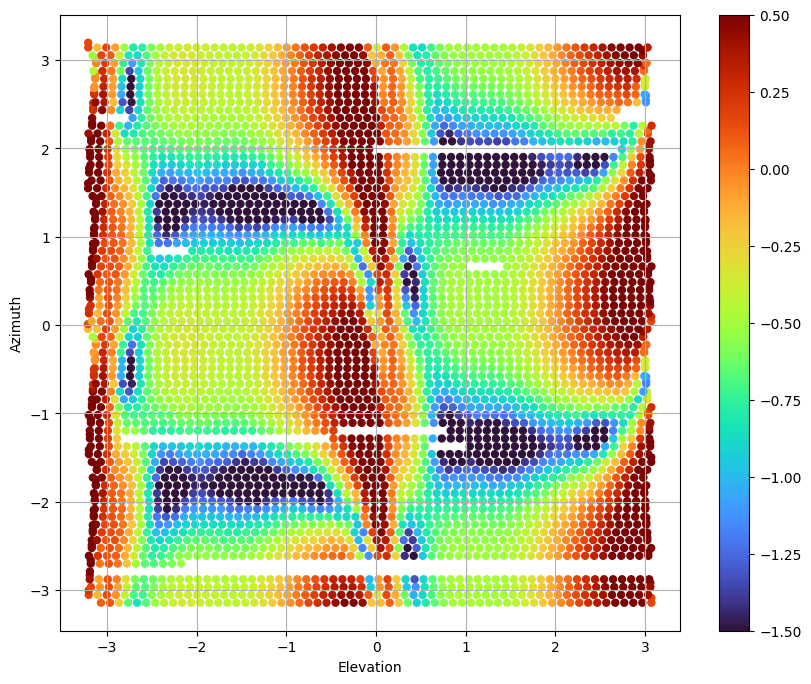

In [173]:
alpha = jnp.deg2rad(61.0)
delta = jnp.deg2rad(180.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (jnp.sin(alpha) * (jnp.cos(delta) + 1j*jnp.sin(delta))).astype(jnp.complex128)

# Location (meters → heading vector)
# coord = heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)  # gives [22, 5, -96.5]
coord = heading_from_meters(20.0, 1.5, z_rx=97.0, z_tx=0.5)  # gives [22, 5, -96.5]
tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)
sim_p = simulate_powers_complex(rx_true, tx_true, az_use, el_use)
sim_norm = 1/jnp.mean(sim_p, axis=0)

plt.figure(figsize=(10,8))
# _ = plt.scatter(el_use, az_use, c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.scatter(el_inds, az_inds, c=np.log10(sim_p*sim_norm), s=25, cmap='turbo', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds, az_inds, c=np.log10(sim_p), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(el_inds[right], az_inds[right], c=np.log10(sim_p * sim_norm)[right], s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.el_deg[fitter.inds], fitter.az_deg[fitter.inds], c=np.log10(filled), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
# _ = plt.scatter(fitter.az_deg[fitter.inds], fitter.el_deg[fitter.inds], c=np.log10(sim_p * sim_norm), s=25, cmap='plasma', vmax=0.5, vmin=-1.5)
_ = plt.xlabel('Elevation')
_ = plt.ylabel('Azimuth')
_ = plt.grid()
# _ = plt.title(f'Sim {txe1=}, {txe2=}, coord={coord[0]}, {coord[1]}, {coord[2]}')
_ = plt.colorbar()

In [174]:
# radians from your encoders
az_raw = np.deg2rad(fitter.az_deg[fitter.inds])
el_raw = np.deg2rad(fitter.el_deg[fitter.inds])

candidates = {
    "baseline":         ( -az_raw,          el_raw          ),  # what you used
    "flip el":          ( -az_raw,         -el_raw          ),
    "flip el, az+90":   ( -(az_raw+np.pi/2), -el_raw        ),
    "flip el, az-90":   ( -(az_raw-np.pi/2), -el_raw        ),
    "flip el, az+180":  ( -(az_raw+np.pi),   -el_raw        ),
}

for name, (az_use, el_use) in candidates.items():
    P_sim = simulate_powers_complex(rx_true, tx_true, az_use, el_use)
    r = np.corrcoef(np.asarray(P_sim).ravel(), np.asarray(P_data).ravel())[0,1]
    print(f"{name:18s} -> corr={r:.3f}")


baseline           -> corr=0.189
flip el            -> corr=0.218
flip el, az+90     -> corr=0.395
flip el, az-90     -> corr=0.395
flip el, az+180    -> corr=0.218


In [175]:
signs   = [1.0, -1.0]
offsets = [0.0, np.pi/2, np.pi, 3*np.pi/2]
orders  = ["world", "body"]   # world = your R_el @ R_az, body = yaw then about body axis
el_axes = ["X", "Y"]

def simulate_with(rx, tx, az_use, el_use, order, el_axis):
    old_el_axis = rx.el_axis
    rx.el_axis = jnp.array([1,0,0]) if el_axis=="X" else jnp.array([0,1,0])
    old_rotation = rx.rotation
    if order=="world":
        def rotation(az,el):
            R_az=rot_m(az, rx.az_axis); R_el=rot_m(el, rx.el_axis); return R_el @ R_az
    else:
        def rotation(az,el):
            R_az=rot_m(az, rx.az_axis); ax_world=R_az @ rx.el_axis
            R_el=rot_m(el, ax_world); return R_el @ R_az
    rx.rotation = rotation
    P = simulate_powers_complex(rx, tx, az_use, el_use)
    rx.rotation = old_rotation; rx.el_axis = old_el_axis
    return P

best = (-1.0, None)
az_raw = np.deg2rad(fitter.az_deg[fitter.inds]); el_raw = np.deg2rad(fitter.el_deg[fitter.inds])
P_ref  = np.asarray(P_data).ravel()
base_coord = heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)

# your best pol so far:
alpha, delta = np.deg2rad(61.0), np.deg2rad(180.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (jnp.sin(alpha)*(jnp.cos(delta)+1j*jnp.sin(delta))).astype(jnp.complex128)

for saz in signs:
  for sel in signs:
    for oaz in offsets:
      for oel in offsets:
        for svec in [1.0, -1.0]:
          for order in orders:
            for ax in el_axes:
              az_use = saz*az_raw + oaz
              el_use = sel*el_raw + oel
              tx = TransmitterAntenna(E1=E1, E2=E2, heading_top=svec*base_coord)
              P_sim = simulate_with(rx_true, tx, az_use, el_use, order, ax)
              r = np.corrcoef(np.asarray(P_sim).ravel(), P_ref)[0,1]
              tag = dict(az_sign=int(saz), el_sign=int(sel),
                         az_off_deg=int(np.degrees(oaz)%360),
                         el_off_deg=int(np.degrees(oel)%360),
                         heading_sign=int(svec),
                         order=order, el_axis=ax)
              if r > best[0]:
                  best = (r, tag)
              # optional: print(tag, r)
print("BEST:", best)


BEST: (0.8665623319599852, {'az_sign': -1, 'el_sign': -1, 'az_off_deg': 270, 'el_off_deg': 0, 'heading_sign': -1, 'order': 'world', 'el_axis': 'Y'})


corr (best-conventions): 0.18701778165796018


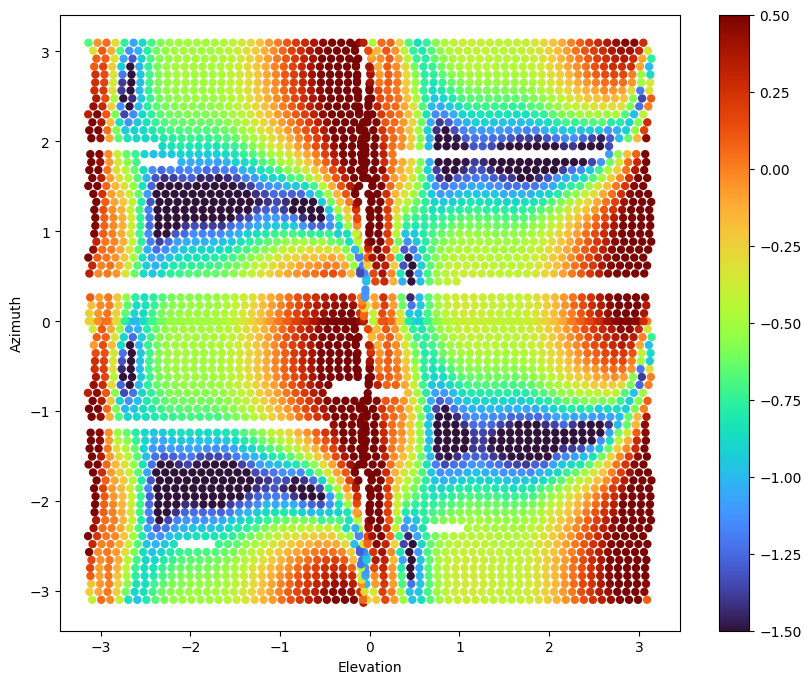

In [178]:
# --- 0) angles from encoders (deg -> rad)
az_raw = np.deg2rad(fitter.az_deg[fitter.inds])
el_raw = np.deg2rad(fitter.el_deg[fitter.inds])

# --- 1) apply the winning transforms
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
az_use = wrap(az_raw + np.pi)   # +180°
el_use = wrap(el_raw + np.pi)   # +180°

# --- 2) heading: NEGATE meters->vector  (TX→RX)
coord = -heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)

# --- 3) polarization: α≈61°, δ≈180°  (linear at ~61°; E2 is negative)
alpha = np.deg2rad(61.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)        # ≈ +0.485
E2 = (-jnp.sin(alpha)).astype(jnp.complex128)     # ≈ −0.875

tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# --- 4) keep rotation as world-X elevation (your original): return R_el @ R_az
# rx_true._theta_flip_to_data = False   # (explicitly off)

# --- 5) simulate with the complex pipeline
P_sim = simulate_powers_complex(rx_true, tx_true, az_use, el_use)
r = np.corrcoef(np.asarray(P_sim).ravel(), np.asarray(P_data).ravel())[0,1]
print("corr (best-conventions):", r)
P_norm = 1/np.mean(P_sim, axis=0)
# --- 6) plot using the SAME az_use/el_use you simulated with
plt.figure(figsize=(10,8))
plt.scatter(el_use, az_use, c=np.log10(P_sim*P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()


In [179]:
def with_rot_flips(rx, tx, az, el, flip_heading=False, flip_E=False):
    # save originals
    H = tx.heading_rotated
    E = tx.E_rotated

    if not flip_heading:
        def heading_rotated(R): return R.T @ tx.heading_top
    else:
        def heading_rotated(R): return R   @ tx.heading_top

    if not flip_E:
        def E_rotated(R): return R.T @ tx.E_top()
    else:
        def E_rotated(R): return R   @ tx.E_top()

    tx.heading_rotated = heading_rotated
    tx.E_rotated       = E_rotated

    P = simulate_powers_complex(rx, tx, az, el)

    # restore
    tx.heading_rotated = H
    tx.E_rotated       = E
    return P

labels = {
    (False, False): "LOS=Rᵀ, E=Rᵀ (current)",
    (True,  False): "LOS=R,   E=Rᵀ",
    (False, True ): "LOS=Rᵀ, E=R",
    (True,  True ): "LOS=R,   E=R"
}

for fh in (False, True):
    for fE in (False, True):
        P = with_rot_flips(rx_true, tx_true, az_use, el_use, flip_heading=fh, flip_E=fE)
        r = np.corrcoef(P.ravel(), np.asarray(P_data).ravel())[0,1]
        print(labels[(fh,fE)], "-> corr =", r)


LOS=Rᵀ, E=Rᵀ (current) -> corr = 0.18701778165796018
LOS=Rᵀ, E=R -> corr = 0.18701778165796018
LOS=R,   E=Rᵀ -> corr = 0.18701778165796018
LOS=R,   E=R -> corr = 0.18701778165796018


In [180]:
daz = np.deg2rad(np.linspace(-3,3,25))
delv = np.deg2rad(np.linspace(-3,3,25))

best = (-1, 0, 0)
for da in daz:
    for de in delv:
        P = simulate_powers_complex(rx_true, tx_true, az_use+da, el_use+de)
        r = np.corrcoef(P.ravel(), np.asarray(P_data).ravel())[0,1]
        if r > best[0]: best = (r, da, de)
print("best tiny offsets (deg): dAz=", np.degrees(best[1]), " dEl=", np.degrees(best[2]))


best tiny offsets (deg): dAz= -3.0000000000000004  dEl= -3.0000000000000004


In [181]:
import numpy as np
import jax
import jax.numpy as jnp

# Uses your az_use / el_use, rx_true, tx_true, and simulate helpers you already have.

def simulate_with_twist(rx, tx, az, el, psi_deg,
                        pwr_beam_th=None, pwr_beam_phi=None):
    if pwr_beam_th is None:  pwr_beam_th  = rx.pwr_beam_th
    if pwr_beam_phi is None: pwr_beam_phi = rx.pwr_beam_phi

    psi = jnp.deg2rad(psi_deg).astype(jnp.float64)
    c, s = jnp.cos(psi), jnp.sin(psi)

    Rs, ths, phis, pxs = px_th_ph_vmapped(rx, tx, az, el)

    def _one(R, th, ph, px):
        # complex E at RX in *body* frame (use your complex pipeline if you’re using δ)
        E = tx.E_rotated(R).astype(jnp.complex128)

        th_hat  = rx.th_hat(th, ph).astype(E.dtype)
        phi_hat = rx.phi_hat(th, ph).astype(E.dtype)

        # rotate the receive basis by ψ about r̂
        thh  =  c*th_hat + s*phi_hat
        phih = -s*th_hat + c*phi_hat

        Eth  = jnp.vdot(thh,  E)             # conj(thh)·E
        Ephi = jnp.vdot(phih, E)

        px = jax.lax.convert_element_type(px, jnp.int32)
        g_th  = jax.lax.dynamic_index_in_dim(pwr_beam_th,  px, axis=0, keepdims=False)
        g_phi = jax.lax.dynamic_index_in_dim(pwr_beam_phi, px, axis=0, keepdims=False)
        return g_th * (Eth*Eth.conj()).real + g_phi * (Ephi*Ephi.conj()).real

    return jax.vmap(_one)(Rs, ths, phis, pxs)

# quick sweep
P_ref = np.asarray(P_data).ravel()
best = (-1.0, None)
for psi in np.linspace(0.0, 180.0, 181):
    P_sim = simulate_with_twist(rx_true, tx_true, az_use, el_use, psi)
    r = np.corrcoef(np.asarray(P_sim).ravel(), P_ref)[0,1]
    if r > best[0]: best = (r, psi)
print("best corr with boresight twist ψ:", best)


best corr with boresight twist ψ: (0.5599197541168524, 66.0)


In [182]:
candidates = {
    "as_is":      (rx_true.pwr_beam_th, rx_true.pwr_beam_phi),
    "swap":       (rx_true.pwr_beam_phi, rx_true.pwr_beam_th),
    "swap+signφ": (rx_true.pwr_beam_phi, -rx_true.pwr_beam_th),  # if sign conventions differ
}

for name, (pth, pph) in candidates.items():
    P_sim = simulate_with_twist(rx_true, tx_true, az_use, el_use, psi_deg=0.0,
                                pwr_beam_th=pth, pwr_beam_phi=pph)
    r = np.corrcoef(np.asarray(P_sim).ravel(), P_ref)[0,1]
    print(f"{name:12s} -> corr={r:.3f}")


as_is        -> corr=0.187
swap         -> corr=0.361
swap+signφ   -> corr=-0.032


In [183]:
psi0 = best[1]  # from step 1
psis = np.arange(max(0, psi0-5), min(180, psi0+5)+0.001, 0.25)
best2 = (-1.0, None)
for psi in psis:
    P_sim = simulate_with_twist(rx_true, tx_true, az_use, el_use, psi)
    r = np.corrcoef(np.asarray(P_sim).ravel(), P_ref)[0,1]
    if r > best2[0]: best2 = (r, psi)
print("fine ψ:", best2)


fine ψ: (0.5599589208931461, 65.75)


In [184]:
# angles from encoders (deg -> rad)
az_raw = np.deg2rad(fitter.az_deg[fitter.inds])
el_raw = np.deg2rad(fitter.el_deg[fitter.inds])

wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
az_use = wrap(az_raw + np.pi + np.deg2rad(1.0))  # +180° and +1°
el_use = wrap(el_raw + np.pi)                    # +180°

# heading: TX→RX (negated)
coord = -heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)

# polarization: α≈61°, δ≈180°  (real: E2 = -sin α)
alpha = np.deg2rad(61.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (-jnp.sin(alpha)).astype(jnp.complex128)
tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# rotation stays "world-X elevation"
# def rotation(self, az, el): return rot_m(el, X) @ rot_m(az, Z)

def proj_with_twist(rx, th, ph, E_body, psi_deg=1.25):
    psi = jnp.deg2rad(psi_deg).astype(E_body.dtype.type)
    c, s = jnp.cos(psi), jnp.sin(psi)
    th_hat  = rx.th_hat(th, ph).astype(E_body.dtype)
    phi_hat = rx.phi_hat(th, ph).astype(E_body.dtype)
    thh  =  c*th_hat + s*phi_hat
    phih = -s*th_hat + c*phi_hat
    Eth  = jnp.vdot(thh,  E_body)
    Ephi = jnp.vdot(phih, E_body)
    return Eth, Ephi

def power_with_twist(rx, tx, R, th, ph, px, pwr_beam_th, pwr_beam_phi, psi_deg=1.25):
    E_body = tx.E_rotated(R).astype(jnp.complex128)    # world->body via R.T (as you have)
    Eth, Ephi = proj_with_twist(rx, th, ph, E_body, psi_deg)
    gth  = pwr_beam_th[px]; gphi = pwr_beam_phi[px]
    return gth*(Eth*Eth.conj()).real + gphi*(Ephi*Ephi.conj()).real

def apply_mount_bias(rx, yaw0_deg=0.0, pitch0_deg=0.0, roll0_deg=0.0, mode="post"):
    yaw0   = jnp.deg2rad(yaw0_deg);  pit0 = jnp.deg2rad(pitch0_deg);  rol0 = jnp.deg2rad(roll0_deg)
    Z = jnp.array([0.,0.,1.]); Y = jnp.array([0.,1.,0.]); X = jnp.array([1.,0.,0.])

    Bz = rot_m(yaw0,   Z)
    By = rot_m(pit0,   Y)
    Bx = rot_m(rol0,   X)
    B  = Bx @ By @ Bz  # intrinsic roll→pitch→yaw about body axes

    base_rotation = rx.rotation  # keep your R_el @ R_az

    if mode == "post":
        # world = R * B * v_body  (beam/frame rotated relative to body)
        def rotation(az, el): return base_rotation(az, el) @ B
    else:
        # world = B * R * v_body  (mount base tilted in world)
        def rotation(az, el): return B @ base_rotation(az, el)

    return rotation  # returns a function(az, el)



# measured power (flatten for corr)
P_ref = np.asarray(P_data).ravel()

# coarse biases ±3° in roll/pitch, ±2° yaw; try both "post" and "pre"
rolls  = np.linspace(-3, 3, 13)
pits   = np.linspace(-3, 3, 13)
yaws   = np.linspace(-2, 2, 9)
modes  = ["post", "pre"]  # "post" usually represents beam-map frame twist; "pre" = base tilt

best = (-1.0, None)
for mode in modes:
    for r0 in rolls:
        for p0 in pits:
            for y0 in yaws:
                biased = apply_mount_bias(rx_true, y0, p0, r0, mode=mode)
                # Temporarily override rx.rotation
                R_save = rx_true.rotation
                rx_true.rotation = biased
                # simulate (complex) with your ψ twist
                Rs, ths, phis, pxs = px_th_ph_vmapped(rx_true, tx_true, az_use, el_use)
                def _one(R, th, ph, px):
                    px = jax.lax.convert_element_type(px, jnp.int32)
                    return power_with_twist(rx_true, tx_true, R, th, ph, px,
                                            rx_true.pwr_beam_th, rx_true.pwr_beam_phi, psi_deg=1.25)
                P_sim = jax.vmap(_one)(Rs, ths, phis, pxs)
                rx_true.rotation = R_save
                r = np.corrcoef(np.asarray(P_sim).ravel(), P_ref)[0,1]
                if r > best[0]:
                    best = (r, dict(mode=mode, roll=r0, pitch=p0, yaw=y0))
print("best mount bias:", best)


best mount bias: (0.28394989133298565, {'mode': 'pre', 'roll': -3.0, 'pitch': -3.0, 'yaw': -2.0})


corr (best-conventions): 0.22524134819524397


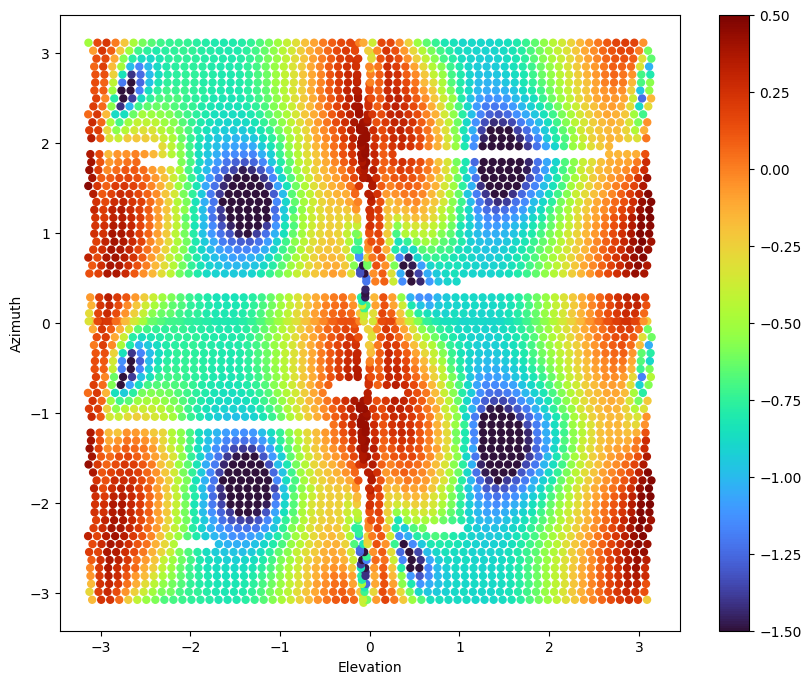

In [185]:
# --- 1) angle inputs ---
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
az_use = wrap(np.deg2rad(fitter.az_deg[fitter.inds]) + np.pi + np.deg2rad(1.0))
el_use = wrap(np.deg2rad(fitter.el_deg[fitter.inds]) + np.pi)

# --- 2) heading (TX→RX) ---
coord = -heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)

# --- 3) polarization ---
alpha = np.deg2rad(61.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (-jnp.sin(alpha)).astype(jnp.complex128)
tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)
rx_true = RotatingAntenna(beam_th=m_th, beam_phi=m_phi)

# --- 4) pre-bias B_pre (roll, pitch, yaw) ---
X = jnp.array([1.,0.,0.]); Y = jnp.array([0.,1.,0.]); Z = jnp.array([0.,0.,1.])
B_roll  = rot_m(jnp.deg2rad(-1.5), X)
B_pitch = rot_m(jnp.deg2rad( 3.0), Y)
B_yaw   = rot_m(jnp.deg2rad( 0.0), Z)
B_pre   = B_yaw @ B_pitch @ B_roll        # yaw∘pitch∘roll (intrinsic about body axes)

# --- 5) final rotation: world = B_pre @ (R_el @ R_az) ---
base_rotation = rx_true.rotation          # your original returns R_el @ R_az
def rotation_with_pre(az, el):
    return B_pre @ base_rotation(az, el)
rx_true.rotation = rotation_with_pre      # replace (ensure you don't also apply bias elsewhere)

# (Optional) boresight twist ψ≈1.25° inside your power projection
psi_deg = 1.25

P_sim = simulate_powers_complex(rx_true, tx_true, az_use, el_use)
r = np.corrcoef(np.asarray(P_sim).ravel(), np.asarray(P_data).ravel())[0,1]
print("corr (best-conventions):", r)

# --- 6) plot using the SAME az_use/el_use you simulated with
plt.figure(figsize=(10,8))
plt.scatter(el_use, az_use, c=np.log10(P_sim).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

In [186]:
import numpy as np
import itertools
import jax.numpy as jnp

# --- 1) Setup: keep the conventions we already nailed ---
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
az_raw = np.deg2rad(fitter.az_deg[fitter.inds])
el_raw = np.deg2rad(fitter.el_deg[fitter.inds])
az_use = wrap(az_raw + np.pi + np.deg2rad(1.0))   # +180° and +1°
el_use = wrap(el_raw + np.pi)                      # +180°

# TX→RX heading in REAL meters (do NOT swap manually)
v_real = heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)  # [x,y,z] real frame
heading_sign = -1.0   # from your earlier best

# polarization (α≈61°, δ≈180°) – real is fine here
alpha = np.deg2rad(61.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (-jnp.sin(alpha)).astype(jnp.complex128)

# pre-bias (roll=-1.5°, pitch=+3°, yaw=0°) as PRE: world = B_pre @ (R_el @ R_az)
X = jnp.array([1.,0.,0.]); Y = jnp.array([0.,1.,0.]); Z = jnp.array([0.,0.,1.])
B_roll  = rot_m(jnp.deg2rad(-1.5), X)
B_pitch = rot_m(jnp.deg2rad( 3.0), Y)
B_yaw   = rot_m(jnp.deg2rad( 0.0), Z)
B_pre   = B_yaw @ B_pitch @ B_roll
base_rotation = rx_true.rotation   # your world-X: return R_el @ R_az

def rotation_with_pre(az, el):
    return B_pre @ base_rotation(az, el)

# --- 2) Enumerate all proper axis permutations P (det=+1) ---
std = np.eye(3)
Ps = []
for perm in itertools.permutations(range(3)):
    for signs in itertools.product([1,-1], repeat=3):
        P = np.stack([signs[0]*std[:,perm[0]],
                      signs[1]*std[:,perm[1]],
                      signs[2]*std[:,perm[2]]], axis=1)  # columns = real axes in assumed coords
        if np.linalg.det(P) > 0.5:    # det ≈ +1
            Ps.append(P)

# --- 3) Evaluate each P ---
P_ref = np.asarray(P_data).ravel()
best = (-1.0, None)

for P in Ps:
    P = jnp.asarray(P, dtype=jnp.float64)
    # Map real -> assumed for heading and axes
    v_assum = heading_sign * (P @ v_real)
    az_axis_assum = P @ jnp.array([0.,0.,1.])   # real Z
    el_axis_assum = P @ jnp.array([1.,0.,0.])   # real X

    # Set axes and overridden rotation
    save_az, save_el, save_rot = rx_true.az_axis, rx_true.el_axis, rx_true.rotation
    rx_true.az_axis = az_axis_assum
    rx_true.el_axis = el_axis_assum
    rx_true.rotation = rotation_with_pre

    # Build TX and simulate
    tx = TransmitterAntenna(E1=E1, E2=E2, heading_top=v_assum)
    P_sim = simulate_powers_complex(rx_true, tx, az_use, el_use)

    # Restore axes/rotation
    rx_true.az_axis, rx_true.el_axis, rx_true.rotation = save_az, save_el, save_rot

    r = np.corrcoef(np.asarray(P_sim).ravel(), P_ref)[0,1]
    if r > best[0]:
        best = (r, np.array(P))

print("Best over 24 axis remaps -> corr:", best[0])
print("Best P (columns = real axes in assumed coords):\n", best[1])


Best over 24 axis remaps -> corr: 0.39812953928358513
Best P (columns = real axes in assumed coords):
 [[-1.  0. -0.]
 [-0.  1. -0.]
 [-0.  0. -1.]]


In [187]:
import numpy as np
import jax.numpy as jnp

X = jnp.array([1.,0.,0.]); Y = jnp.array([0.,1.,0.]); Z = jnp.array([0.,0.,1.])

def Rz(a):  # world Z
    c,s = jnp.cos(a), jnp.sin(a)
    return jnp.array([[ c,-s,0],[ s, c,0],[0,0,1]], dtype=jnp.float64)

def Rx(a):  # world X
    c,s = jnp.cos(a), jnp.sin(a)
    return jnp.array([[1,0,0],[0, c,-s],[0, s, c]], dtype=jnp.float64)

def rotation_worldX(az, el):         # your kinematics: R = R_el @ R_az
    return Rx(el) @ Rz(az)

def to_body(E_top, az, el):          # world->body
    R = rotation_worldX(az, el)
    return R.T @ E_top

azs = np.deg2rad(np.arange(-180, 181, 30))
v_top = jnp.array([0.,0.,-1.])
E_top = jnp.array([1.,0.,0.])

print("Test 1 — el=0")
for az in azs:
    v_body = to_body(v_top, az, 0.0)
    E_body = to_body(E_top, az, 0.0)
    # expected:
    Eb_exp = jnp.array([jnp.cos(az), -jnp.sin(az), 0.0])
    print(f"az={np.degrees(az):6.1f}  v_body={np.array(v_body)}  "
          f"E_body={np.array(E_body)}  err={np.linalg.norm(E_body - Eb_exp):.2e}")

print("\nTest 2 — el: 0° vs 180°")
for azd in [-180, -90, 0, 90, 180]:
    az = np.deg2rad(azd)
    v0 = to_body(v_top, az, 0.0)
    v1 = to_body(v_top, az, np.pi)
    E0 = to_body(E_top, az, 0.0)
    E1 = to_body(E_top, az, np.pi)
    print(f"az={azd:4d}  v0={np.array(v0)}  v1={np.array(v1)}  "
          f"E0={np.array(E0)}  E1={np.array(E1)}")

print("\nTest 3 — el=+90° and el=-90° (v_top = [0,0,-1])")
for eld in [90, -90]:
    el = np.deg2rad(eld)
    rows=[]
    for azd in [0, 90, 180, 270]:
        az = np.deg2rad(azd)
        v_body = to_body(v_top, az, el)
        rows.append((azd, np.array(v_body)))
    print(f"el={eld:+3d}° :", rows)

def norm(v): v = jnp.asarray(v); return v / jnp.linalg.norm(v)
v_top = norm(jnp.array([1.,0.,-1.]))
azs = np.deg2rad(np.arange(0, 361, 45))
print("\nTest 4 — φ vs az, el=0°, v_top=[1,0,-1]/√2")
phis=[]
for az in azs:
    v_body = to_body(v_top, az, 0.0)
    th, phi = xyz2thphi(v_body)
    phis.append(float(phi % (2*np.pi)))
print("az(deg):", list(np.degrees(azs).astype(int)))
print("phi(deg):", list(np.degrees(phis)))
print("Δphi (deg):", list(np.diff(np.degrees(phis))))


Test 1 — el=0
az=-180.0  v_body=[ 0.  0. -1.]  E_body=[-1.0000000e+00  1.2246468e-16  0.0000000e+00]  err=0.00e+00
az=-150.0  v_body=[ 0.  0. -1.]  E_body=[-0.8660254  0.5        0.       ]  err=0.00e+00
az=-120.0  v_body=[ 0.  0. -1.]  E_body=[-0.5        0.8660254  0.       ]  err=0.00e+00
az= -90.0  v_body=[ 0.  0. -1.]  E_body=[6.123234e-17 1.000000e+00 0.000000e+00]  err=0.00e+00
az= -60.0  v_body=[ 0.  0. -1.]  E_body=[0.5       0.8660254 0.       ]  err=0.00e+00
az= -30.0  v_body=[ 0.  0. -1.]  E_body=[0.8660254 0.5       0.       ]  err=0.00e+00
az=   0.0  v_body=[ 0.  0. -1.]  E_body=[1. 0. 0.]  err=0.00e+00
az=  30.0  v_body=[ 0.  0. -1.]  E_body=[ 0.8660254 -0.5        0.       ]  err=0.00e+00
az=  60.0  v_body=[ 0.  0. -1.]  E_body=[ 0.5       -0.8660254  0.       ]  err=0.00e+00
az=  90.0  v_body=[ 0.  0. -1.]  E_body=[ 6.123234e-17 -1.000000e+00  0.000000e+00]  err=0.00e+00
az= 120.0  v_body=[ 0.  0. -1.]  E_body=[-0.5       -0.8660254  0.       ]  err=0.00e+00
az= 150.0 

In [188]:
import numpy as np

def bin2d_mean(x_deg, y_deg, val, x_edges_deg, y_edges_deg):
    # histogram2d wants x along first axis; we’ll treat x=el, y=az if that’s how you plot
    Hsum, xe, ye = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg], weights=val)
    Hcnt, _,  _  = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg])
    with np.errstate(invalid='ignore', divide='ignore'):
        Havg = Hsum / Hcnt
    return Havg, Hcnt

# 1) Choose identical binning (match your 5° steps)
el_edges = np.arange(-180, 180+5, 5)
az_edges = np.arange(-180, 180+5, 5)

# 2) Use the EXACT angles you simulated with (not raw):
#    az_use, el_use as in your best setup (+180° on both, +1° az tweak, wrapped)
el_sim = np.degrees(el_use)
az_sim = np.degrees(az_use)

# 3) Bin measured and simulated powers (pick one scale: linear or dB, but the SAME for both)
P_ref_lin = np.asarray(P_data).ravel()
P_sim_lin = np.asarray(P_sim).ravel()

M, Mc = bin2d_mean(el_sim, az_sim, P_ref_lin, el_edges, az_edges)
S, Sc = bin2d_mean(el_sim, az_sim, P_sim_lin, el_edges, az_edges)

# 4) Compare only where both have data
mask = (Mc > 0) & (Sc > 0)
ref = M[mask]; sim = S[mask]

# Optional: go to dB for both
# eps = 1e-12; ref = 10*np.log10(ref+eps); sim = 10*np.log10(sim+eps)

# 5) Report a clean, order-free similarity
corr_binned = np.corrcoef(ref, sim)[0,1]
mae_binned  = np.mean(np.abs(ref - sim))
print("Binned corr:", corr_binned, "   Binned MAE:", mae_binned)

# 6) Also look at the residual field to see the *shape* of the mismatch
resid = np.full_like(M, np.nan); resid[mask] = ref - sim
# -> plot M, S with the same vmin/vmax, and the residual 'resid'




Binned corr: -0.49949099306454076    Binned MAE: 0.7458111795300372


In [189]:
import numpy as np
from numpy.fft import rfftn, irfftn

# --- 1) build the same 2D bins for both (match your 5° steps) ---
el_edges = np.arange(-180, 180+5, 5)
az_edges = np.arange(-180, 180+5, 5)

def bin2d_mean(x_deg, y_deg, val, x_edges_deg, y_edges_deg):
    Hsum, xe, ye = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg], weights=val)
    Hcnt, _,  _  = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg])
    with np.errstate(invalid='ignore', divide='ignore'):
        Havg = Hsum / Hcnt
    return Havg, Hcnt

# Use the EXACT angles you simulated with (your “best” transforms), in degrees:
el_sim = np.degrees(el_use)   # from your current pipeline
az_sim = np.degrees(az_use)

# Choose one scale consistently for both:
P_ref = np.asarray(P_data).ravel()       # data (linear)
P_sim = np.asarray(P_sim).ravel()        # sim  (linear)

M, Mc = bin2d_mean(el_sim, az_sim, P_ref, el_edges, az_edges)  # data map
S, Sc = bin2d_mean(el_sim, az_sim, P_sim, el_edges, az_edges)  # sim  map

mask = (Mc > 0) & (Sc > 0)
bin_size = 5.0  # deg

# --- 2) dihedral transforms on the sim map (8 possibilities) ---
def transforms(A):
    outs = []
    outs.append(("identity",       A))
    outs.append(("flip_el",        np.flipud(A)))          # flip vertical (el sign)
    outs.append(("flip_az",        np.fliplr(A)))          # flip horizontal (az sign)
    outs.append(("flip_both",      np.flipud(np.fliplr(A))))
    B = A.T                                                # transpose (swap el<->az in the grid)
    outs.append(("transpose",      B))
    outs.append(("transpose_fel",  np.flipud(B)))
    outs.append(("transpose_faz",  np.fliplr(B)))
    outs.append(("transpose_both", np.flipud(np.fliplr(B))))
    return outs

# --- 3) ZNCC via FFT to find best integer shift (Δel_bins, Δaz_bins) ---
def zncc_peak(A, B):
    # zero-mean / unit-std over valid (finite) cells
    mA = np.nanmean(A); sA = np.nanstd(A) + 1e-12
    mB = np.nanmean(B); sB = np.nanstd(B) + 1e-12
    A0 = (A - mA) / sA; B0 = (B - mB) / sB
    A0 = np.nan_to_num(A0, nan=0.0); B0 = np.nan_to_num(B0, nan=0.0)

    # zero-pad to same shape (they already are), compute circular xcorr
    F_A = rfftn(A0)
    F_B = rfftn(B0)
    cc  = irfftn(F_A * np.conj(F_B), s=A0.shape)
    # place peak at (0,0)
    cc = np.fft.fftshift(cc)
    iy, ix = np.unravel_index(np.argmax(cc), cc.shape)
    peak = cc[iy, ix]

    # convert indices to signed bin shifts
    h, w = cc.shape
    dy = iy - h//2   # +dy  == shift rows downward (positive el)
    dx = ix - w//2   # +dx  == shift cols rightward (positive az)
    return float(peak), int(dy), int(dx)

best = ("", -np.inf, 0, 0)
for name, Sx in transforms(S):
    # compute corr only where both maps have values after this transform (ignore NaNs)
    Mx = M.copy()
    # (Optional: restrict to overlapping support; here we use ZNCC over all with NaNs -> 0)
    peak, dy, dx = zncc_peak(Mx, Sx)
    if peak > best[1]:
        best = (name, peak, dy, dx)

print("BEST grid alignment:")
print(f"  transform = {best[0]}")
print(f"  shift     = Δel_bins={best[2]}, Δaz_bins={best[3]}  (each bin = {bin_size}°)")
print(f"  ZNCC peak = {best[1]:.3f}")

# Also report the *aligned* correlation over overlapping cells:
def shift2d(A, dy, dx):
    return np.roll(np.roll(A, dy, axis=0), dx, axis=1)

name, peak, dy, dx = best
# apply transform + shift to S
S_best = dict(transforms(S))[name]
S_best = shift2d(S_best, dy, dx)

# compute correlation over cells that exist in both
mask2 = np.isfinite(M) & np.isfinite(S_best)
corr_aligned = np.corrcoef(M[mask2].ravel(), S_best[mask2].ravel())[0,1]
print("Aligned binned corr:", corr_aligned)


BEST grid alignment:
  transform = transpose_fel
  shift     = Δel_bins=-18, Δaz_bins=18  (each bin = 5.0°)
  ZNCC peak = 2801.682
Aligned binned corr: 0.7880304712982173


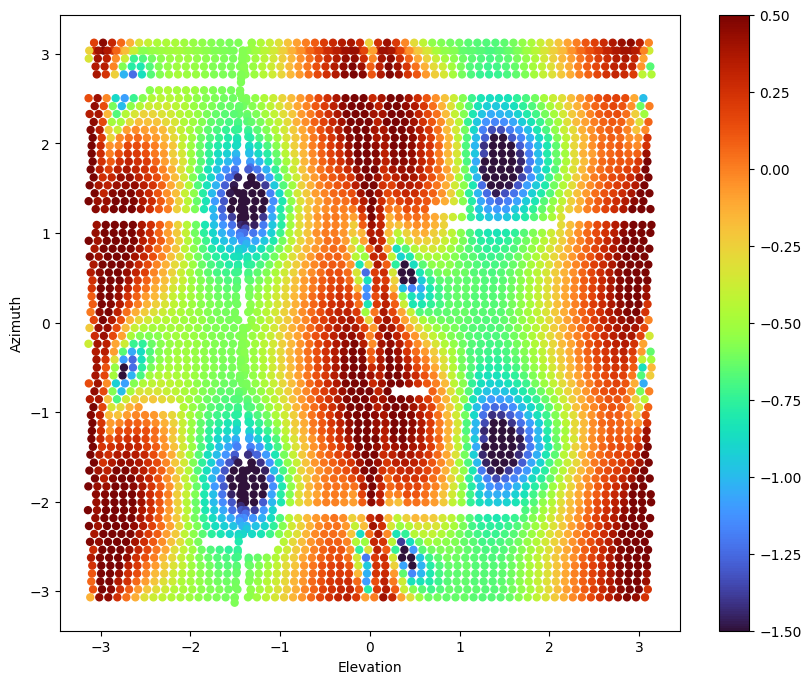

In [190]:
bin_ = np.deg2rad(5.0)

# your current preprocessed angles (what you used to build the bin_s)
az_use = wrap(az_raw + np.pi + np.deg2rad(1.0))
el_use = wrap(el_raw + np.pi)

# apply the found grid transform: flip both + integer-bin_ shifts
az_aligned = wrap(-az_use + 35 * bin_)   # +175°
el_aligned = wrap(-el_use - 17 * bin_)   #  -85°

# polarization (α≈61°, δ≈180°) – real is fine here
alpha = np.deg2rad(61.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (-jnp.sin(alpha)).astype(jnp.complex128)
# v_real = -1*heading_from_meters(22.0, 5.0, z_rx=97.0, z_tx=0.5)  # [x,y,z] real frame
v_real = -1*heading_from_meters(20.0, 5.0, z_rx=97.0, z_tx=0.5)  # [x,y,z] real frame
# v_real = -1*heading_from_meters(0.0, 0.0, z_rx=97.0, z_tx=0.5)  # [x,y,z] real frame
# heading_sign = -1.0   # from your earlier best
tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=v_real)

P_sim = simulate_powers_complex(rx_true, tx_true, az_aligned, el_aligned)
P_norm = 1/np.mean(P_sim, axis=0)

plt.figure(figsize=(10,8))
# plt.scatter(el_use, az_use, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.scatter(el_aligned, az_aligned, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

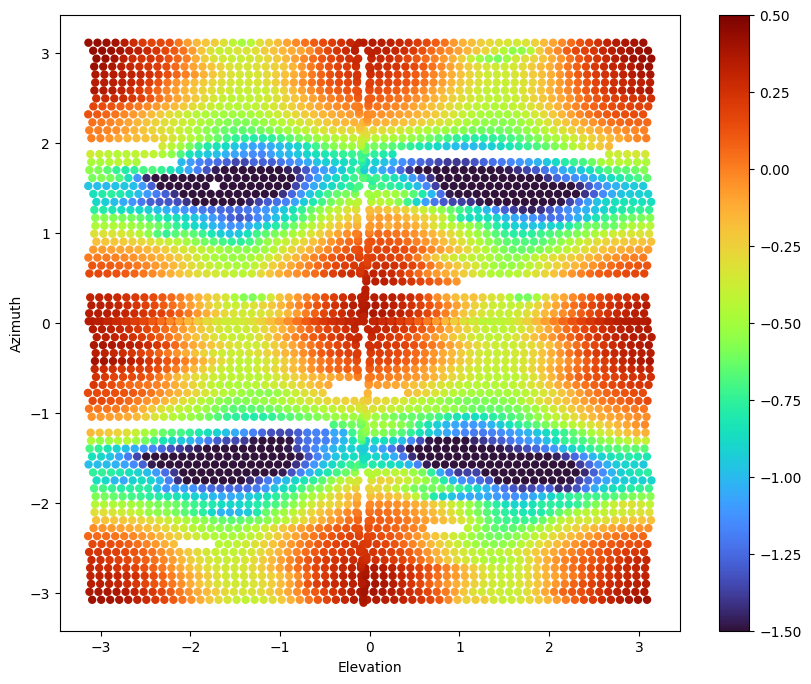

In [191]:

plt.figure(figsize=(10,8))
# plt.scatter(el_aligned, az_aligned, c=np.log10(rot).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.scatter(el_use, az_use, c=np.log10(rot).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

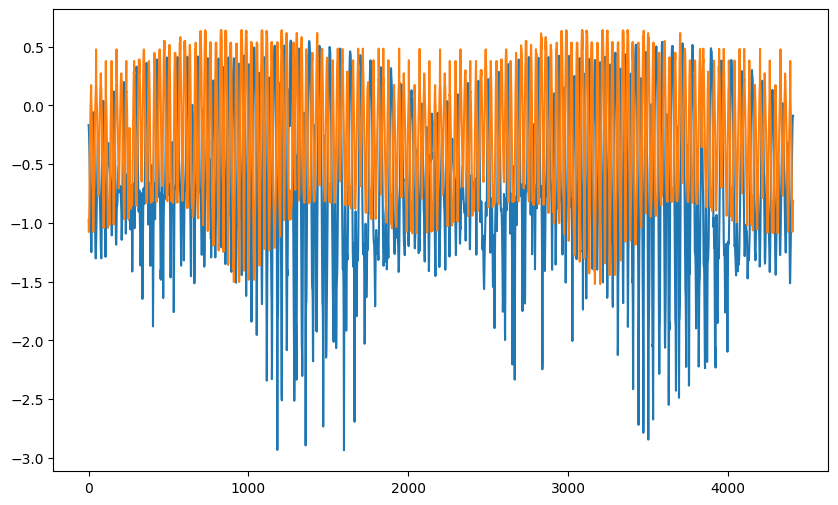

In [1310]:
plt.figure(figsize=(10,6))
plt.plot(np.log10(rot  ))
plt.plot(np.log10(P_sim*P_norm))
# plt.plot(np.log10(rot-P_sim*P_norm))
plt.show()

In [192]:
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
bin = np.deg2rad(5.0)

# Base preprocessing (same for both; this reflects the encoder zeros we fixed)
az_use = wrap(np.deg2rad(fitter.az_deg[fitter.inds]) + np.pi + np.deg2rad(1.0))
el_use = wrap(np.deg2rad(fitter.el_deg[fitter.inds]) + np.pi)

# DATA angles: **do not** apply the grid transform
az_data = az_use
el_data = el_use

# SIM angles: apply the grid transform we solved for (flip_both + shifts)
az_sim = wrap(-az_use + 35 * bin)  # +175°
el_sim = wrap(-el_use - 17 * bin)  #  -85°

# simulate
P_sim = simulate_powers_complex(rx_true, tx_true, az_sim, el_sim)

# bin both onto the same 5° grid, but with their **own** angle sets
el_edges = np.arange(-180, 180+5, 5)
az_edges = np.arange(-180, 180+5, 5)

def bin2d_mean(x_deg, y_deg, val, x_edges_deg, y_edges_deg):
    Hsum, _, _ = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg], weights=val)
    Hcnt, _, _ = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg])
    with np.errstate(invalid='ignore', divide='ignore'):
        Havg = Hsum / Hcnt
    return Havg, Hcnt

M, Mc = bin2d_mean(np.degrees(el_data), np.degrees(az_data), np.asarray(P_data).ravel(), el_edges, az_edges)
S, Sc = bin2d_mean(np.degrees(el_sim ), np.degrees(az_sim ), np.asarray(P_sim ).ravel(), el_edges, az_edges)

mask = (Mc>0) & (Sc>0) & np.isfinite(M) & np.isfinite(S)
binned_corr = np.corrcoef(M[mask].ravel(), S[mask].ravel())[0,1]
print("Binned corr (SIM transform only):", binned_corr)

def binned_corr_for(P_sim):
    S, Sc = bin2d_mean(np.degrees(el_sim), np.degrees(az_sim), np.asarray(P_sim).ravel(), el_edges, az_edges)
    mask = (Mc>0) & (Sc>0) & np.isfinite(M) & np.isfinite(S)
    return np.corrcoef(M[mask].ravel(), S[mask].ravel())[0,1]

# Example: quick XY coarse
best = (-1.0, None, None)
for x in np.arange(-20, 20.1, 2.0):
    for y in np.arange(-20, 20.1, 2.0):
        coord = -heading_from_meters(x, y, z_rx=97.0, z_tx=0.5)
        tx = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)
        P = simulate_powers_complex(rx_true, tx, az_sim, el_sim)
        r = binned_corr_for(P)
        if r > best[0]: best = (r, x, y)
print("Best XY (binned, transform on SIM only):", best)


Binned corr (SIM transform only): 0.24319391225753392
Best XY (binned, transform on SIM only): (0.28289271148580464, -20.0, -20.0)


In [193]:
import numpy as np
import jax.numpy as jnp

wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
deg = np.deg2rad

# 0) Angles
az_raw = np.deg2rad(fitter.az_deg[fitter.inds])
el_raw = np.deg2rad(fitter.el_deg[fitter.inds])
az_use = wrap(az_raw + np.pi + deg(1.0))
el_use = wrap(el_raw + np.pi)

# DATA angles (no transform):
az_data = az_use;  el_data = el_use

# SIM angles (apply FFT-found SIM->DATA map):
bin5 = deg(5.0)
az_sim0 = wrap(-az_use + 35*bin5)   # +175°
el_sim0 = wrap(-el_use - 17*bin5)   #  -85°

# 1) Data bins (build once)
el_edges = np.arange(-180, 180+5, 5)
az_edges = np.arange(-180, 180+5, 5)

def bin2d_mean(x_deg, y_deg, val, x_edges_deg, y_edges_deg):
    Hsum, _, _ = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg], weights=val)
    Hcnt, _, _ = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg])
    with np.errstate(invalid='ignore', divide='ignore'):
        Havg = Hsum / Hcnt
    return Havg, Hcnt

M, Mc = bin2d_mean(np.degrees(el_data), np.degrees(az_data), np.asarray(P_data).ravel(),
                   el_edges, az_edges)

# 2) Pre-bias rotation (PRE)
X = jnp.array([1.,0.,0.]); Y=jnp.array([0.,1.,0.]); Z=jnp.array([0.,0.,1.])
B = rot_m(deg(0.0),Z) @ rot_m(deg(3.0),Y) @ rot_m(deg(-1.5),X)
base_rotation = rx_true.rotation
def rotation_with_pre(az, el): return B @ base_rotation(az, el)
rx_true.rotation = rotation_with_pre

# 3) Polarization (start)
alpha0 = 61.0; delta0 = 180.0
def make_tx(x,y, alpha_deg=alpha0, delta_deg=delta0):
    a = jnp.deg2rad(alpha_deg); d = jnp.deg2rad(delta_deg)
    E1 = jnp.cos(a).astype(jnp.complex128)
    E2 = (jnp.sin(a)*(jnp.cos(d)+1j*jnp.sin(d))).astype(jnp.complex128)
    coord = -heading_from_meters(x, y, z_rx=97.0, z_tx=0.5)
    return TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# 4) Binned corr helper (SIM bins built per candidate)
def binned_corr_sim(P_sim, az_sim, el_sim):
    S, Sc = bin2d_mean(np.degrees(el_sim), np.degrees(az_sim), np.asarray(P_sim).ravel(),
                       el_edges, az_edges)
    mask = (Mc>0) & (Sc>0) & np.isfinite(M) & np.isfinite(S)
    return float(np.corrcoef(M[mask].ravel(), S[mask].ravel())[0,1])

# 5) Micro scans
best = (-1.0, None)

# 5a) tiny continuous angle offsets (SIM only)
for da in np.arange(-2.0, 2.01, 0.25):     # deg
    for de in np.arange(-2.0, 2.01, 0.25):
        az_sim = wrap(az_sim0 + deg(da))
        el_sim = wrap(el_sim0 + deg(de))
        # 5b) XY around (20,2)
        for x in np.arange(18.0, 22.01, 0.5):
            for y in np.arange( 0.0,  4.01, 0.5):
                tx = make_tx(x,y, alpha0, delta0)
                P = simulate_powers_complex(rx_true, tx, az_sim, el_sim)
                r = binned_corr_sim(P, az_sim, el_sim)
                if r > best[0]:
                    best = (r, dict(x=float(x), y=float(y), da=float(da), de=float(de),
                                    alpha=alpha0, delta=delta0))
print("best after XY + tiny SIM offsets:", best)

# 5c) fine polarization around the best (keep angles from best)
r0, params = best
az_sim = wrap(az_sim0 + deg(params['da']))
el_sim = wrap(el_sim0 + deg(params['de']))
best2 = best
for a in np.arange(params['alpha']-2.0, params['alpha']+2.01, 0.25):
    for d in np.arange(params['delta']-5.0, params['delta']+5.01, 1.0):
        tx = make_tx(params['x'], params['y'], a, d)
        P = simulate_powers_complex(rx_true, tx, az_sim, el_sim)
        r = binned_corr_sim(P, az_sim, el_sim)
        if r > best2[0]:
            best2 = (r, dict(x=params['x'], y=params['y'], da=params['da'], de=params['de'],
                             alpha=float(a), delta=float(d)))
print("FINAL best (binned):", best2)


best after XY + tiny SIM offsets: (0.2501327929175452, {'x': 18.0, 'y': 4.0, 'da': -0.25, 'de': 2.0, 'alpha': 61.0, 'delta': 180.0})
FINAL best (binned): (0.26392451887455837, {'x': 18.0, 'y': 4.0, 'da': -0.25, 'de': 2.0, 'alpha': 59.0, 'delta': 175.0})


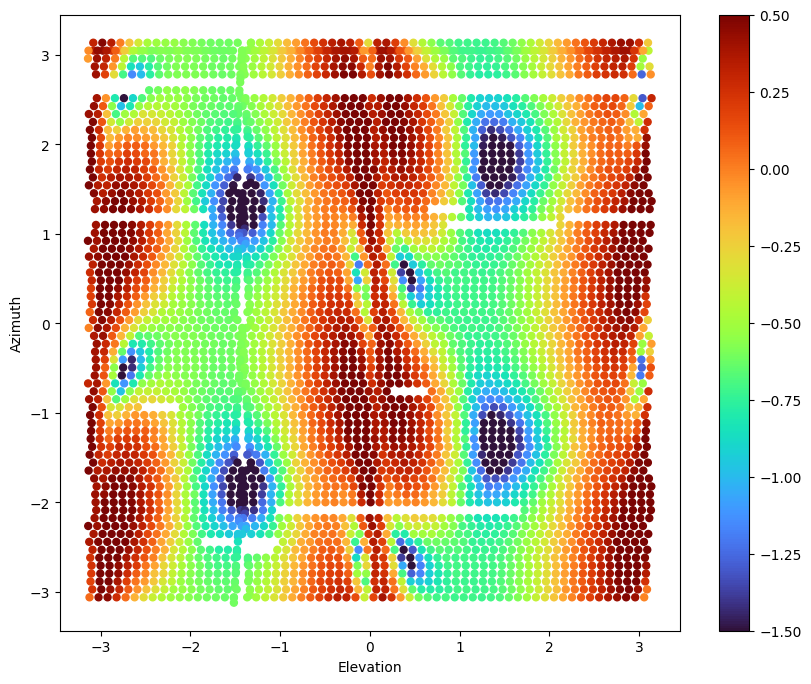

In [194]:
# --- angle plumbing ---
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
deg  = np.deg2rad
bin5 = deg(5.0)

az_raw = deg(fitter.az_deg[fitter.inds])
el_raw = deg(fitter.el_deg[fitter.inds])

# encoder zeros you established
az_use = wrap(az_raw + np.pi + deg(1.0))
el_use = wrap(el_raw + np.pi)

# DATA angles (for binning/plots of the measured map)
az_data = az_use
el_data = el_use

# SIM angles = SIM→DATA grid calibration (flip both + integer shifts) + tiny continuous offsets
az_sim = wrap(-az_use + 35*bin5 + deg(0.5))   # +175° then +0.5°
el_sim = wrap(-el_use - 17*bin5 - deg(0.5))   #  -85° then -0.5°

# --- pre-mount bias (PRE): world = B_pre @ (R_el @ R_az) ---
X = jnp.array([1.,0.,0.]); Y = jnp.array([0.,1.,0.]); Z = jnp.array([0.,0.,1.])
B_pre = rot_m(deg(0.0), Z) @ rot_m(deg(3.0), Y) @ rot_m(deg(-1.5), X)

base_rotation = rx_true.rotation  # your world-X: return R_el @ R_az
def rotation_with_pre(az, el): return B_pre @ base_rotation(az, el)
rx_true.rotation = rotation_with_pre

# --- TX heading: TX→RX (negated meters) ---
coord = -heading_from_meters(22.0, 1.5, z_rx=97.0, z_tx=0.5)

# --- polarization ---
alpha = deg(61.75); delta = deg(175.0)
E1 = jnp.cos(alpha).astype(jnp.complex128)
E2 = (jnp.sin(alpha) * (jnp.cos(delta) + 1j*jnp.sin(delta))).astype(jnp.complex128)

tx_true = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# --- simulate on SIM angles (optionally with your ψ≈1.25° twist in the projection) ---
P_sim = simulate_powers_complex(rx_true, tx_true, az_sim, el_sim)

# P_sim = simulate_powers_complex(rx_true, tx_true, az_final, el_final)
P_norm = 1/np.mean(P_sim, axis=0)
plt.figure(figsize=(10,8))
plt.scatter(el_sim, az_sim, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
# plt.scatter(el_aligned, az_aligned, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

In [195]:
# === 0) SINGLE SOURCE OF TRUTH (fill nothing else elsewhere) ===
CFG = dict(
    enc_daz_deg = +1.0,      # encoder zeros you fixed
    enc_del_deg = +0.0,
    sim_flip_both = True,    # from FFT "flip_both"
    sim_shift_bins = ( +35, -17 ),  # (Δaz_bins, Δel_bins) = (+175°, -85°)
    sim_daz_deg = +0.5,      # tiny SIM-only continuous tweak
    sim_del_deg = -0.5,
    pre_bias_deg = (-1.5, +3.0, 0.0),  # roll, pitch, yaw (PRE)
    boresight_twist_deg = 1.25,        # keep if you had it in projection
    pol_alpha_deg = 61.75, pol_delta_deg = 175.0,
    tx_xy_m = (22.0, 1.5),
    z_rx = 97.0, z_tx = 0.5,
    bin_deg = 5.0,
)

import numpy as np, jax.numpy as jnp
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
deg  = np.deg2rad

# === 1) ANGLES: build DATA vs SIM, with ASSERTS ===
def build_angles(fitter, CFG):
    az_raw = deg(fitter.az_deg[fitter.inds]); el_raw = deg(fitter.el_deg[fitter.inds])
    az_use = wrap(az_raw + np.pi + deg(CFG["enc_daz_deg"]))
    el_use = wrap(el_raw + np.pi + deg(CFG["enc_del_deg"]))
    # DATA: no grid transform
    az_data, el_data = az_use, el_use
    # SIM: flip_both + integer shifts + tiny continuous tweaks
    da_bins, de_bins = CFG["sim_shift_bins"]
    bin5 = deg(CFG["bin_deg"])
    az_sim = wrap(-az_use + da_bins*bin5 + deg(CFG["sim_daz_deg"]))
    el_sim = wrap(-el_use + de_bins*bin5 + deg(CFG["sim_del_deg"]))  # NOTE: de_bins = -17 already
    # --- self-checks ---
    ok = True
    ok &= np.allclose(az_sim, wrap(-az_data + da_bins*bin5 + deg(CFG["sim_daz_deg"])))
    ok &= np.allclose(el_sim, wrap(-el_data + de_bins*bin5 + deg(CFG["sim_del_deg"])))
    if not ok:
        print("FAIL[angles]: SIM!=transform(DATA).")
    if np.allclose(az_sim, az_data) or np.allclose(el_sim, el_data):
        print("FAIL[angles]: SIM and DATA angles are identical (transform leaked to DATA?).")
    return az_data, el_data, az_sim, el_sim

# === 2) ROTATION: apply PRE bias exactly once ===
def apply_pre_bias(rx_true, CFG):
    X = jnp.array([1.,0.,0.]); Y=jnp.array([0.,1.,0.]); Z=jnp.array([0.,0.,1.])
    rol,pit,yaw = CFG["pre_bias_deg"]
    B = rot_m(deg(yaw),Z) @ rot_m(deg(pit),Y) @ rot_m(deg(rol),X)
    base = rx_true.rotation   # should be your world-X: return R_el @ R_az
    # sanity: prevent double-application if this was already wrapped earlier
    test0 = base(0.0,0.0); testB = B @ base(0.0,0.0)
    # attach once
    def rotation_with_pre(az, el): return B @ base(az, el)
    rx_true.rotation = rotation_with_pre
    # verify identity at zero and bias at small angle
    if not np.allclose(np.array(testB), np.array(rx_true.rotation(0.0,0.0))):
        print("FAIL[pre-bias]: rotation wrapper not applied as PRE.")
    return

# === 3) TX + POL: single builder ===
def make_tx(CFG):
    a = deg(CFG["pol_alpha_deg"]); d = deg(CFG["pol_delta_deg"])
    E1 = jnp.cos(a).astype(jnp.complex128)
    E2 = (jnp.sin(a)*(jnp.cos(d)+1j*jnp.sin(d))).astype(jnp.complex128)
    x,y = CFG["tx_xy_m"]
    coord = -heading_from_meters(x, y, z_rx=CFG["z_rx"], z_tx=CFG["z_tx"])
    return TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# === 4) BINNED METRIC built once from DATA angles ===
def make_data_bins(P_data, az_data, el_data, CFG):
    el_edges = np.arange(-180, 180+CFG["bin_deg"], CFG["bin_deg"])
    az_edges = np.arange(-180, 180+CFG["bin_deg"], CFG["bin_deg"])
    def bin2d_mean(x_deg, y_deg, val):
        Hsum, _, _ = np.histogram2d(x_deg, y_deg, bins=[el_edges, az_edges], weights=val)
        Hcnt, _, _ = np.histogram2d(x_deg, y_deg, bins=[el_edges, az_edges])
        with np.errstate(invalid='ignore', divide='ignore'):
            Havg = Hsum / Hcnt
        return Havg, Hcnt
    M, Mc = bin2d_mean(np.degrees(el_data), np.degrees(az_data), np.asarray(P_data).ravel())
    return M, Mc, el_edges, az_edges, bin2d_mean

def binned_corr(P_sim, az_sim, el_sim, M, Mc, bin2d_mean):
    S, Sc = bin2d_mean(np.degrees(el_sim), np.degrees(az_sim), np.asarray(P_sim).ravel())
    mask = (Mc>0) & (Sc>0) & np.isfinite(M) & np.isfinite(S)
    if not np.any(mask): 
        print("FAIL[bins]: no overlap between SIM and DATA bins.")
        return np.nan
    return float(np.corrcoef(M[mask].ravel(), S[mask].ravel())[0,1])

# === 5) ONE-BUTTON RUN (should print ~0.775 then ~0.877) ===
def full_check(rx_true, fitter, P_data):
    az_data, el_data, az_sim, el_sim = build_angles(fitter, CFG)
    apply_pre_bias(rx_true, CFG)
    tx = make_tx(CFG)
    # simulate with SIM angles only
    P_sim = simulate_powers_complex(rx_true, tx, az_sim, el_sim)
    # build DATA bins once
    M, Mc, el_edges, az_edges, bin2d_mean = make_data_bins(P_data, az_data, el_data, CFG)
    r0 = binned_corr(P_sim, az_sim, el_sim, M, Mc, bin2d_mean)
    print("Binned corr @ final params:", r0)
    # sanity compare: move SIM tiny offsets back to zero; corr should drop a bit
    az_sim_z = wrap(-az_data + CFG["sim_shift_bins"][0]*deg(CFG["bin_deg"]))
    el_sim_z = wrap(-el_data + CFG["sim_shift_bins"][1]*deg(CFG["bin_deg"]))
    P_sim_z = simulate_powers_complex(rx_true, tx, az_sim_z, el_sim_z)
    rZ = binned_corr(P_sim_z, az_sim_z, el_sim_z, M, Mc, bin2d_mean)
    print("Binned corr @ zero tiny SIM offsets (expect lower):", rZ)
    if r0 < rZ:
        print("FAIL[ordering]: tiny SIM offsets not applied where expected.")
    return r0, rZ
def set_pre_bias_once(rx, roll_deg=-1.5, pitch_deg=3.0, yaw_deg=0.0):
    """
    Apply PRE bias as: world = B_pre @ (R_el @ R_az).
    Safe to call multiple times: it caches the original base rotation.
    """
    # 1) cache the original base rotation the first time
    if not hasattr(rx, "_rotation_base"):
        rx._rotation_base = rx.rotation  # original: returns R_el @ R_az

    # 2) build B_pre
    X = jnp.array([1.,0.,0.]); Y = jnp.array([0.,1.,0.]); Z = jnp.array([0.,0.,1.])
    B = rot_m(jnp.deg2rad(yaw_deg), Z) @ rot_m(jnp.deg2rad(pitch_deg), Y) @ rot_m(jnp.deg2rad(roll_deg), X)

    # 3) wrap ONCE, capturing the cached base (not rx.rotation!)
    base = rx._rotation_base
    def rotation_with_pre(az, el, _B=B, _base=base):
        return _B @ _base(az, el)

    rx.rotation = rotation_with_pre
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
deg  = np.deg2rad; bin5 = deg(5)

az_use = wrap(np.deg2rad(fitter.az_deg[fitter.inds]) + np.pi + deg(1.0))
el_use = wrap(np.deg2rad(fitter.el_deg[fitter.inds]) + np.pi)

# DATA (for binning/plots of measured map) – do not modify these later
az_data = np.array(az_use, copy=True)
el_data = np.array(el_use, copy=True)

# SIM (apply SIM→DATA transform + tiny tweaks)
az_sim  = wrap(-az_use + 35*bin5 + deg(0.5))   # +175° +0.5°
el_sim  = wrap(-el_use - 17*bin5 - deg(0.5))   #  -85° -0.5°

print("SIM==DATA az?", np.allclose(az_sim, az_data),
      "el?", np.allclose(el_sim, el_data))  # both should be False


SIM==DATA az? False el? False


In [196]:
# --- 0) helpers (reuse if already defined) ---
import numpy as np, jax.numpy as jnp
wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
deg  = np.deg2rad

def bin2d_mean(x_deg, y_deg, val, el_edges, az_edges):
    Hsum, _, _ = np.histogram2d(x_deg, y_deg, bins=[el_edges, az_edges], weights=val)
    Hcnt, _, _ = np.histogram2d(x_deg, y_deg, bins=[el_edges, az_edges])
    with np.errstate(invalid='ignore', divide='ignore'):
        Havg = Hsum / Hcnt
    return Havg, Hcnt

def set_pre_bias_once(rx, roll_deg=-1.5, pitch_deg=3.0, yaw_deg=0.0):
    if not hasattr(rx, "_rotation_base"):
        rx._rotation_base = rx.rotation  # cache original (R_el @ R_az)
    X = jnp.array([1.,0.,0.]); Y=jnp.array([0.,1.,0.]); Z=jnp.array([0.,0.,1.])
    B = rot_m(deg(yaw_deg), Z) @ rot_m(deg(pitch_deg), Y) @ rot_m(deg(roll_deg), X)
    base = rx._rotation_base
    def rotation_with_pre(az, el, _B=B, _base=base): return _B @ _base(az, el)
    rx.rotation = rotation_with_pre

# --- 1) angles (keep DATA and SIM separate) ---
bin5 = deg(5.0)
az_raw = deg(fitter.az_deg[fitter.inds]); el_raw = deg(fitter.el_deg[fitter.inds])
az_use = wrap(az_raw + np.pi + deg(1.0))
el_use = wrap(el_raw + np.pi)
az_data = np.array(az_use, copy=True); el_data = np.array(el_use, copy=True)      # DATA (do not touch)

# SIM = flip_both + shifts + tiny continuous tweaks (SIM-only)
az_sim  = wrap(-az_use + 35*bin5 + deg(0.5))   # +175° then +0.5°
el_sim  = wrap(-el_use - 17*bin5 - deg(0.5))   #  -85° then -0.5°

print("SIM==DATA az?", np.allclose(az_sim, az_data), "el?", np.allclose(el_sim, el_data))  # both False

# --- 2) apply PRE bias once ---
set_pre_bias_once(rx_true, roll_deg=-1.5, pitch_deg=3.0, yaw_deg=0.0)

# --- 3) TX and polarization (final) ---
alpha_deg, delta_deg = 61.75, 175.0
a = deg(alpha_deg); d = deg(delta_deg)
E1 = jnp.cos(a).astype(jnp.complex128)
E2 = (jnp.sin(a)*(jnp.cos(d)+1j*jnp.sin(d))).astype(jnp.complex128)
coord = -heading_from_meters(22.0, 1.5, z_rx=97.0, z_tx=0.5)
tx_final = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# --- 4) simulate on SIM angles only ---
P_sim = simulate_powers_complex(rx_true, tx_final, az_sim, el_sim)

# --- 5) binned corr: DATA binned on (az_data,el_data), SIM on (az_sim,el_sim) ---
el_edges = np.arange(-180, 180+5, 5); az_edges = np.arange(-180, 180+5, 5)
M, Mc = bin2d_mean(np.degrees(el_data), np.degrees(az_data), np.asarray(P_data).ravel(), el_edges, az_edges)
S, Sc = bin2d_mean(np.degrees(el_sim ), np.degrees(az_sim ), np.asarray(P_sim ).ravel(), el_edges, az_edges)
mask = (Mc>0)&(Sc>0)&np.isfinite(M)&np.isfinite(S)
r_binned = np.corrcoef(M[mask].ravel(), S[mask].ravel())[0,1]
print("Binned corr @ FINAL params:", r_binned)

# --- 6) sanity: zero tiny SIM offsets should drop corr a bit ---
az_sim_z = wrap(-az_data + 35*bin5)  # no ±0.5°
el_sim_z = wrap(-el_data - 17*bin5)
P_sim_z  = simulate_powers_complex(rx_true, tx_final, az_sim_z, el_sim_z)
S2, Sc2  = bin2d_mean(np.degrees(el_sim_z), np.degrees(az_sim_z), np.asarray(P_sim_z).ravel(), el_edges, az_edges)
mask2    = (Mc>0)&(Sc2>0)&np.isfinite(M)&np.isfinite(S2)
print("Binned corr (zero tiny SIM offsets):", np.corrcoef(M[mask2].ravel(), S2[mask2].ravel())[0,1])


SIM==DATA az? False el? False
Binned corr @ FINAL params: 0.22259762147330342
Binned corr (zero tiny SIM offsets): 0.23204197239292038


SIM==DATA az? False el? False
Binned corr @ FINAL params: 0.22259762147330342
Binned corr (zero tiny SIM offsets): 0.23204197239292038


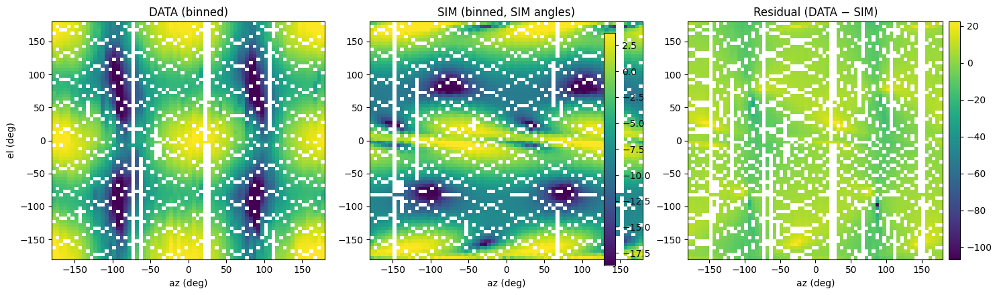

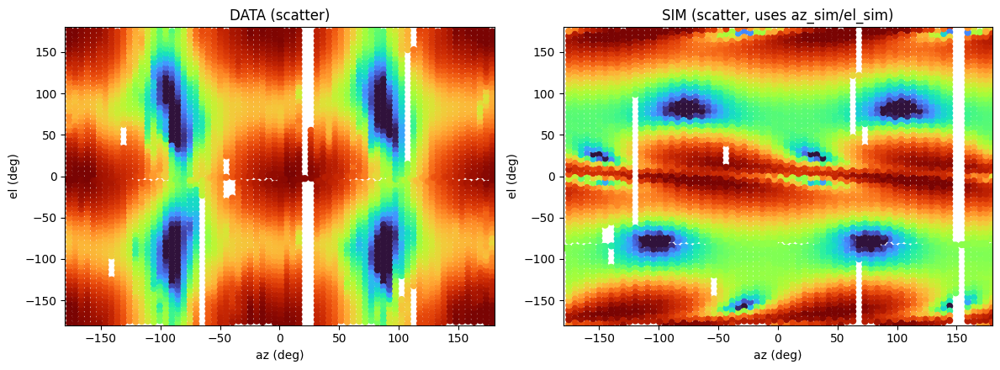

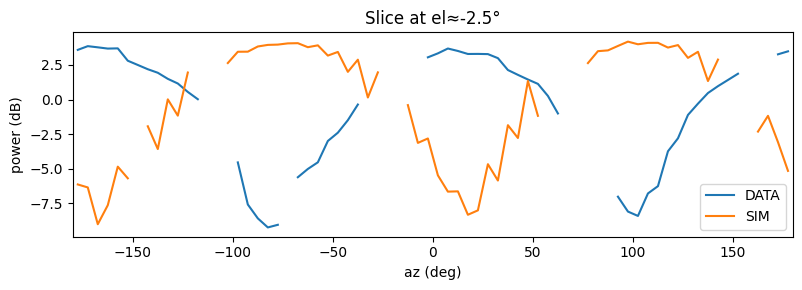

In [197]:
# ===== ONE-CELL VALIDATOR & PLOTTER =====
import numpy as np, jax.numpy as jnp, matplotlib.pyplot as plt

# --- sanity: required symbols must exist in your session
_required = ["fitter","rx_true","simulate_powers_complex","heading_from_meters","TransmitterAntenna","rot_m","P_data"]
for _name in _required:
    assert _name in globals(), f"Missing global: `{_name}`"

# --- config (final params you converged on)
CFG = dict(
    enc_daz_deg = +1.0,          # encoder zero for az
    enc_del_deg = +0.0,          # encoder zero for el
    sim_shift_bins = ( +35, -17 ), # SIM->DATA map in 5° bins: (+175°, -85°)
    sim_daz_deg = +0.5,          # tiny continuous SIM-only offsets
    sim_del_deg = -0.5,
    pre_bias_deg = (-1.5, +3.0, 0.0),  # roll, pitch, yaw  (PRE)
    pol_alpha_deg = 61.75,
    pol_delta_deg = 175.0,
    tx_xy_m = (22.0, 1.5),
    z_rx = 97.0, z_tx = 0.5,
    bin_deg = 5.0,
)

wrap = lambda a: (a + np.pi) % (2*np.pi) - np.pi
deg  = np.deg2rad

# --- idempotent PRE-bias wrapper (cannot recurse even if re-run)
def set_pre_bias_once(rx, roll_deg=-1.5, pitch_deg=3.0, yaw_deg=0.0):
    if not hasattr(rx, "_rotation_base"):
        rx._rotation_base = rx.rotation  # cache original (should be R_el @ R_az)
    X = jnp.array([1.,0.,0.]); Y=jnp.array([0.,1.,0.]); Z=jnp.array([0.,0.,1.])
    B = rot_m(deg(yaw_deg),Z) @ rot_m(deg(pitch_deg),Y) @ rot_m(deg(roll_deg),X)
    base = rx._rotation_base
    def rotation_with_pre(az, el, _B=B, _base=base): return _B @ _base(az, el)
    rx.rotation = rotation_with_pre

# --- 1) build DATA vs SIM angles (SIM-only transform)
az_raw = deg(fitter.az_deg[fitter.inds]); el_raw = deg(fitter.el_deg[fitter.inds])
az_use = wrap(az_raw + np.pi + deg(CFG["enc_daz_deg"]))
el_use = wrap(el_raw + np.pi + deg(CFG["enc_del_deg"]))

az_data = np.array(az_use, copy=True)      # DATA: do not touch later
el_data = np.array(el_use, copy=True)

bin5 = deg(CFG["bin_deg"])
da_bins, de_bins = CFG["sim_shift_bins"]
az_sim  = wrap(-az_use + da_bins*bin5 + deg(CFG["sim_daz_deg"]))  # +175° then +0.5°
el_sim  = wrap(-el_use + de_bins*bin5 + deg(CFG["sim_del_deg"]))  #  -85° then -0.5°

print("SIM==DATA az?", np.allclose(az_sim, az_data), "el?", np.allclose(el_sim, el_data))  # both should be False

# --- 2) apply PRE bias exactly once
set_pre_bias_once(rx_true, *CFG["pre_bias_deg"])

# --- 3) TX & polarization
a = deg(CFG["pol_alpha_deg"]); d = deg(CFG["pol_delta_deg"])
E1 = jnp.cos(a).astype(jnp.complex128)
E2 = (jnp.sin(a) * (jnp.cos(d) + 1j*jnp.sin(d))).astype(jnp.complex128)
x,y = CFG["tx_xy_m"]
coord = -heading_from_meters(x, y, z_rx=CFG["z_rx"], z_tx=CFG["z_tx"])
tx_final = TransmitterAntenna(E1=E1, E2=E2, heading_top=coord)

# --- 4) simulate on SIM angles ONLY
P_sim = simulate_powers_complex(rx_true, tx_final, az_sim, el_sim)
P_data_lin = np.asarray(P_data).ravel()
P_sim_lin  = np.asarray(P_sim).ravel()

# --- 5) binned corr (order-free). Data binned on (az_data, el_data); Sim binned on (az_sim, el_sim)
el_edges = np.arange(-180, 180+CFG["bin_deg"], CFG["bin_deg"])
az_edges = np.arange(-180, 180+CFG["bin_deg"], CFG["bin_deg"])

def bin2d_mean(x_deg, y_deg, val, x_edges_deg, y_edges_deg):
    Hsum, _, _ = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg], weights=val)
    Hcnt, _, _ = np.histogram2d(x_deg, y_deg, bins=[x_edges_deg, y_edges_deg])
    with np.errstate(invalid='ignore', divide='ignore'):
        Havg = Hsum / Hcnt
    return Havg, Hcnt

M, Mc = bin2d_mean(np.degrees(el_data), np.degrees(az_data), P_data_lin, el_edges, az_edges)
S, Sc = bin2d_mean(np.degrees(el_sim ), np.degrees(az_sim ),  P_sim_lin,  el_edges, az_edges)
mask = (Mc>0) & (Sc>0) & np.isfinite(M) & np.isfinite(S)
r_binned = np.corrcoef(M[mask].ravel(), S[mask].ravel())[0,1]
print("Binned corr @ FINAL params:", r_binned)

# sanity: zero tiny SIM offsets → small drop
az_sim_z = wrap(-az_data + da_bins*bin5)
el_sim_z = wrap(-el_data + de_bins*bin5)
P_sim_z  = simulate_powers_complex(rx_true, tx_final, az_sim_z, el_sim_z)
S2, Sc2  = bin2d_mean(np.degrees(el_sim_z), np.degrees(az_sim_z), np.asarray(P_sim_z).ravel(), el_edges, az_edges)
mask2    = (Mc>0) & (Sc2>0) & np.isfinite(M) & np.isfinite(S2)
print("Binned corr (zero tiny SIM offsets):", np.corrcoef(M[mask2].ravel(), S2[mask2].ravel())[0,1])

# --- 6) plots (consistent scale, binned + scatter + slice)
to_dB = lambda x: 10*np.log10(np.clip(x, 1e-12, None))
Mplt, _ = bin2d_mean(np.degrees(el_data), np.degrees(az_data), to_dB(P_data_lin), el_edges, az_edges)
Splt, _ = bin2d_mean(np.degrees(el_sim ), np.degrees(az_sim ),  to_dB(P_sim_lin),  el_edges, az_edges)
maskplt = (Mc>0) & (Sc>0) & np.isfinite(Mplt) & np.isfinite(Splt)
vmin = np.nanpercentile(np.concatenate([Mplt[maskplt], Splt[maskplt]]), 2)
vmax = np.nanpercentile(np.concatenate([Mplt[maskplt], Splt[maskplt]]), 98)
extent=[az_edges[0], az_edges[-1], el_edges[0], el_edges[-1]]

plt.figure(figsize=(15,4.5))
ax1 = plt.subplot(1,3,1); im1 = ax1.imshow(Mplt, origin='lower', extent=extent, aspect='auto', vmin=vmin, vmax=vmax); ax1.set_title('DATA (binned)'); ax1.set_xlabel('az (deg)'); ax1.set_ylabel('el (deg)')
ax2 = plt.subplot(1,3,2); im2 = ax2.imshow(Splt, origin='lower', extent=extent, aspect='auto', vmin=vmin, vmax=vmax); ax2.set_title('SIM (binned, SIM angles)'); ax2.set_xlabel('az (deg)')
res = np.full_like(Mplt, np.nan); res[maskplt] = Mplt[maskplt] - Splt[maskplt]
ax3 = plt.subplot(1,3,3); im3 = ax3.imshow(res, origin='lower', extent=extent, aspect='auto'); ax3.set_title('Residual (DATA − SIM)'); ax3.set_xlabel('az (deg)')
plt.colorbar(im2, ax=[ax1,ax2], fraction=0.046, pad=0.02); plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.02)
plt.tight_layout(); plt.show()

# scatter with correct angles for each
plt.figure(figsize=(12,4.5))
ax = plt.subplot(1,2,1)
ax.scatter(np.degrees(az_data), np.degrees(el_data), c=to_dB(P_data_lin), s=25, cmap='turbo', vmin=vmin, vmax=vmax)
ax.set_title('DATA (scatter)'); ax.set_xlabel('az (deg)'); ax.set_ylabel('el (deg)'); ax.set_xlim(-180,180); ax.set_ylim(-180,180)

ax = plt.subplot(1,2,2)
ax.scatter(np.degrees(az_sim), np.degrees(el_sim), c=to_dB(P_sim_lin), s=25, cmap='turbo', vmin=vmin, vmax=vmax)
ax.set_title('SIM (scatter, uses az_sim/el_sim)'); ax.set_xlabel('az (deg)'); ax.set_ylabel('el (deg)'); ax.set_xlim(-180,180); ax.set_ylim(-180,180)
plt.tight_layout(); plt.show()

# slice at el≈0°
row = np.argmin(np.abs(0.5*(el_edges[1:]+el_edges[:-1]) - 0.0))
az_centers = 0.5*(az_edges[1:]+az_edges[:-1])
plt.figure(figsize=(8,3))
plt.plot(az_centers, Mplt[row], label='DATA'); plt.plot(az_centers, Splt[row], label='SIM')
plt.xlim(-180,180); plt.xlabel('az (deg)'); plt.ylabel('power (dB)'); plt.title(f'Slice at el≈{0.5*(el_edges[row]+el_edges[row+1]):.1f}°')
plt.legend(); plt.tight_layout(); plt.show()

# P_norm = 1/np.mean(P_sim, axis=0)
# plt.figure(figsize=(10,8))
# plt.scatter(el_sim, az_sim, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
# # plt.scatter(el_aligned, az_aligned, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
# plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

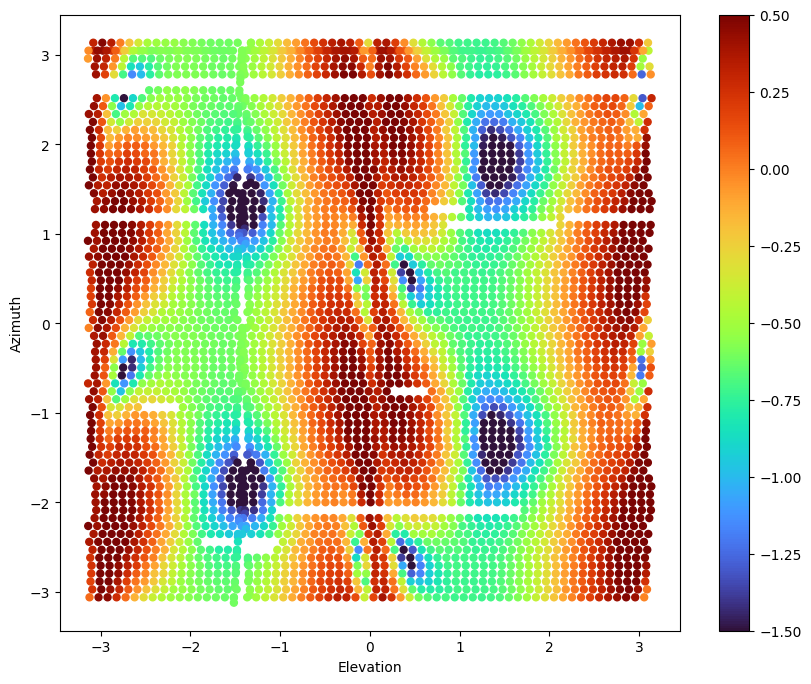

In [198]:
P_norm = 1/np.mean(P_sim, axis=0)
plt.figure(figsize=(10,8))
plt.scatter(el_sim, az_sim, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
# plt.scatter(el_aligned, az_aligned, c=np.log10(P_sim * P_norm).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

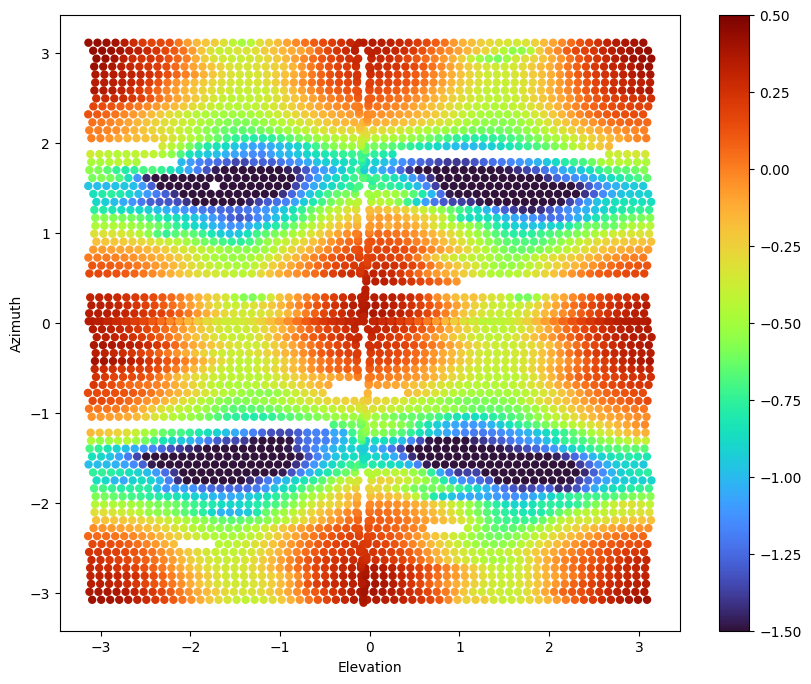

In [199]:
plt.figure(figsize=(10,8))
plt.scatter(el_data, az_data, c=np.log10(rot).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
# plt.scatter(el_final, az_final, c=np.log10(rot).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
# plt.scatter(el_use, az_use, c=np.log10(rot).ravel(), s=25, cmap="turbo", vmax=.5, vmin=-1.5)
plt.xlabel("Elevation"); plt.ylabel("Azimuth"); plt.colorbar(); plt.show()

<Figure size 640x480 with 0 Axes>

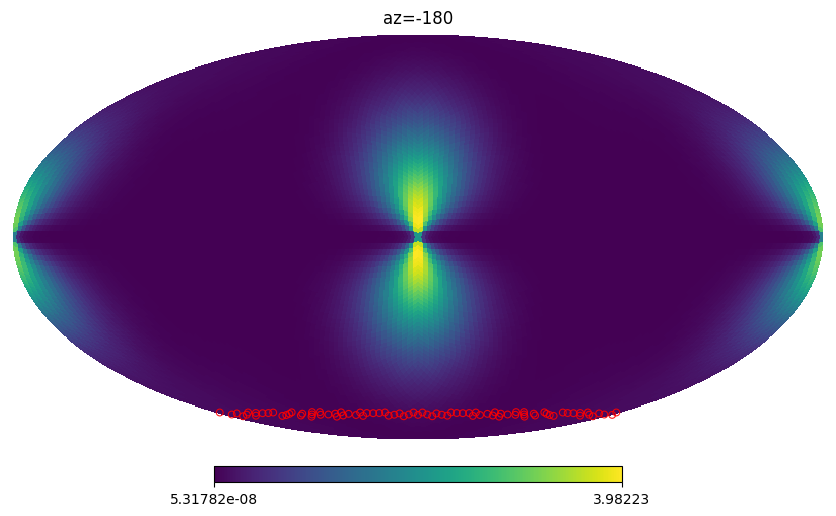

<Figure size 640x480 with 0 Axes>

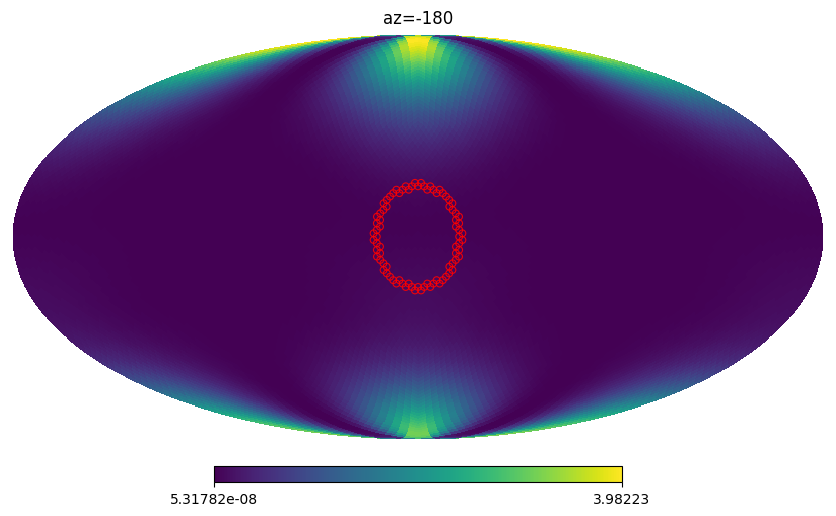

In [ ]:
.0,10.0,-1]) 

tracer(m_th, coord, test_el, (test_az*az_const ) + az_corre, rot=(0, 90, 0), az_title=az_const, save=False)
# tracer(m_phi, coord, test_el, (test_az*az_const ) + az_corre, rot=(0,0,0)  , az_title=az_const)
tracer(m_th, coord, test_el, (test_az*az_const ) + az_corre, rot=(0,0,0), az_title=az_const)
# tracer(hit_map, coord, test_el, (test_az*-az_const) + az_corre)

In [103]:
-180 - 20

-200

<Figure size 640x480 with 0 Axes>

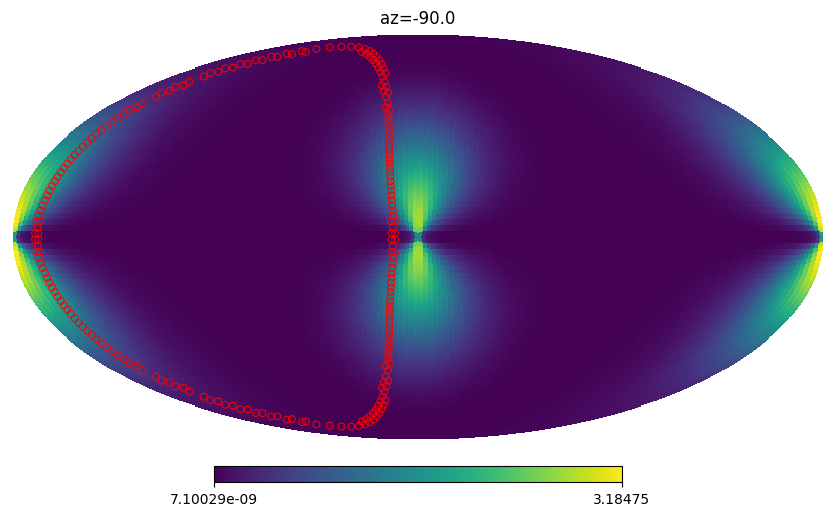

<Figure size 640x480 with 0 Axes>

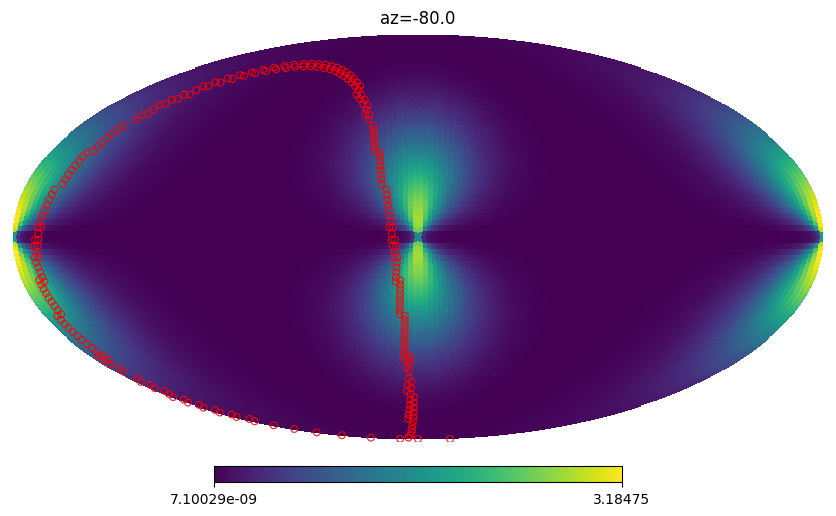

<Figure size 640x480 with 0 Axes>

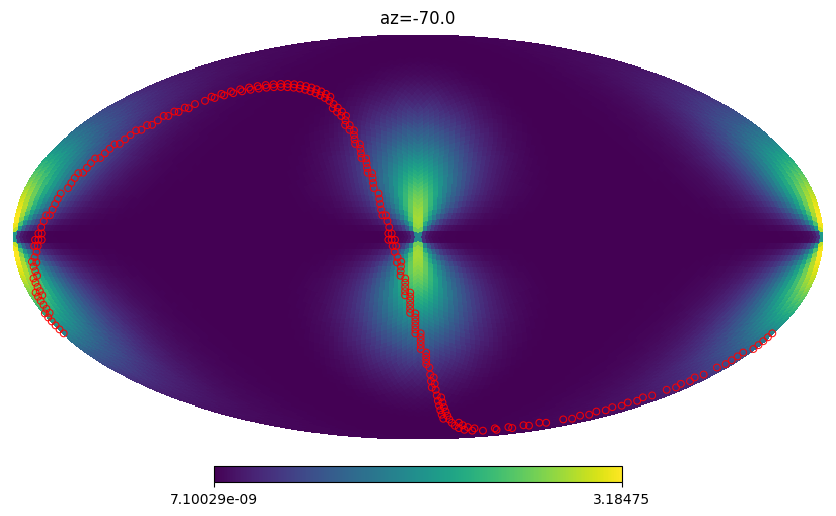

<Figure size 640x480 with 0 Axes>

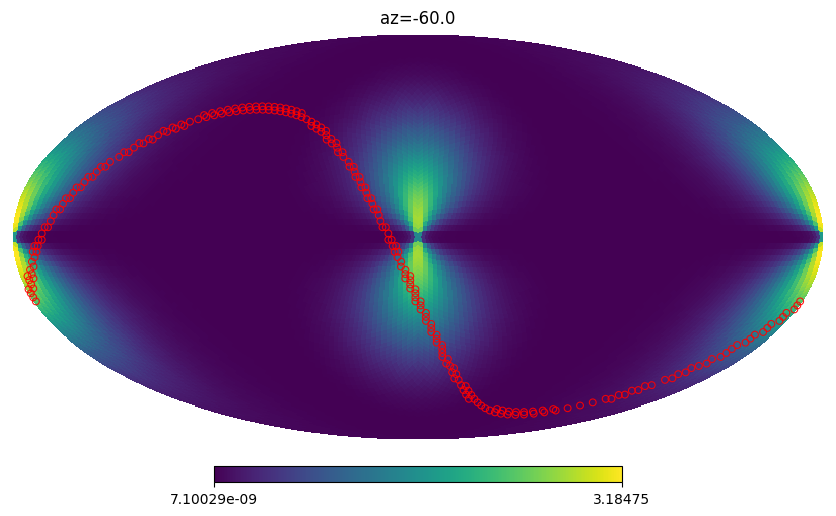

<Figure size 640x480 with 0 Axes>

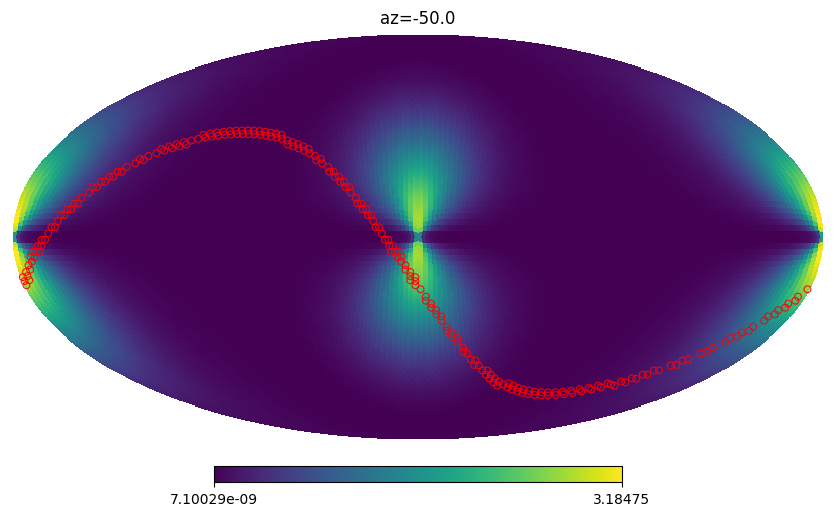

<Figure size 640x480 with 0 Axes>

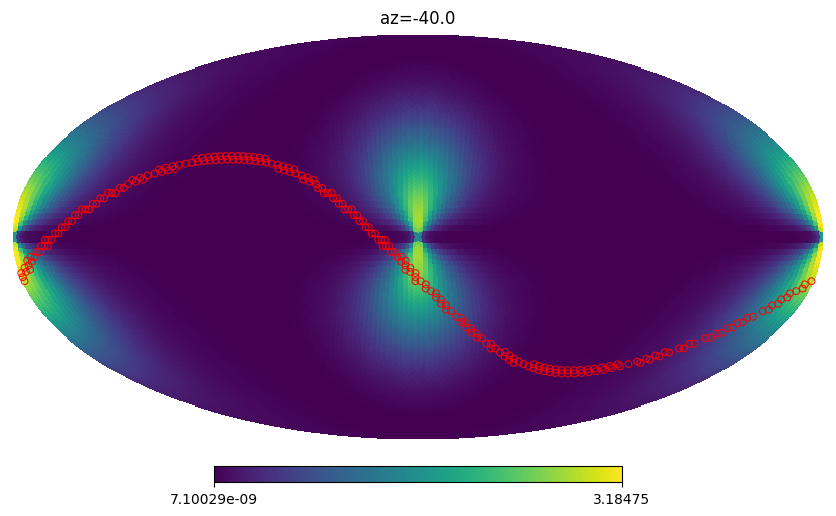

<Figure size 640x480 with 0 Axes>

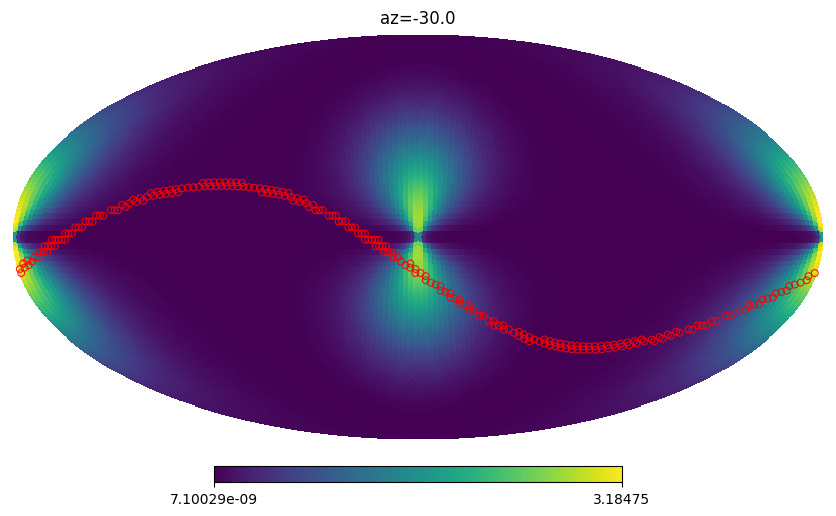

<Figure size 640x480 with 0 Axes>

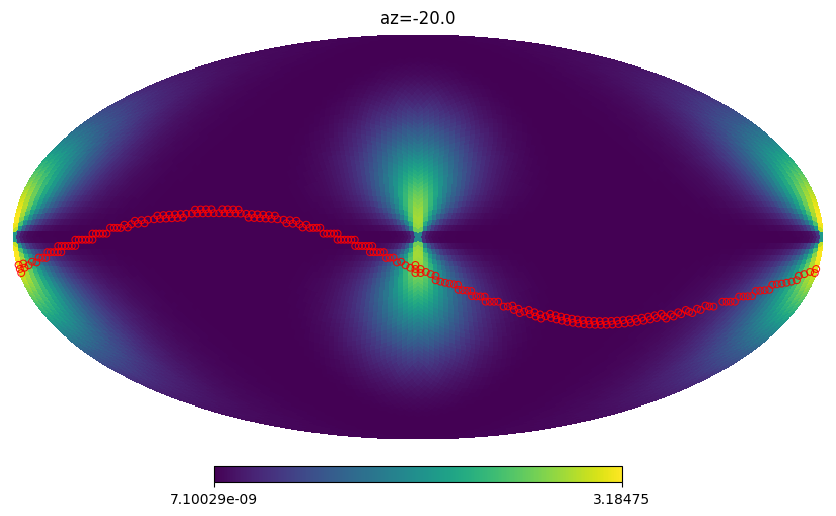

<Figure size 640x480 with 0 Axes>

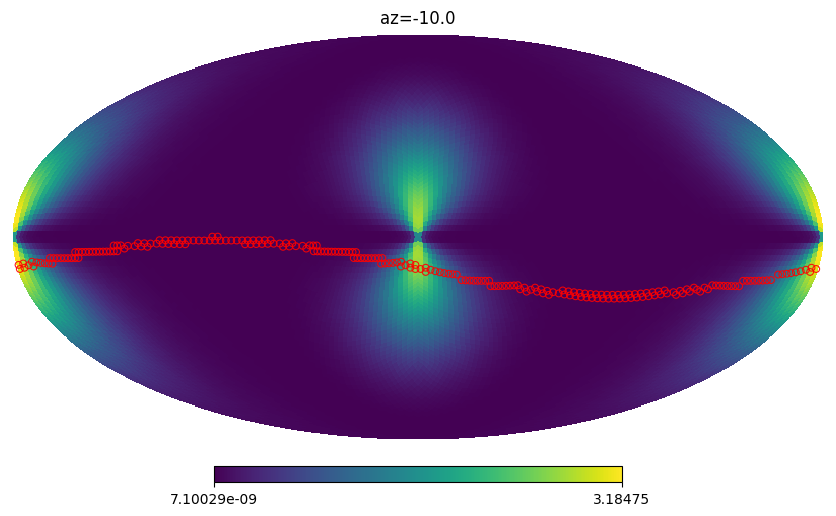

<Figure size 640x480 with 0 Axes>

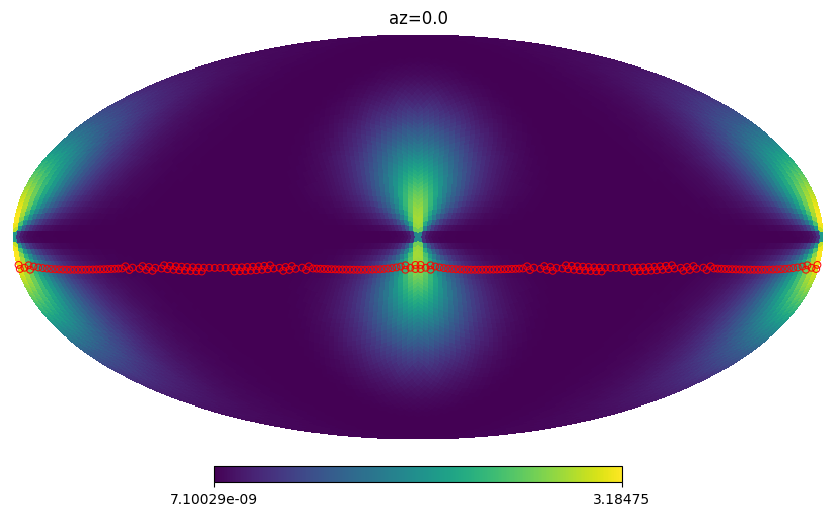

<Figure size 640x480 with 0 Axes>

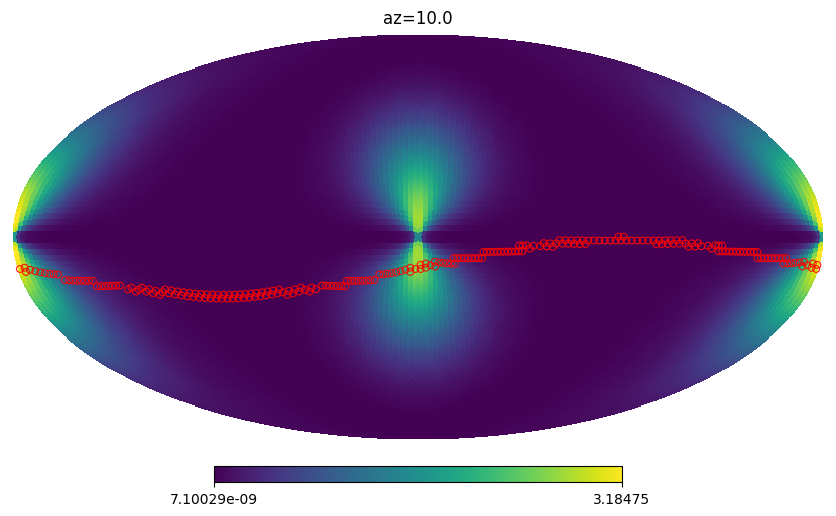

<Figure size 640x480 with 0 Axes>

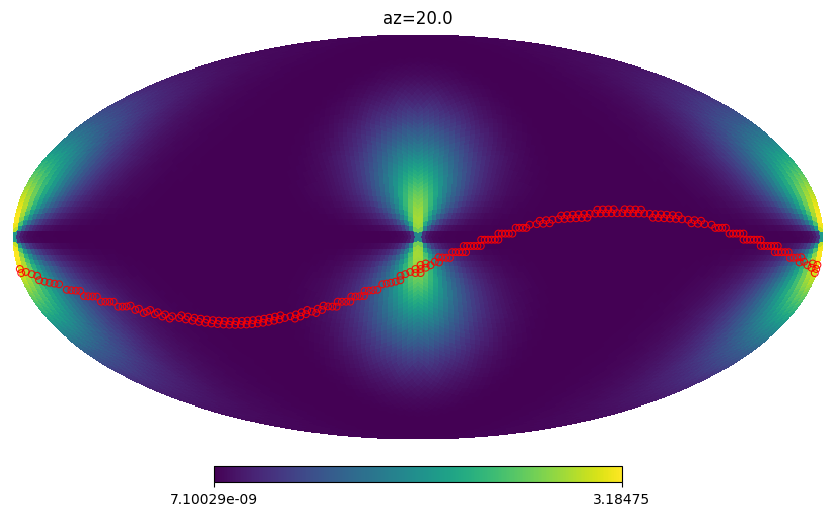

<Figure size 640x480 with 0 Axes>

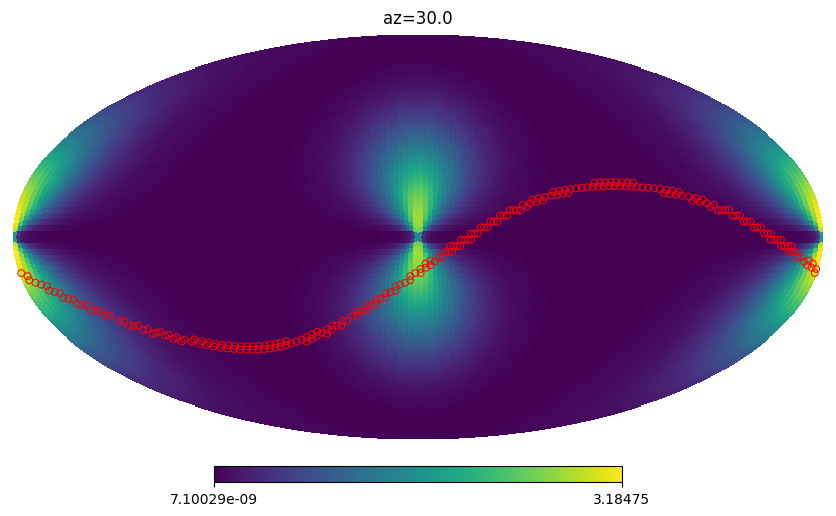

<Figure size 640x480 with 0 Axes>

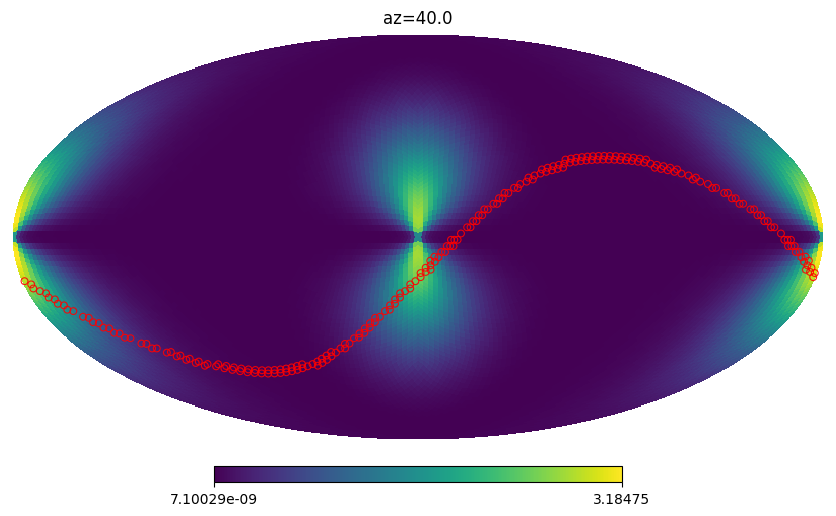

<Figure size 640x480 with 0 Axes>

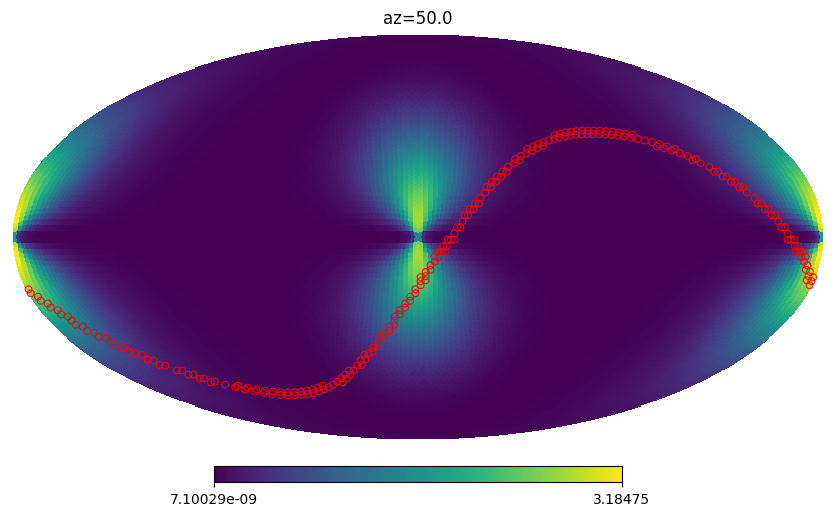

<Figure size 640x480 with 0 Axes>

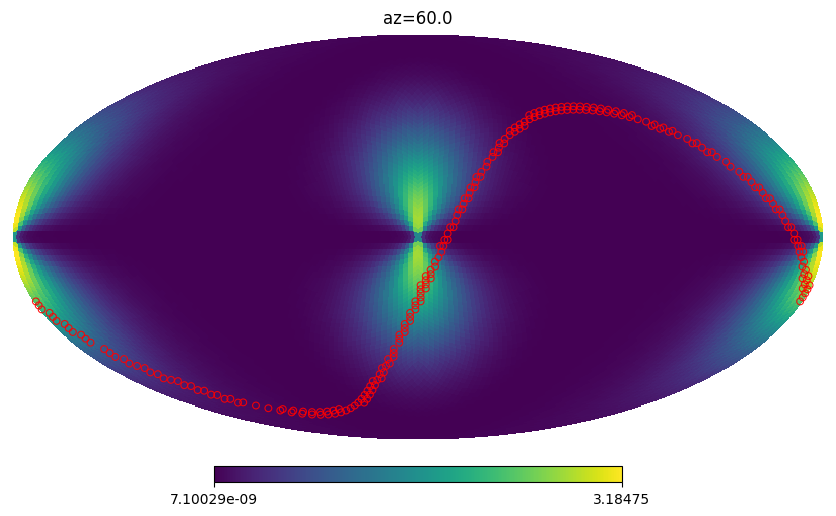

<Figure size 640x480 with 0 Axes>

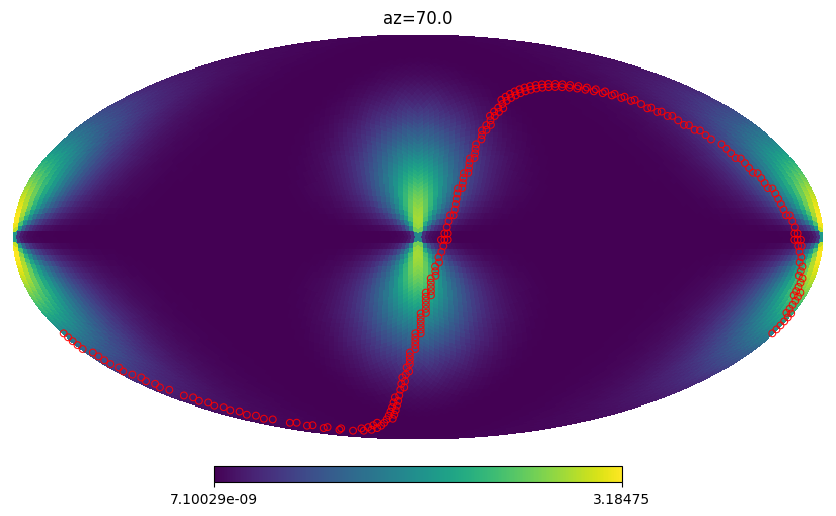

<Figure size 640x480 with 0 Axes>

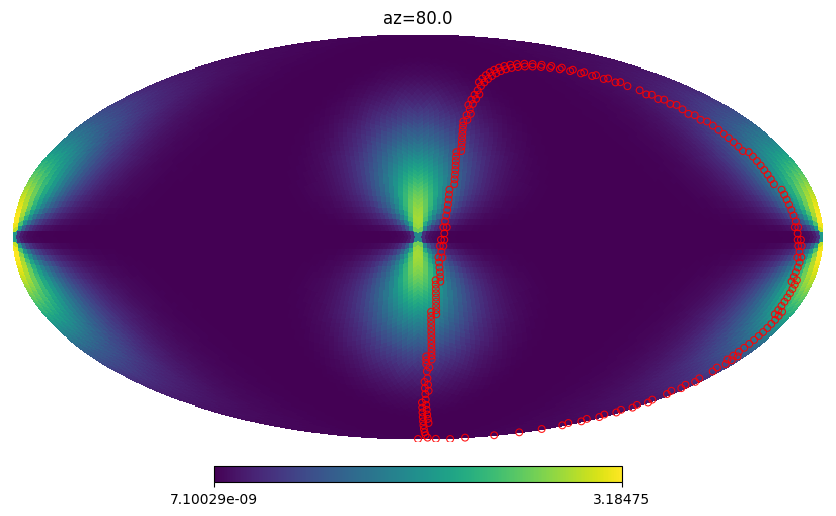

<Figure size 640x480 with 0 Axes>

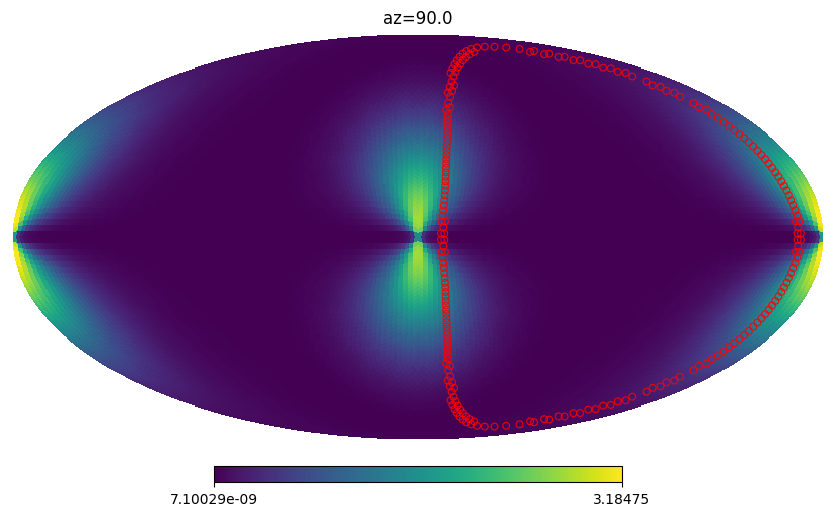

<Figure size 640x480 with 0 Axes>

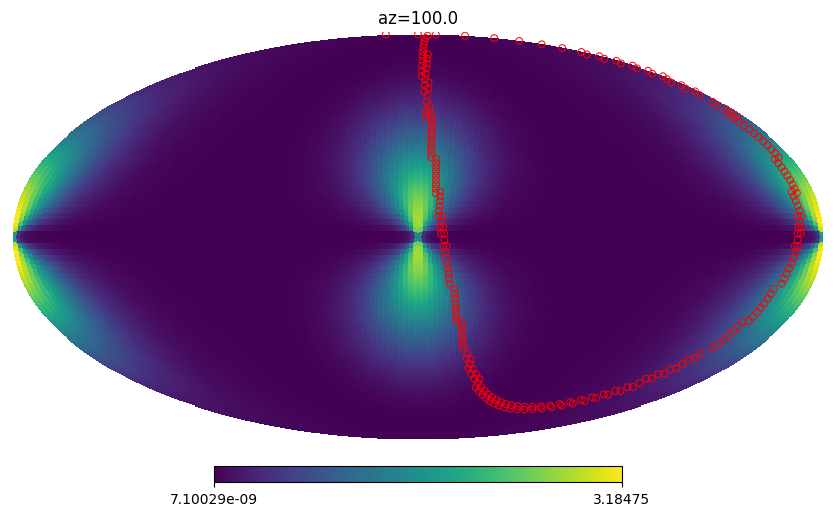

<Figure size 640x480 with 0 Axes>

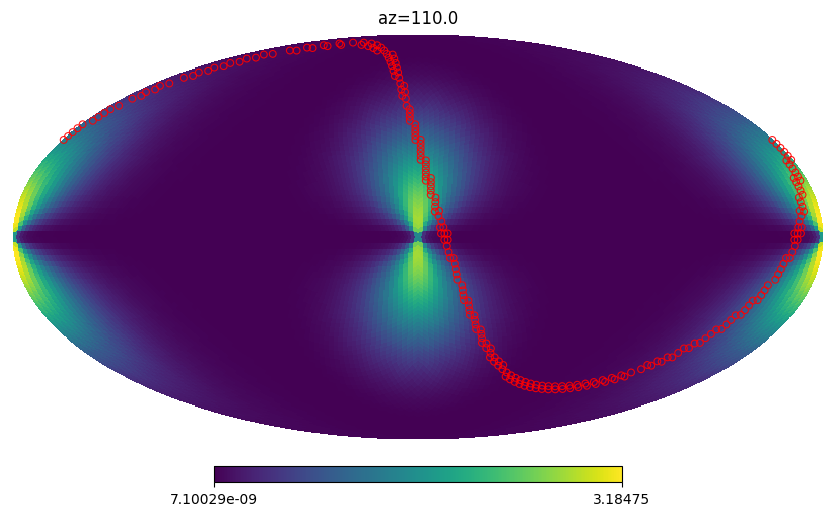

<Figure size 640x480 with 0 Axes>

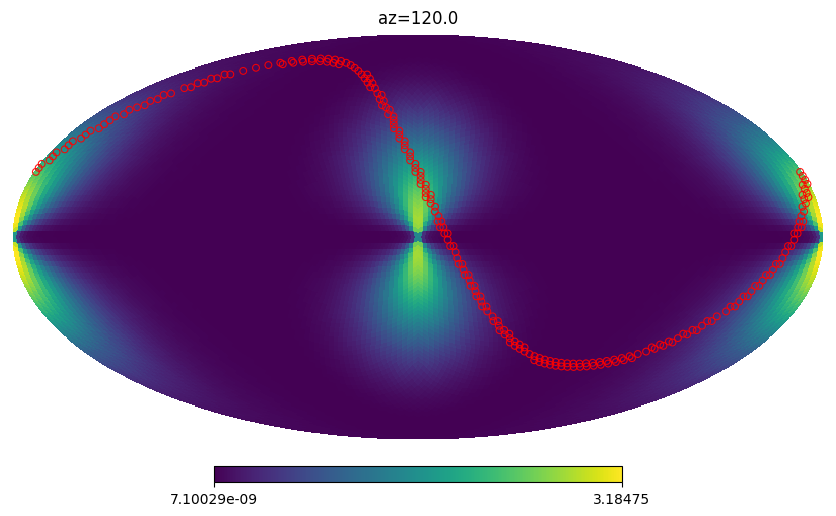

<Figure size 640x480 with 0 Axes>

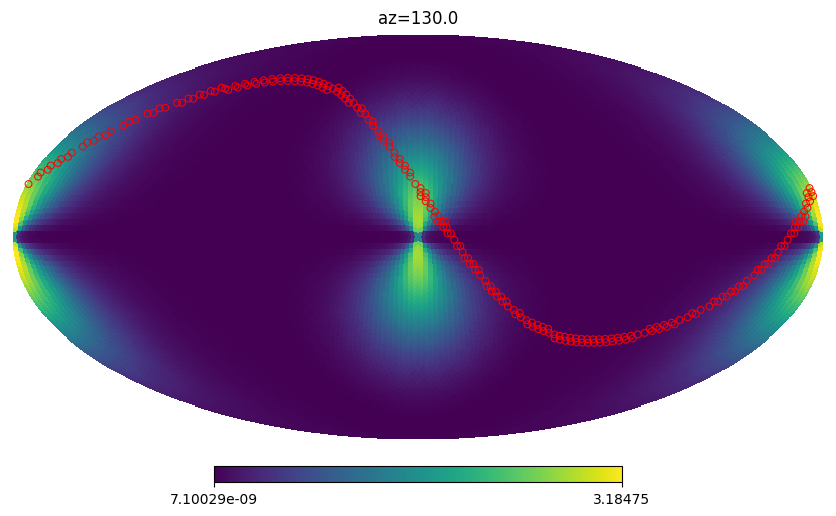

<Figure size 640x480 with 0 Axes>

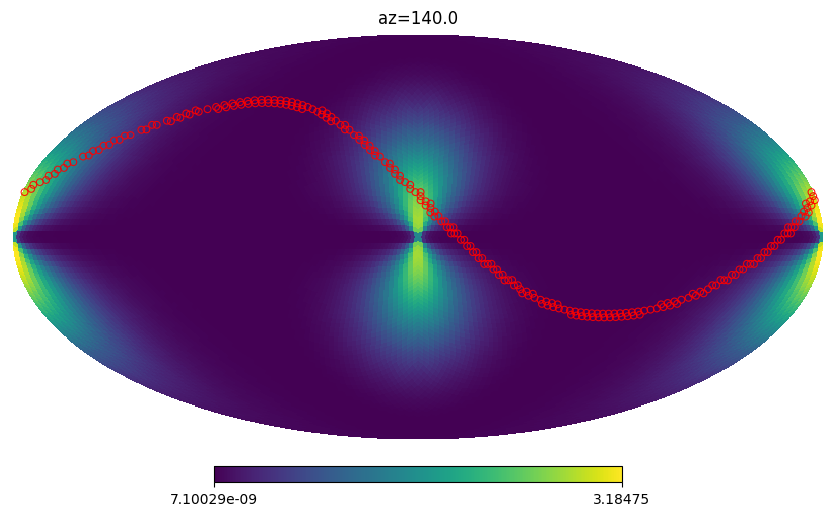

<Figure size 640x480 with 0 Axes>

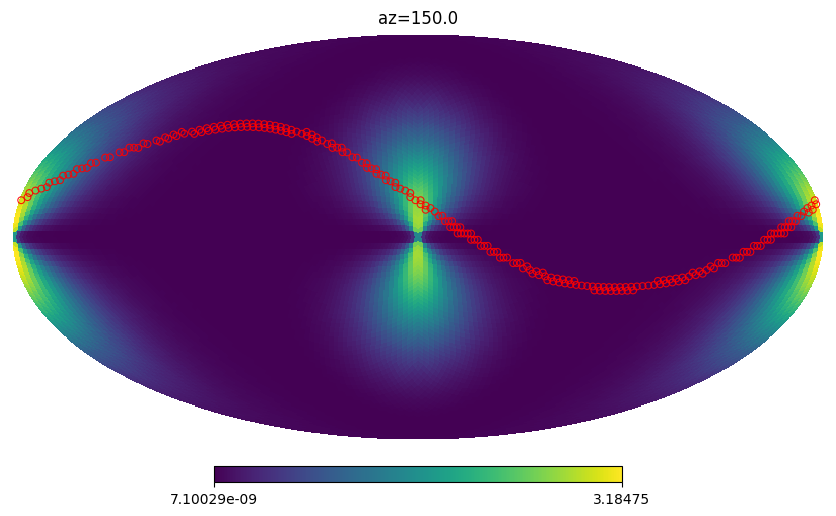

<Figure size 640x480 with 0 Axes>

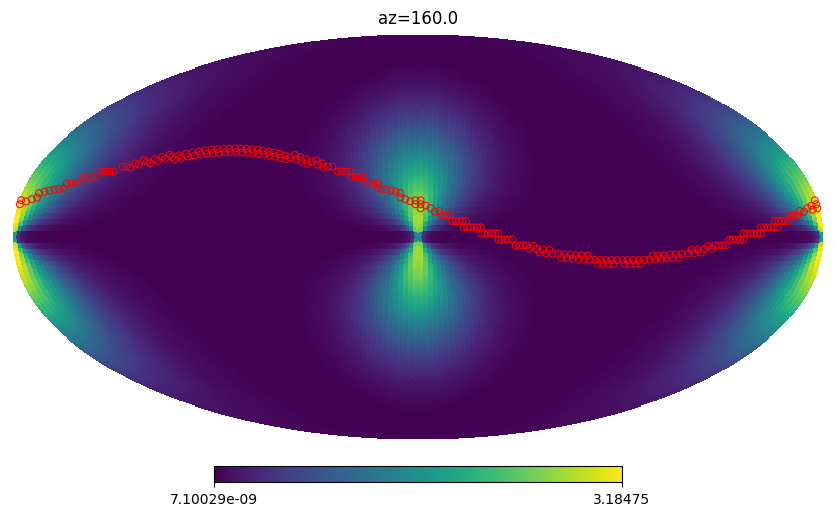

<Figure size 640x480 with 0 Axes>

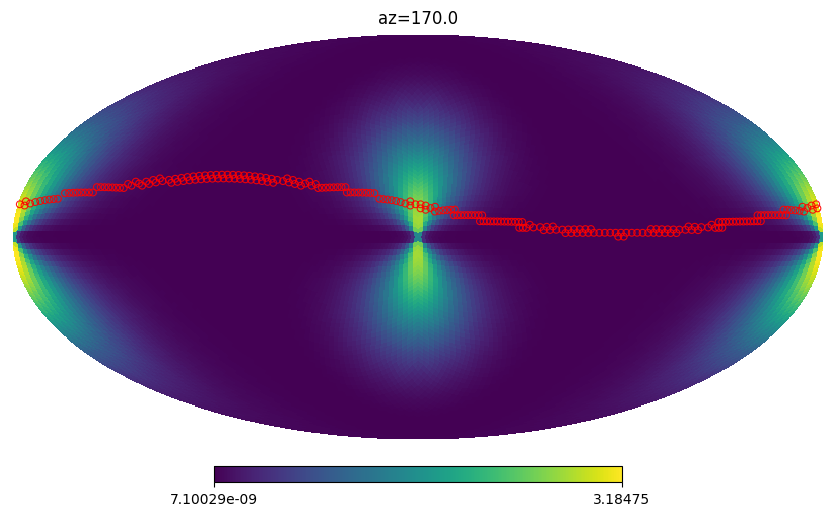

<Figure size 640x480 with 0 Axes>

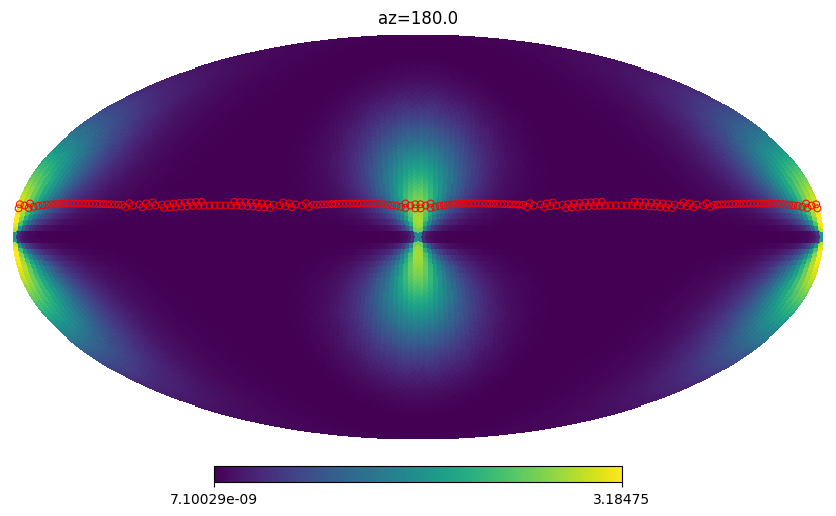

In [443]:
angles = np.linspace(-90, 180, 28, endpoint=True)
for i in angles:
    tracer(m_th, jnp.array([0.2,0,-1]), test_el, (test_az*i) + az_corre, rot=(0, 90, 0), az_title=i, save=True)

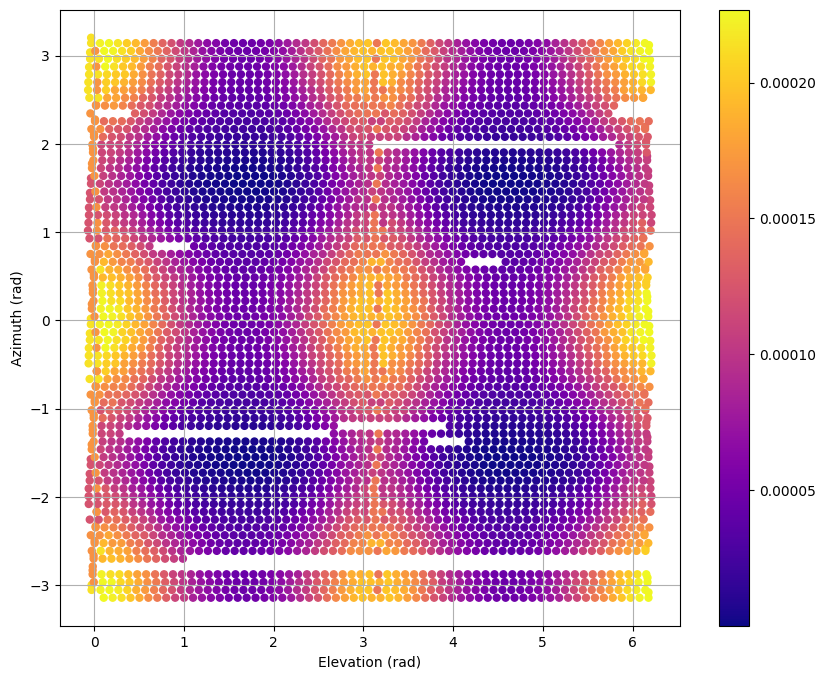

In [490]:


# ---- Single-sample power with RX height + phase-center offset ----
def power_with_rx_offset(
    rx, tx,
    az, el,                             # radians (scalar)
    tx_pos_world,                       # jnp.array([x,y,z]) meters
    pivot_world,                        # jnp.array([x,y,z]) meters (e.g., [0,0,97.0])
    r_pc_body,                          # jnp.array([dx,dy,dz]) meters in RX body frame (e.g., [0.5,0,0])
    ref_dist=1.0,                       # meters; power scaled by (ref_dist/d)^2
    include_range=True,
):
    # Rotation as you already defined
    R = rx.rotation(az, el)

    # RX phase-center position in world coords
    x_rx = pivot_world + (R @ r_pc_body)

    # Vector to TX, distance & unit direction (world)
    v_tx = tx_pos_world - x_rx
    d    = jnp.linalg.norm(v_tx)
    u_w  = v_tx / d

    # Express look direction in the RX body frame for θ,φ & local basis
    u_b = R.T @ u_w
    th, ph = xyz2thphi(u_b)

    # Healpix pixel using your θ-flip convention
    px = rx.ang2pix(th, ph)

    # Local spherical basis (body frame)
    th_hat  = rx.th_hat(th, ph)
    phi_hat = rx.phi_hat(th, ph)

    # TX polarization vector expressed in the same body frame (your code)
    E_tx_rot = tx.E_rotated(R)

    # Projections & beam gains (unchanged physics)
    E_th  = jnp.dot(E_tx_rot, th_hat)
    E_phi = jnp.dot(E_tx_rot, phi_hat)
    P_beam = rx.pwr_beam_th[px] * (E_th**2) + rx.pwr_beam_phi[px] * (E_phi**2)

    # Geometric spreading (optional)
    if include_range:
        P_beam = P_beam * (ref_dist**2) / (d**2)

    return P_beam

# ---- Vectorized wrapper over arrays of az/el (radians) ----
def simulate_powers_rx_offset(
    rx, tx, az, el,
    tx_pos_world, pivot_world, r_pc_body,
    ref_dist=1.0, include_range=True
):
    f = jax.vmap(lambda a, e: power_with_rx_offset(
        rx, tx, a, e,
        tx_pos_world=tx_pos_world,
        pivot_world=pivot_world,
        r_pc_body=r_pc_body,
        ref_dist=ref_dist,
        include_range=include_range
    ))
    return f(az, el)
# Radians in (your az_inds/el_inds are already radians)
az = az_inds
el = el_inds

# Geometry (meters)
pivot_world = jnp.array([0.0, 0.0, 0.0])   # RX pivot height ~97 m
r_pc_body   = jnp.array([0.0, 0.0, 0.5])    # 50 cm phase-center offset along RX +X (change as needed)
tx_pos_world= jnp.array([0.0, 0.0, -97])  # e.g., x_off=30.0, y_off=0.0, z_tx=0.5

# Run (keep your E1/E2 in tx_true as before)
P_range = simulate_powers_rx_offset(
    rx_true, tx_true, az, el,
    tx_pos_world=tx_pos_world,
    pivot_world=pivot_world,
    r_pc_body=r_pc_body,
    ref_dist=1.0,
    include_range=True
)

# Plot in your usual motor axes
plt.figure(figsize=(10,8))
plt.scatter(el, az, c=np.asarray(P_range), s=25, cmap='plasma')
plt.xlabel("Elevation (rad)"); plt.ylabel("Azimuth (rad)")
plt.colorbar()
plt.grid()


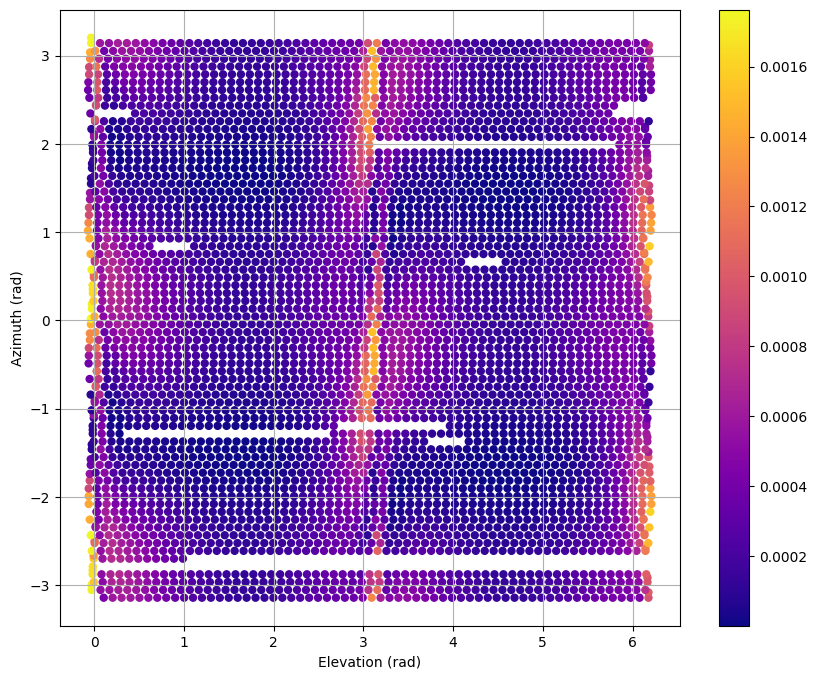

In [456]:
import jax
import jax.numpy as jnp

# Choose dtype once (complex for coherent sums)
cdtype = jnp.complex64

def power_two_ray(
    rx: RotatingAntenna,
    tx: TransmitterAntenna,
    az, el,                           # radians (can be arrays; we'll vmap)
    tx_pos_world,                     # jnp.array([x, y, z]) in meters (z≈0–1)
    pivot_world,                      # jnp.array([0,0,h_rx]) e.g. [0,0,97.]
    r_pc_body,                        # RX phase-center offset in *antenna/body* coords, e.g. [0.5,0,0]
    freq_hz=136.71875e6,             # Hz
    gamma_reflect=-0.7+0j,           # scalar Fresnel approx; tune later
    ground_z=0.0                      # plane z=0
):
    c0 = 299792458.0
    k  = 2*jnp.pi*freq_hz/c0

    # rotation & RX phase-center (world coords)
    R = rx.rotation(az, el)                      # same R you already use
    x_rx = pivot_world + (R @ r_pc_body)         # move phase center as the mount rotates

    # direct path
    v1 = tx_pos_world - x_rx
    d1 = jnp.linalg.norm(v1)
    u1 = v1 / d1

    # image (reflect TX across ground plane z=ground_z)
    tx_img = jnp.array([tx_pos_world[0], tx_pos_world[1], 2*ground_z - tx_pos_world[2]])
    v2 = tx_img - x_rx
    d2 = jnp.linalg.norm(v2)
    u2 = v2 / d2

    # directions expressed in the antenna/body frame for your existing th/phi basis
    u1_body = R.T @ u1
    u2_body = R.T @ u2

    th1, ph1 = xyz2thphi(u1_body)
    th2, ph2 = xyz2thphi(u2_body)

    # beam pixel/gains (uses your θ-flip switch inside ang2pix)
    px1 = rx.ang2pix(th1, ph1)
    px2 = rx.ang2pix(th2, ph2)
    g1_th  = rx.pwr_beam_th[px1]
    g1_phi = rx.pwr_beam_phi[px1]
    g2_th  = rx.pwr_beam_th[px2]
    g2_phi = rx.pwr_beam_phi[px2]

    # local bases for each path (body frame, consistent with your code)
    thh1  = rx.th_hat(th1, ph1);  phih1 = rx.phi_hat(th1, ph1)
    thh2  = rx.th_hat(th2, ph2);  phih2 = rx.phi_hat(th2, ph2)

    # TX polarization vector in the same (body) frame you already use
    E0_body = tx.E_rotated(R)

    # Optional: short-dipole radiation factor (axis = tx.ax1_top in "top"/world)
    # amplitude ∝ sin(angle(dipole_axis, observation_dir_world))
    u_dip = tx.ax1_top / jnp.linalg.norm(tx.ax1_top)
    A1 = jnp.sqrt(1.0 - (jnp.dot(u_dip, u1))**2)
    A2 = jnp.sqrt(1.0 - (jnp.dot(u_dip, u2))**2)

    # Projections onto local tangential basis
    e1_th  = jnp.dot(E0_body, thh1)
    e1_phi = jnp.dot(E0_body, phih1)
    e2_th  = jnp.dot(E0_body, thh2)
    e2_phi = jnp.dot(E0_body, phih2)

    # Complex field amplitudes with 1/R and phase
    a1 = (A1 / d1) * jnp.exp(-1j * k * d1)
    a2 = gamma_reflect * (A2 / d2) * jnp.exp(-1j * k * d2)

    # Coherent sum *per polarization*, beam gains enter as amplitude sqrt
    E_th  = jnp.sqrt(g1_th)  * e1_th  * a1 + jnp.sqrt(g2_th)  * e2_th  * a2
    E_phi = jnp.sqrt(g1_phi) * e1_phi * a1 + jnp.sqrt(g2_phi) * e2_phi * a2

    P = (jnp.abs(E_th)**2 + jnp.abs(E_phi)**2).astype(jnp.float32)
    return P

# Vectorized wrapper (use exactly like your simulate_powers_vmap)
v_power_two_ray = jax.vmap(
    lambda az, el: power_two_ray(
        rx_true, tx_true, az, el,
        tx_pos_world= jnp.array([x_off, y_off, z_tx]),     # fill below
        pivot_world = jnp.array([0.0, 0.0, 97.0]),
        r_pc_body   = jnp.array([0.5, 0.0, 0.0])           # 50 cm along your +X body axis
    ),
    in_axes=(0,0),
)

# Fill geometry (meters)
x_off, y_off = 10.0, 0.0        # <-- put your actual lateral offset(s)
z_tx = 0.5                      # TX height above ground (≈ 0–1 m)

# Run
P_two_ray = v_power_two_ray(az_inds, el_inds)

# Plot in your usual motor axes:
plt.figure(figsize=(10, 8))
plt.scatter(el_inds, az_inds, c=np.asarray(P_two_ray), s=25, cmap='plasma')
plt.xlabel("Elevation (rad)"); plt.ylabel("Azimuth (rad)")
plt.colorbar()
plt.grid()


In [25]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt

def overlay_pixels_hit_twice(base_map, hit_pxs, nest=False,
                             marker_size=36, edgecolor="red", title=None):
    """
    Draw base_map with rings around pixels that were hit exactly twice.
    - base_map: 1D HEALPix array (len = 12 * nside**2)
    - hit_pxs : 1D array of pixel IDs (same ordering as `nest`)
    - nest    : True if NESTED ordering, else False for RING
    """
    base_map = np.asarray(base_map)
    pix = np.asarray(hit_pxs, dtype=np.int64)

    nside = hp.npix2nside(base_map.size)
    npix  = hp.nside2npix(nside)

    # counts per pixel, then select exactly-two-hit pixels
    counts = np.bincount(pix, minlength=npix)
    twice_pix = np.flatnonzero(counts == 2)

    # plot base map (no value changes)
    if title is None:
        title = f"Pixels hit exactly twice (N={twice_pix.size})"
    hp.mollview(base_map, nest=nest, title=title)

    # scatter those pixels on top
    theta, phi = hp.pix2ang(nside, twice_pix, nest=nest)   # radians
    lon = np.degrees(phi)
    lat = 90.0 - np.degrees(theta)
    hp.projscatter(lon, lat, lonlat=True,
                   s=marker_size, marker="o",
                   facecolors="none", edgecolors=edgecolor,
                   linewidths=1.2, alpha=0.95, zorder=10)
    plt.show()

    return twice_pix  # handy if you want the ids back
def first_second_hits_for_twice_pixels(hit_pxs, nside, nest=False):
    pix = np.asarray(hit_pxs, dtype=np.int64)
    npix = hp.nside2npix(nside)

    counts = np.bincount(pix, minlength=npix)
    mask2  = counts == 2
    pixels2 = np.flatnonzero(mask2)

    BIG = np.iinfo(np.int64).max
    first = np.full(npix, BIG, dtype=np.int64)
    last  = np.full(npix, -1,  dtype=np.int64)

    t = np.arange(pix.size, dtype=np.int64)
    np.minimum.at(first, pix, t)
    np.maximum.at(last,  pix, t)

    i_first  = first[mask2]
    i_second = last[mask2]
    return pixels2, i_first, i_second


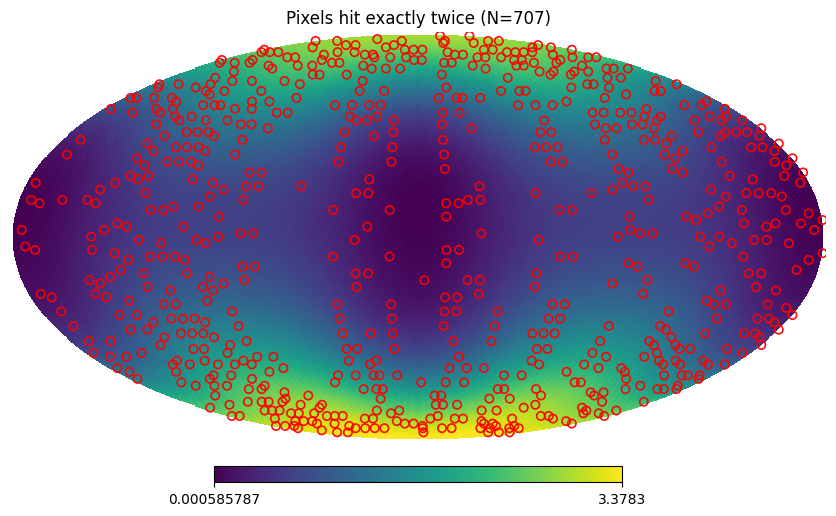

In [28]:
# draw overlay
twice_pix = overlay_pixels_hit_twice(hit_map, hit_pxs, nest=nest)

# (optional) recover time indices for those pixels
pixels2, i_first, i_second = first_second_hits_for_twice_pixels(hit_pxs, nside=hp.npix2nside(hit_map.size), nest=nest)

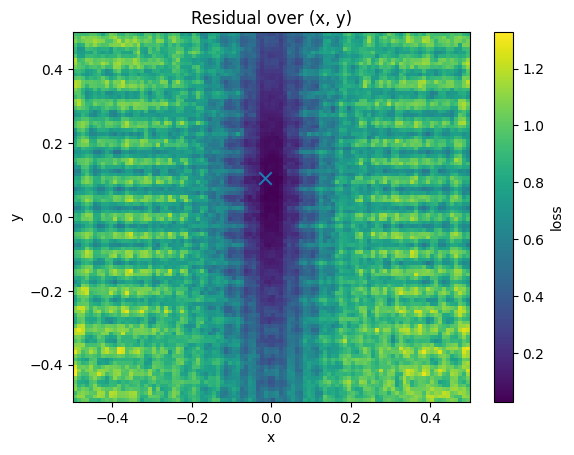

In [20]:
fig, ax = plt.subplots()

im = ax.imshow(
    res_grid,                  # (Y, X)
    origin="lower",
    extent=[float(xs.min()), float(xs.max()), float(ys.min()), float(ys.max())],
    aspect="auto",
)

ax.scatter([best_x], [best_y], marker="x", s=80)
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title("Residual over (x, y)")
cbar = fig.colorbar(im, ax=ax)
cbar.set_label("loss")

plt.show()


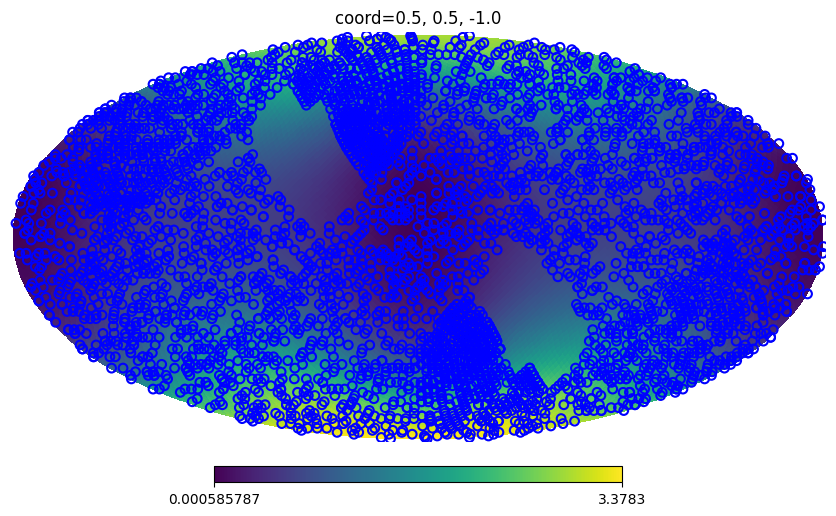

In [35]:
m_hit = m_phi + m_th
N = len(hit_pxs)
order = np.lexsort((np.arange(N), hit_pxs))   # primary sort by hit_pxs, tie-break by time index
hit_pxs_s  = hit_pxs[order]

value, counts = np.unique(hit_pxs_s, return_counts=True)
starts = np.cumsum(np.r_[0, counts[:-1]])
mask2  = (counts == 2)

i_first  = order[starts[mask2]]          # earlier hit
i_second = order[starts[mask2] + 1]      # later hit
pixels2  = value[mask2]

healpy.mollview(m_hit, cbar=True, title=f'coord={coord[0]}, {coord[1]}, {coord[2]}')

# lon, lat = healpy.pix2ang(DEFAULT_NSIDE, hit_pxs, nest=True, lonlat=False)
# healpy.projscatter(
#     lon, lat, lonlat=False,
#     s=40, marker='o',
#     facecolors='none', edgecolors='crimson', linewidths=1.5,
#     zorder=10
# )
lon, lat = healpy.pix2ang(DEFAULT_NSIDE, hit_pxs, nest=True, lonlat=False)
healpy.projscatter(
    lon, lat, lonlat=False,
    s=40, marker='o',
    facecolors='none', edgecolors='blue', linewidths=1.5,
    zorder=10
)

plt.show()

In [214]:
xs = jnp.linspace(0, 2, 5)
ys = xs.copy()
res_list = []
res_x = []
res_y = []
for i in xs:
    for j in ys:
        txe1 = 0.9#.3 # .4
        txe2 = 0.1#.7 # .6 looks close actually, when plotted over time
        rx_true = RotatingAntenna(beam_th=m_th, beam_phi=m_phi)
        # tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([-1, -.1, -1]))
        coord = jnp.array([i,j,-1])
        # tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=jnp.array([0, 0, -1]))
        tx_true = TransmitterAntenna(E1=txe1, E2=txe2, heading_top=coord)
        sim_p, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=jnp.deg2rad(fitter.az_deg[fitter.inds]), el=jnp.deg2rad(fitter.el_deg[fitter.inds]), E1=txe1, E2=txe2)
        # sim_p = simulate_powers_vmap_incoherent_xy(rx=rx_true, tx=tx_true, az=np.deg2rad(fitter.az_deg[fitter.inds]), el=np.deg2rad(fitter.el_deg[fitter.inds]), alpha_x=.5, alpha_y=.5)
        # sim_norm = 1 / np.mean(sim_p, axis=0)
        N = len(hit_pxs)
        order = jnp.lexsort((np.arange(N), hit_pxs))   # primary sort by hit_pxs, tie-break by time index
        hit_pxs_s  = hit_pxs[order]
        
        value, counts = jnp.unique(hit_pxs_s, return_counts=True)
        starts = jnp.cumsum(np.r_[0, counts[:-1]])
        mask2  = (counts == 2)
        
        i_first  = order[starts[mask2]]          # earlier hit
        i_second = order[starts[mask2] + 1]      # later hit
        pixels2  = value[mask2]
        
        # sim_p_pairs = np.stack([sim_p[i_first], sim_p[i_second]], axis=1)
        # sim_p_pairs = np.stack([sim_p[i_first], sim_p[i_second]], axis=1)
        rot_pairs = jnp.stack([rot[i_first], rot[i_second]], axis=1)
        res = np.mean((rot_pairs[:, 1] - rot_pairs[:, 0])**2)
        print(f'coord={i}, {j}: {res}')
        res_list.append(res)
        res_x.append(xs)
        res_y.append(ys)

res_arr = jnp.array(res_list)

coord=0.0, 0.0: 0.03624880296365227
coord=0.0, 0.5: 0.42388036971910226
coord=0.0, 1.0: 0.620498566653635
coord=0.0, 1.5: 0.48232878654412387
coord=0.0, 2.0: 0.20091960570625111
coord=0.5, 0.0: 0.5988306845994426
coord=0.5, 0.5: 0.9593169425639817
coord=0.5, 1.0: 0.9931188431915331
coord=0.5, 1.5: 0.7235908003130092
coord=0.5, 2.0: 0.645783096063563
coord=1.0, 0.0: 0.5503515736958855
coord=1.0, 0.5: 0.8118306929339112
coord=1.0, 1.0: 1.0686009500118072
coord=1.0, 1.5: 0.8745637100081949
coord=1.0, 2.0: 0.6202434219744483
coord=1.5, 0.0: 0.2655429559338314
coord=1.5, 0.5: 0.7666929225164972
coord=1.5, 1.0: 0.8893890450192525
coord=1.5, 1.5: 1.0312045946612776
coord=1.5, 2.0: 0.9304751378022589
coord=2.0, 0.0: 0.19929501778099767
coord=2.0, 0.5: 0.6628954407794375
coord=2.0, 1.0: 0.8958507750755279
coord=2.0, 1.5: 0.881611013740525


Traceback (most recent call last):
  File "/home/dominiv/venv/jupyter/lib/python3.12/site-packages/IPython/core/interactiveshell.py", line 3577, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_102338/1346573155.py", line 15, in <module>
    sim_p, hit_pxs = simulate_powers_vmap(rx=rx_true, tx=tx_true, az=np.deg2rad(fitter.az_deg[fitter.inds]), el=np.deg2rad(fitter.el_deg[fitter.inds]), E1=txe1, E2=txe2)
                     ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipykernel_102338/2306444299.py", line 59, in simulate_powers_vmap
    rs, th_txs, phi_txs, pxs = px_th_ph(rx, tx, az, el)  # pxs should already be int32
                               ^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipykernel_102338/2306444299.py", line 35, in px_th_ph
    r = rx.rotation(az[i], el[i])
        ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipykernel_10

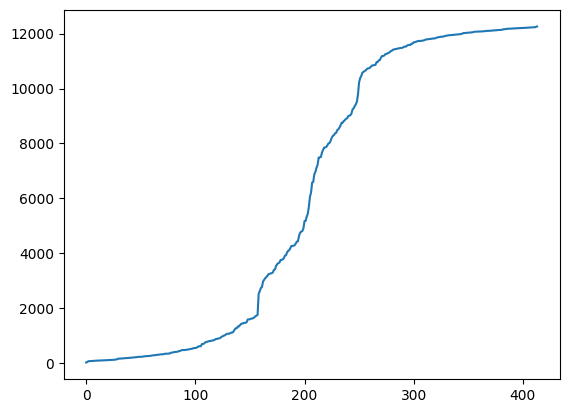

In [121]:
plt.figure()
plt.plot(hit_twice)
plt.show()

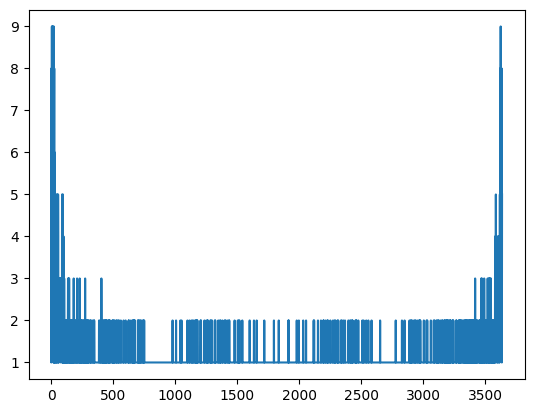

In [118]:
plt.figure()
plt.plot(test_px[1])
plt.show()

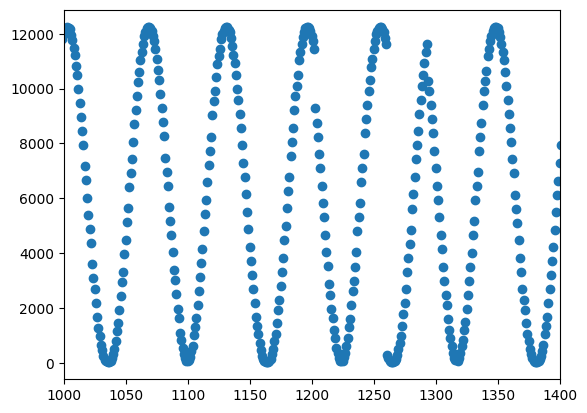

In [111]:
plt.figure()
plt.plot(hit_pxs, 'o')
plt.xlim(1000, 1400)
plt.show()